EOF Analysis using the 'eofs' package
Datasets: CHL (Chlorophyll), OSTIA (SST), SMAP (SSS)
Time period: May 2015 - May 2025 (121 monthly time steps)
Spatial grid: 127 × 179 = 22,733 points

STEP 1: Loading data...
Loading datasets...

dataset_1: C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4
Dimensions: {'StdTime': 121, 'lat': 127, 'lon': 179}
Variables: ['crs', 'chlor_a']
Selected variable: chlor_a
Shape: (121, 127, 179)
Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
Valid data points: 2,076,790 / 2,750,693 (75.5%)

dataset_2: C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4
Dimensions: {'StdTime': 121, 'lat': 127, 'lon': 179}
Variables: ['crs', 'analysed_sst']
Selected variable: analysed_sst
Shape: (121, 127, 179)
Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
Valid data points: 2,070,794 / 2,750,693 (75.3%)

dataset_3: C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4
Dimensions: {'StdTime': 121, 'lat': 12

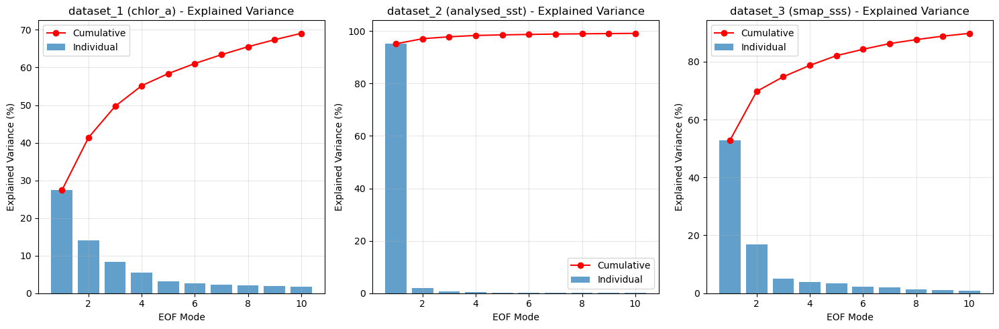

Plotting spatial patterns for dataset_1...


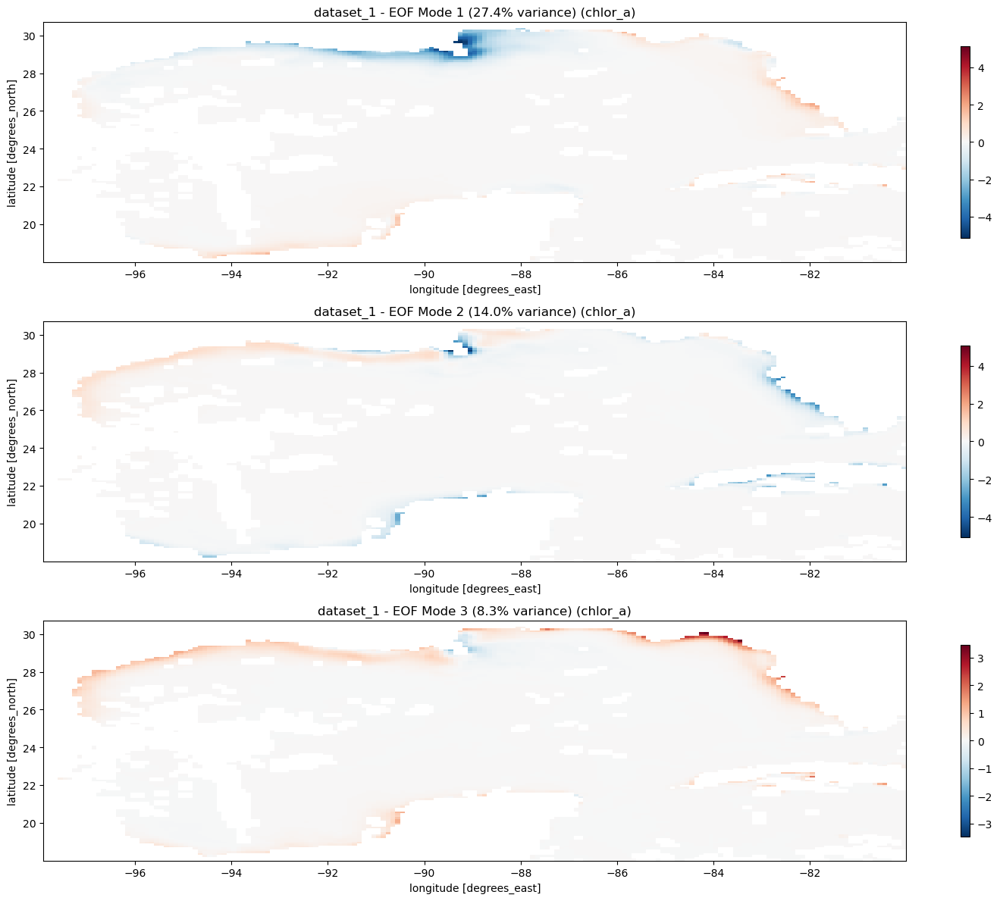

Plotting time series for dataset_1...


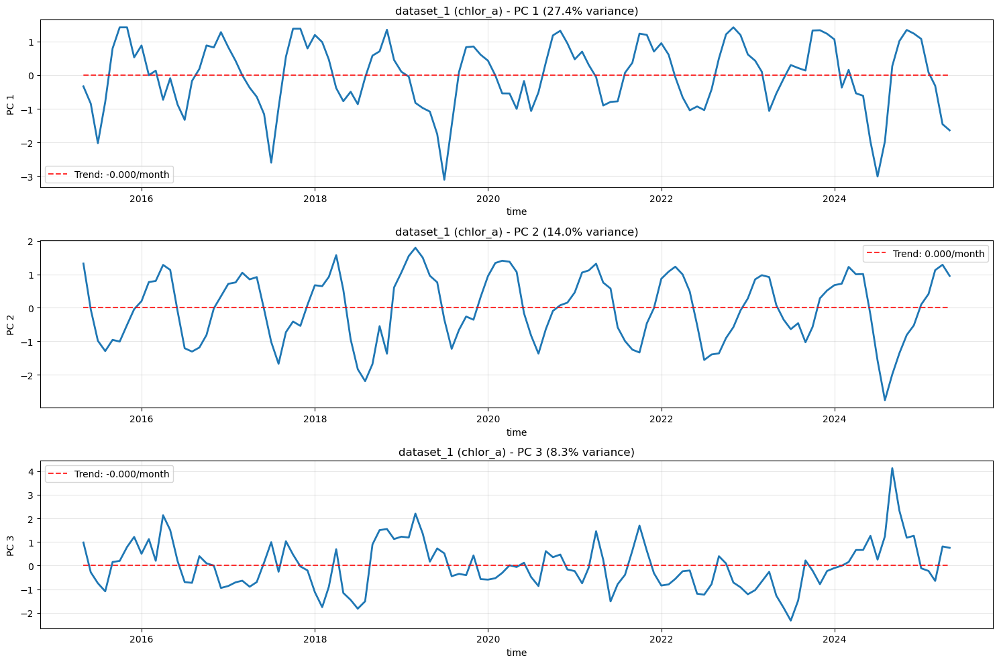

Plotting spatial patterns for dataset_2...


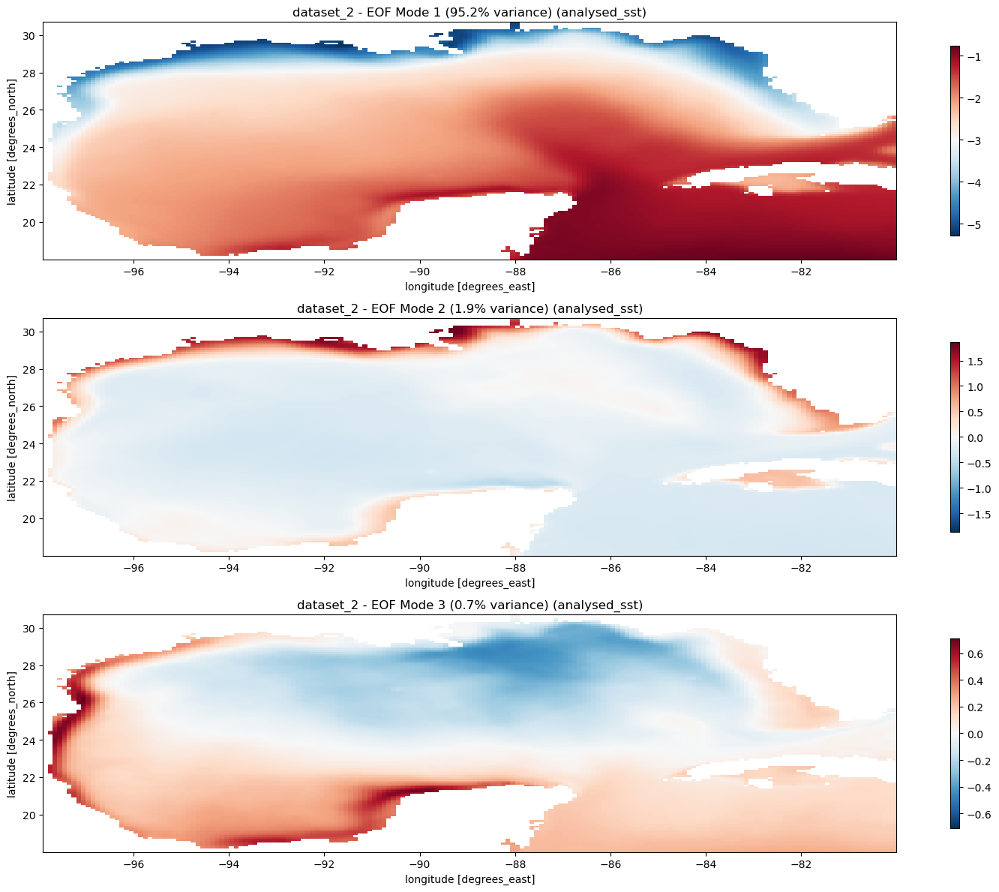

Plotting time series for dataset_2...


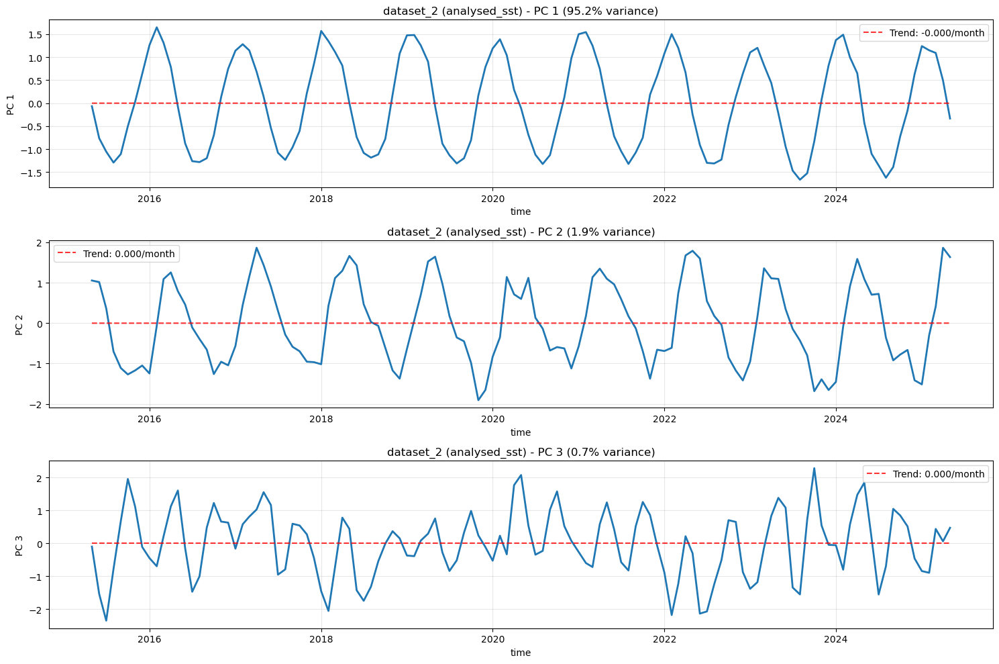

Plotting spatial patterns for dataset_3...


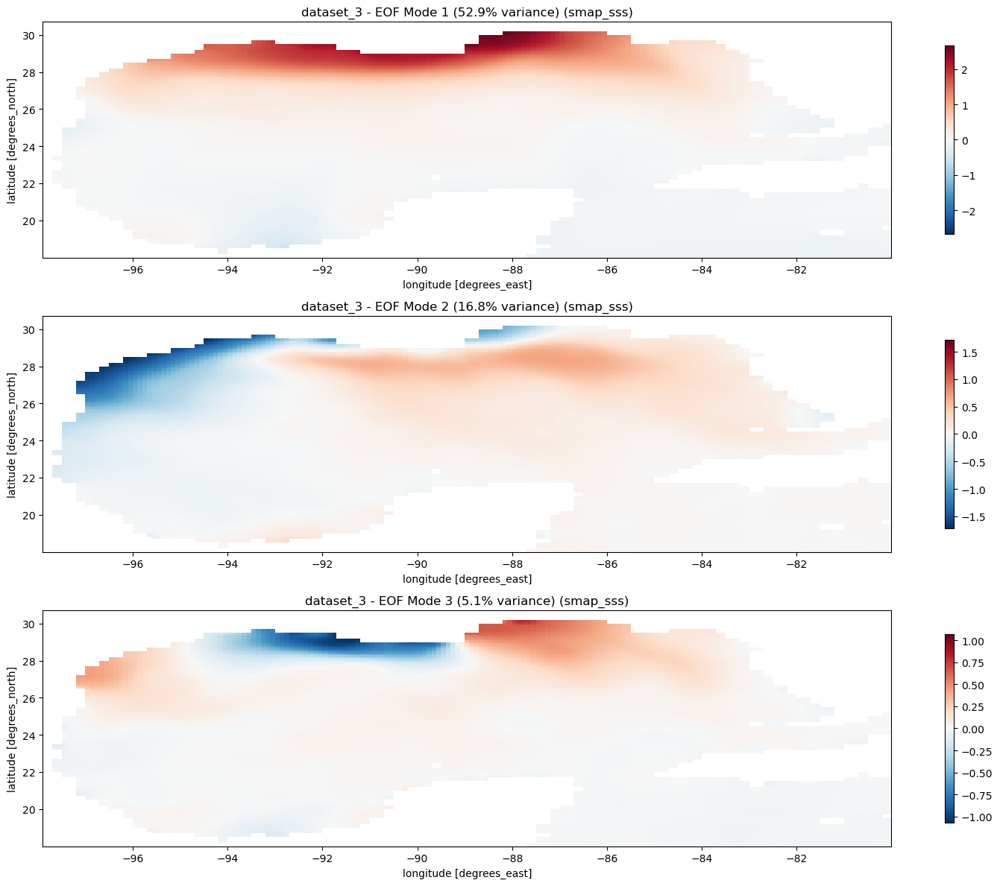

Plotting time series for dataset_3...


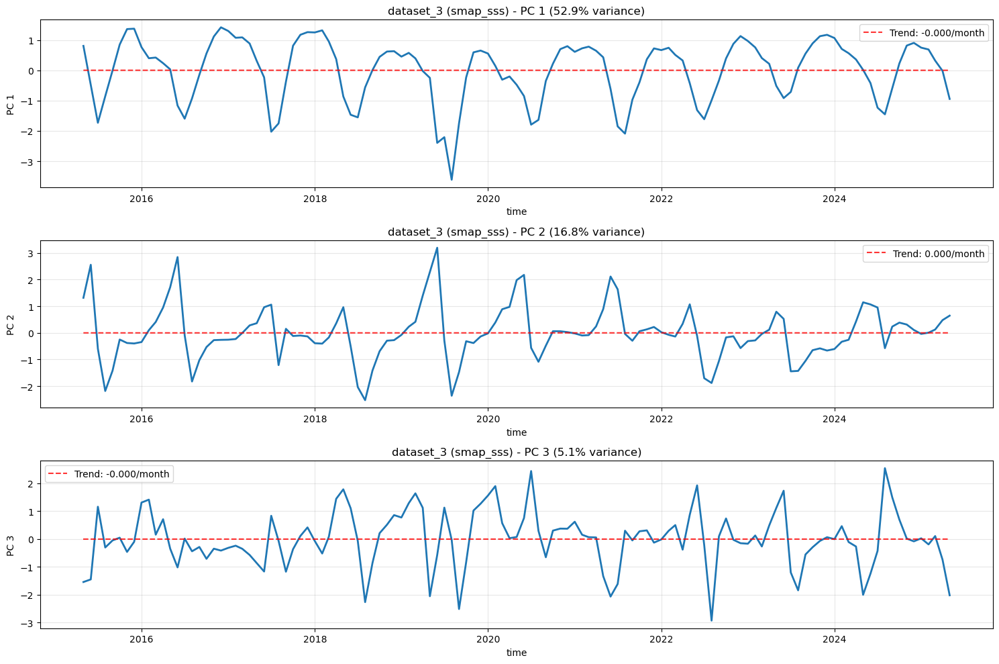


STEP 6: Cross-correlation analysis...

Correlation Analysis between Principal Components:

dataset_1 (chlor_a) vs dataset_2 (analysed_sst):
Mode correlations (first 5 modes):
  Mode 1: highest correlation with Mode 2 = -0.663
  Mode 2: highest correlation with Mode 1 = 0.783
  Mode 3: highest correlation with Mode 3 = 0.396
  Mode 4: highest correlation with Mode 2 = -0.355
  Mode 5: highest correlation with Mode 5 = -0.212

dataset_1 (chlor_a) vs dataset_3 (smap_sss):
Mode correlations (first 5 modes):
  Mode 1: highest correlation with Mode 1 = 0.707
  Mode 2: highest correlation with Mode 2 = 0.492
  Mode 3: highest correlation with Mode 2 = 0.278
  Mode 4: highest correlation with Mode 3 = 0.635
  Mode 5: highest correlation with Mode 3 = -0.317

dataset_2 (analysed_sst) vs dataset_3 (smap_sss):
Mode correlations (first 5 modes):
  Mode 1: highest correlation with Mode 1 = 0.710
  Mode 2: highest correlation with Mode 5 = -0.476
  Mode 3: highest correlation with Mode 2 = 0.316
  

In [4]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from eofs.xarray import Eof
from eofs.tools.standard import correlation_map, covariance_map
import warnings
warnings.filterwarnings('ignore')

class GeospatialEOFAnalysis:
    """
    Comprehensive EOF analysis for geospatial time series data using the eofs package
    Optimized for climate/oceanographic datasets
    """
    
    def __init__(self, filepaths, variable_names=None):
        """
        Initialize with file paths and optional variable names
        
        Parameters:
        -----------
        filepaths : list
            List of netCDF file paths
        variable_names : list, optional
            List of variable names to extract from each file
        """
        self.filepaths = filepaths
        self.variable_names = variable_names or []
        self.datasets = {}
        self.data_arrays = {}
        self.eof_solvers = {}
        self.eof_results = {}
        
    def load_data(self):
        """Load and inspect all netCDF files"""
        print("Loading datasets...")
        
        for i, filepath in enumerate(self.filepaths):
            try:
                # Load with chunking for memory efficiency
                ds = xr.open_dataset(filepath, chunks={'StdTime': 50})
                dataset_name = f"dataset_{i+1}"
                self.datasets[dataset_name] = ds
                
                print(f"\n{dataset_name}: {filepath}")
                print(f"Dimensions: {dict(ds.dims)}")
                print(f"Variables: {list(ds.data_vars)}")
                
                # Auto-detect main data variable (exclude coordinates and metadata)
                data_vars = [var for var in ds.data_vars 
                           if var not in ['lat', 'lon', 'latitude', 'longitude', 'time', 'StdTime', 'crs', 'spatial_ref']]
                
                # Filter variables with spatial dimensions
                spatial_data_vars = []
                for var in data_vars:
                    var_dims = ds[var].dims
                    has_spatial = any(dim in var_dims for dim in ['lat', 'lon', 'latitude', 'longitude'])
                    if has_spatial and len(var_dims) >= 2:
                        spatial_data_vars.append(var)
                
                if len(spatial_data_vars) == 1:
                    var_name = spatial_data_vars[0]
                elif len(spatial_data_vars) > 1:
                    var_name = spatial_data_vars[0]
                    print(f"Multiple spatial variables found, using: {var_name}")
                else:
                    print(f"No valid spatial data variables found in {dataset_name}")
                    continue
                
                # Extract the data array
                data_array = ds[var_name]
                
                # Rename time dimension to standard name if needed
                if 'StdTime' in data_array.dims:
                    data_array = data_array.rename({'StdTime': 'time'})
                
                self.data_arrays[dataset_name] = {
                    'data': data_array,
                    'variable_name': var_name,
                    'original_name': var_name
                }
                
                print(f"Selected variable: {var_name}")
                print(f"Shape: {data_array.shape}")
                print(f"Time range: {data_array.time.values[0]} to {data_array.time.values[-1]}")
                
                # Check for missing values
                total_points = data_array.size
                valid_points = (~np.isnan(data_array)).sum().values
                print(f"Valid data points: {valid_points:,} / {total_points:,} ({valid_points/total_points*100:.1f}%)")
                
            except Exception as e:
                print(f"Error loading {filepath}: {e}")
    
    def preprocess_data(self, detrend=True, weights=True):
        """
        Preprocess data for EOF analysis
        
        Parameters:
        -----------
        detrend : bool
            Remove linear trend from time series
        weights : bool
            Apply area weighting (latitude weighting)
        """
        print("\nPreprocessing data...")
        
        for name, data_info in self.data_arrays.items():
            data = data_info['data']
            print(f"\nProcessing {name} ({data_info['variable_name']})...")
            
            # Remove temporal mean
            data_centered = data - data.mean(dim='time')
            
            # Detrend if requested
            if detrend:
                print(f"Removing linear trend from {name}...")
                # Use xarray's polyfit for efficient detrending
                trend = data_centered.polyfit(dim='time', deg=1)
                trend_line = xr.polyval(data_centered.time, trend.polyfit_coefficients)
                data_detrended = data_centered - trend_line
                data_processed = data_detrended
            else:
                data_processed = data_centered
            
            # Apply weights if requested
            if weights:
                print(f"Applying latitude weighting to {name}...")
                # Calculate area weights based on latitude
                weights_array = np.sqrt(np.cos(np.deg2rad(data.lat)))
                data_processed = data_processed * weights_array
            
            # Update the data
            self.data_arrays[name]['processed_data'] = data_processed
            
            print(f"Preprocessing complete for {name}")
    
    def perform_eof_analysis(self, n_modes=10):
        """
        Perform EOF analysis using the eofs package
        
        Parameters:
        -----------
        n_modes : int
            Number of EOF modes to compute
        """
        print(f"\nPerforming EOF analysis (n_modes={n_modes})...")
        
        for name, data_info in self.data_arrays.items():
            if 'processed_data' not in data_info:
                print(f"No processed data found for {name}. Run preprocess_data() first.")
                continue
                
            print(f"\nAnalyzing {name} ({data_info['variable_name']})...")
            
            data = data_info['processed_data']
            
            try:
                # Create EOF solver
                solver = Eof(data, weights=None)  # weights already applied in preprocessing
                
                # Store solver for later use
                self.eof_solvers[name] = solver
                
                # Compute EOFs and PCs
                eofs = solver.eofs(neofs=n_modes, eofscaling=2)  # eofscaling=2 for unit variance
                pcs = solver.pcs(npcs=n_modes, pcscaling=1)      # pcscaling=1 for unit variance
                eigenvalues = solver.eigenvalues(neigs=n_modes)
                variance_fractions = solver.varianceFraction(neigs=n_modes)
                
                # Store results
                self.eof_results[name] = {
                    'eofs': eofs,
                    'pcs': pcs,
                    'eigenvalues': eigenvalues,
                    'variance_fractions': variance_fractions,
                    'solver': solver,
                    'variable_name': data_info['variable_name'],
                    'original_data': data_info['data'],
                    'processed_data': data
                }
                
                print(f"EOF analysis complete for {name}")
                print(f"Explained variance by first 5 modes: {variance_fractions.values[:5] * 100:.1f}%")
                print(f"Cumulative variance: {np.cumsum(variance_fractions.values[:5]) * 100:.1f}%")
                
            except Exception as e:
                print(f"Error in EOF analysis for {name}: {e}")
    
    def perform_combined_eof(self, n_modes=10):
        """
        Perform combined EOF analysis across all variables
        
        Parameters:
        -----------
        n_modes : int
            Number of EOF modes to compute
        """
        print(f"\nPerforming combined EOF analysis (n_modes={n_modes})...")
        
        if len(self.data_arrays) < 2:
            print("Need at least 2 datasets for combined analysis")
            return
        
        # Collect all processed data arrays
        data_list = []
        dataset_info = []
        
        for name, data_info in self.data_arrays.items():
            if 'processed_data' not in data_info:
                print(f"No processed data found for {name}. Skipping.")
                continue
                
            data = data_info['processed_data']
            data_list.append(data)
            dataset_info.append({
                'name': name,
                'variable': data_info['variable_name'],
                'shape': data.shape
            })
            print(f"Including {name} ({data_info['variable_name']}): {data.shape}")
        
        if len(data_list) < 2:
            print("Not enough valid datasets for combined analysis")
            return
        
        # Concatenate along a new dimension
        combined_data = xr.concat(data_list, dim='variable')
        combined_data = combined_data.assign_coords(variable=[info['variable'] for info in dataset_info])
        
        print(f"Combined data shape: {combined_data.shape}")
        
        try:
            # Reshape for EOF analysis: (time, space*variables)
            # Stack spatial and variable dimensions
            stacked_data = combined_data.stack(space_var=('variable', 'lat', 'lon'))
            
            # Create EOF solver
            solver = Eof(stacked_data, weights=None)
            
            # Compute EOFs and PCs
            eofs = solver.eofs(neofs=n_modes, eofscaling=2)
            pcs = solver.pcs(npcs=n_modes, pcscaling=1)
            eigenvalues = solver.eigenvalues(neigs=n_modes)
            variance_fractions = solver.varianceFraction(neigs=n_modes)
            
            # Unstack EOFs back to original structure
            eofs_unstacked = eofs.unstack('space_var')
            
            # Store results
            self.eof_results['combined'] = {
                'eofs': eofs_unstacked,
                'pcs': pcs,
                'eigenvalues': eigenvalues,
                'variance_fractions': variance_fractions,
                'solver': solver,
                'dataset_info': dataset_info,
                'combined_data': combined_data
            }
            
            print(f"Combined EOF analysis complete")
            print(f"Explained variance by first 5 modes: {variance_fractions.values[:5] * 100:.1f}%")
            print(f"Cumulative variance: {np.cumsum(variance_fractions.values[:5]) * 100:.1f}%")
            
        except Exception as e:
            print(f"Error in combined EOF analysis: {e}")
    
    def plot_explained_variance(self, figsize=(15, 5)):
        """Plot explained variance for all analyses"""
        n_analyses = len(self.eof_results)
        if n_analyses == 0:
            print("No EOF results to plot")
            return
            
        fig, axes = plt.subplots(1, n_analyses, figsize=figsize)
        if n_analyses == 1:
            axes = [axes]
        
        for i, (name, results) in enumerate(self.eof_results.items()):
            ax = axes[i] if n_analyses > 1 else axes[0]
            
            variance_fractions = results['variance_fractions'].values
            cumulative_variance = np.cumsum(variance_fractions)
            
            # Plot individual and cumulative variance
            ax.bar(range(1, len(variance_fractions) + 1), variance_fractions * 100, 
                   alpha=0.7, label='Individual')
            ax.plot(range(1, len(variance_fractions) + 1), cumulative_variance * 100, 
                    'ro-', label='Cumulative')
            
            ax.set_xlabel('EOF Mode')
            ax.set_ylabel('Explained Variance (%)')
            if name == 'combined':
                ax.set_title(f'Combined Analysis - Explained Variance')
            else:
                var_name = results.get('variable_name', 'Unknown')
                ax.set_title(f'{name} ({var_name}) - Explained Variance')
            ax.legend()
            ax.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
    
    def plot_spatial_patterns(self, dataset_name, modes=[0, 1, 2], figsize=(15, 12)):
        """Plot spatial patterns (EOFs) for specified modes"""
        if dataset_name not in self.eof_results:
            print(f"Dataset {dataset_name} not found in results")
            return
        
        results = self.eof_results[dataset_name]
        eofs = results['eofs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= eofs.shape[0]:
                continue
            
            ax = axes[i]
            
            # Plot EOF spatial pattern
            eof_data = eofs.isel(mode=mode)
            
            if dataset_name == 'combined':
                # For combined analysis, plot each variable separately
                if 'variable' in eof_data.dims:
                    # Plot first variable as example
                    eof_plot = eof_data.isel(variable=0)
                    var_name = eof_data.variable.values[0]
                    title_suffix = f"(Variable: {var_name})"
                else:
                    eof_plot = eof_data
                    title_suffix = ""
            else:
                eof_plot = eof_data
                var_name = results.get('variable_name', 'Unknown')
                title_suffix = f"({var_name})"
            
            im = eof_plot.plot(ax=ax, cmap='RdBu_r', add_colorbar=False)
            
            variance_pct = results['variance_fractions'].values[mode] * 100
            ax.set_title(f'{dataset_name} - EOF Mode {mode + 1} '
                        f'({variance_pct:.1f}% variance) {title_suffix}')
            
            # Add colorbar
            plt.colorbar(im, ax=ax, shrink=0.8)
        
        plt.tight_layout()
        plt.show()
    
    def plot_principal_components(self, dataset_name, modes=[0, 1, 2], figsize=(15, 10)):
        """Plot principal components (time series) for specified modes"""
        if dataset_name not in self.eof_results:
            print(f"Dataset {dataset_name} not found in results")
            return
        
        results = self.eof_results[dataset_name]
        pcs = results['pcs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= pcs.shape[1]:
                continue
            
            ax = axes[i]
            
            # Plot PC time series
            pc_data = pcs.isel(mode=mode)
            pc_data.plot(ax=ax, linewidth=2)
            
            variance_pct = results['variance_fractions'].values[mode] * 100
            if dataset_name == 'combined':
                title = f'Combined Analysis - PC {mode + 1} ({variance_pct:.1f}% variance)'
            else:
                var_name = results.get('variable_name', 'Unknown')
                title = f'{dataset_name} ({var_name}) - PC {mode + 1} ({variance_pct:.1f}% variance)'
            
            ax.set_title(title)
            ax.set_ylabel(f'PC {mode + 1}')
            ax.grid(True, alpha=0.3)
            
            # Add trend line
            time_numeric = np.arange(len(pc_data))
            trend_coef = np.polyfit(time_numeric, pc_data.values, 1)
            trend_line = np.polyval(trend_coef, time_numeric)
            ax.plot(pc_data.time, trend_line, 'r--', alpha=0.8, 
                   label=f'Trend: {trend_coef[0]:.3f}/month')
            ax.legend()
        
        plt.tight_layout()
        plt.show()
    
    def correlation_analysis(self):
        """Analyze correlations between principal components across datasets"""
        individual_results = {name: results for name, results in self.eof_results.items() 
                            if name != 'combined'}
        
        if len(individual_results) < 2:
            print("Need at least 2 individual datasets for correlation analysis")
            return
        
        print("\nCorrelation Analysis between Principal Components:")
        print("=" * 50)
        
        dataset_names = list(individual_results.keys())
        
        for i, name1 in enumerate(dataset_names):
            for j, name2 in enumerate(dataset_names[i+1:], i+1):
                pc1 = individual_results[name1]['pcs']
                pc2 = individual_results[name2]['pcs']
                
                var1 = individual_results[name1].get('variable_name', 'Unknown')
                var2 = individual_results[name2].get('variable_name', 'Unknown')
                
                print(f"\n{name1} ({var1}) vs {name2} ({var2}):")
                print("Mode correlations (first 5 modes):")
                
                # Compute correlation matrix for first 5 modes
                n_modes = min(5, pc1.shape[1], pc2.shape[1])
                
                for mode in range(n_modes):
                    pc1_values = pc1.isel(mode=mode).values
                    
                    # Find best correlation with any mode of second dataset
                    correlations = []
                    for mode2 in range(n_modes):
                        pc2_values = pc2.isel(mode=mode2).values
                        corr = np.corrcoef(pc1_values, pc2_values)[0, 1]
                        correlations.append((mode2, corr))
                    
                    # Find mode with highest absolute correlation
                    best_mode, best_corr = max(correlations, key=lambda x: abs(x[1]))
                    print(f"  Mode {mode+1}: highest correlation with Mode {best_mode+1} = {best_corr:.3f}")
    
    def save_results(self, output_dir="eof_results"):
        """Save EOF results to files"""
        import os
        
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)
        
        for name, results in self.eof_results.items():
            # Save principal components
            pcs_df = results['pcs'].to_pandas()
            pcs_df.columns = [f'PC_{i+1}' for i in range(pcs_df.shape[1])]
            pcs_df.to_csv(f"{output_dir}/{name}_principal_components.csv")
            
            # Save explained variance
            variance_fractions = results['variance_fractions'].values
            var_df = pd.DataFrame({
                'Mode': range(1, len(variance_fractions) + 1),
                'Explained_Variance_Fraction': variance_fractions,
                'Cumulative_Variance': np.cumsum(variance_fractions)
            })
            var_df.to_csv(f"{output_dir}/{name}_explained_variance.csv", index=False)
            
            # Save EOFs as NetCDF
            results['eofs'].to_netcdf(f"{output_dir}/{name}_eofs.nc")
            
            print(f"Results saved for {name}")
        
        print(f"All results saved to '{output_dir}' directory")

# Example usage
if __name__ == "__main__":
    # Define file paths
    filepaths = [
        r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
    ]
    
    print("EOF Analysis using the 'eofs' package")
    print("=" * 45)
    print("Datasets: CHL (Chlorophyll), OSTIA (SST), SMAP (SSS)")
    print("Time period: May 2015 - May 2025 (121 monthly time steps)")
    print("Spatial grid: 127 × 179 = 22,733 points")
    print()
    
    # Initialize analysis
    eof_analysis = GeospatialEOFAnalysis(filepaths)
    
    # Step 1: Load data
    print("STEP 1: Loading data...")
    eof_analysis.load_data()
    
    # Step 2: Preprocess data
    print("\nSTEP 2: Preprocessing data...")
    eof_analysis.preprocess_data(detrend=True, weights=True)
    
    # Step 3: Individual EOF analyses
    print("\nSTEP 3: Individual EOF analyses...")
    eof_analysis.perform_eof_analysis(n_modes=10)
    
    # Step 4: Combined EOF analysis
    print("\nSTEP 4: Combined EOF analysis...")
    eof_analysis.perform_combined_eof(n_modes=8)
    
    # Step 5: Visualizations
    print("\nSTEP 5: Generating visualizations...")
    
    # Plot explained variance
    eof_analysis.plot_explained_variance()
    
    # Plot spatial patterns and time series for each dataset
    for dataset_name in ['dataset_1', 'dataset_2', 'dataset_3', 'combined']:
        if dataset_name in eof_analysis.eof_results:
            print(f"Plotting spatial patterns for {dataset_name}...")
            eof_analysis.plot_spatial_patterns(dataset_name, modes=[0, 1, 2])
            
            print(f"Plotting time series for {dataset_name}...")
            eof_analysis.plot_principal_components(dataset_name, modes=[0, 1, 2])
    
    # Step 6: Correlation analysis
    print("\nSTEP 6: Cross-correlation analysis...")
    eof_analysis.correlation_analysis()
    
    # Step 7: Save results
    print("\nSTEP 7: Saving results...")
    eof_analysis.save_results()
    

✅ Fraction of combined variance explained by CEOF1: 0.47


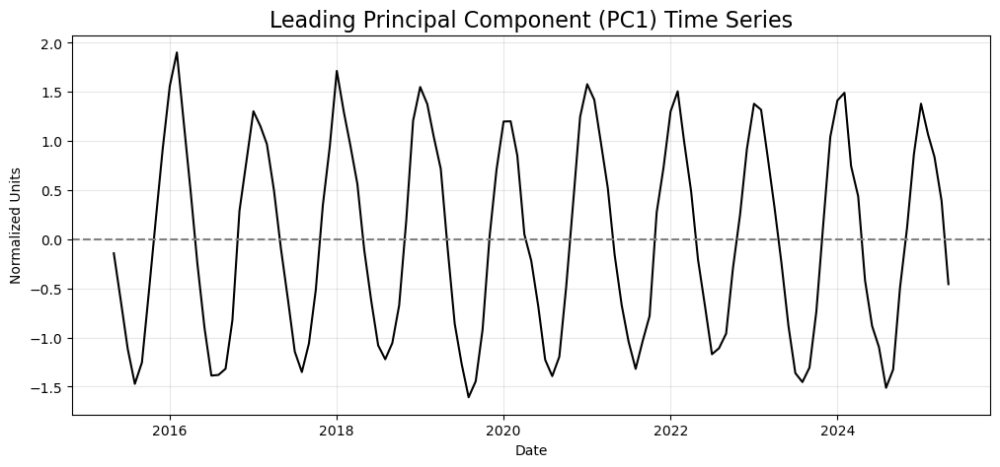

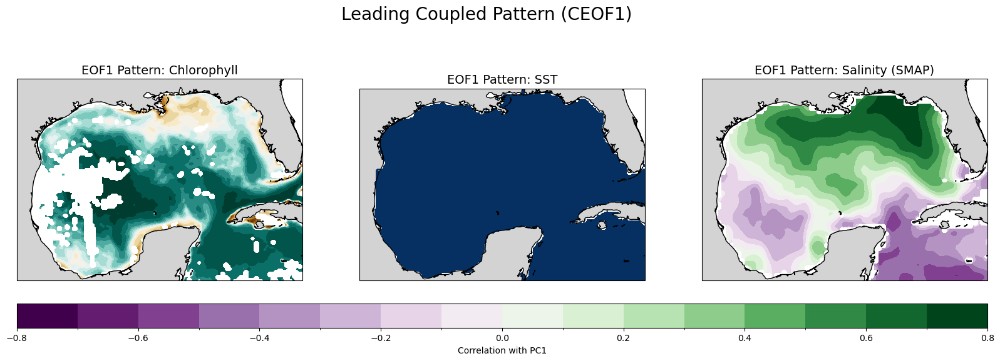

In [7]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from eofs.xarray import Eof

# --- 1. Load Data ---
# File paths from your setup
path_chl = r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4"
path_sst = r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4"
path_smap = r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"

# Load data using the exact variable names from your files
da_chl = xr.open_dataset(path_chl)['chlor_a']
da_sst = xr.open_dataset(path_sst)['analysed_sst']
da_smap = xr.open_dataset(path_smap)['smap_sss'] # CORRECTED variable name

# --- 2. Standardize Each Variable ---
# Function to standardize a DataArray using the 'StdTime' coordinate
def standardize(da):
    """Calculates the standardized anomaly for a DataArray."""
    mean = da.mean(dim='StdTime') # CORRECTED dimension name
    std = da.std(dim='StdTime')   # CORRECTED dimension name
    # Avoid division by zero for grid points with no variance (e.g., land)
    return (da - mean) / std.where(std > 0, 1)

da_chl_std = standardize(da_chl)
da_sst_std = standardize(da_sst)
da_smap_std = standardize(da_smap)

# --- 3. Combine Standardized Data ---
# Stack the standardized arrays into a single DataArray.
# ## FIX ##: Name the new dimension directly with a string.
combined_data = xr.concat(
    [da_chl_std, da_sst_std, da_smap_std],
    dim='variable'
)
# Assign coordinate labels to the new 'variable' dimension
combined_data['variable'] = ['CHL', 'SST', 'SMAP_SSS']


# Transpose the array to make 'StdTime' the first dimension. This will now work.
combined_data = combined_data.transpose('StdTime', 'variable', 'lat', 'lon')

# (Optional) You can uncomment the next line to verify the dimension order
# print(combined_data.dims)

# --- 4. Perform Combined EOF Analysis ---
# Apply latitude weights using the 'lat' coordinate
coslat = np.cos(np.deg2rad(combined_data.coords['lat'].values)) 
# ... the rest of the script remains the same
wgts = np.sqrt(coslat)[..., np.newaxis]

# Create an EOF solver on the combined data
# The solver will use all non-'StdTime' dimensions ('variable', 'lat', 'lon') as the feature space
solver = Eof(combined_data, weights=wgts)

# Retrieve the leading mode of coupled variability
eof1 = solver.eofsAsCorrelation(neofs=1)
pc1 = solver.pcs(npcs=1, pcscaling=1)
variance_fraction = solver.varianceFraction(neigs=1)

print(f"✅ Fraction of combined variance explained by CEOF1: {variance_fraction.values[0]:.2f}")

# --- 5. Visualize the Results ---
# Plot the leading PC time series
plt.figure(figsize=(12, 5))
pc1.plot(color='k')
plt.axhline(0, color='gray', linestyle='--')
plt.title('Leading Principal Component (PC1) Time Series', fontsize=16)
plt.ylabel('Normalized Units')
plt.xlabel('Date')
plt.grid(True, alpha=0.3)
plt.show()

# Unstack the EOF to plot the spatial pattern for each variable 🗺️
eof1_chl = eof1.sel(variable='CHL').squeeze()
eof1_sst = eof1.sel(variable='SST').squeeze()
eof1_smap = eof1.sel(variable='SMAP_SSS').squeeze() # Adjusted SMAP label

# Create a figure with 3 subplots for the spatial maps
fig, axes = plt.subplots(
    nrows=1, ncols=3,
    figsize=(20, 6),
    subplot_kw={'projection': ccrs.PlateCarree()}
)

# Define contour levels for correlation maps
clevs = np.linspace(-0.8, 0.8, 17)

# Plot for Chlorophyll
eof1_chl.plot.contourf(ax=axes[0], levels=clevs, cmap='BrBG', transform=ccrs.PlateCarree(), add_colorbar=False)
axes[0].coastlines()
axes[0].add_feature(cfeature.LAND, facecolor='lightgray')
axes[0].set_title('EOF1 Pattern: Chlorophyll', fontsize=14)

# Plot for SST
eof1_sst.plot.contourf(ax=axes[1], levels=clevs, cmap='RdBu_r', transform=ccrs.PlateCarree(), add_colorbar=False)
axes[1].coastlines()
axes[1].add_feature(cfeature.LAND, facecolor='lightgray')
axes[1].set_title('EOF1 Pattern: SST', fontsize=14)

# Plot for SMAP SSS
im = eof1_smap.plot.contourf(ax=axes[2], levels=clevs, cmap='PRGn', transform=ccrs.PlateCarree(), add_colorbar=False)
axes[2].coastlines()
axes[2].add_feature(cfeature.LAND, facecolor='lightgray')
axes[2].set_title('EOF1 Pattern: Salinity (SMAP)', fontsize=14)

# Add a single colorbar for all subplots
fig.colorbar(im, ax=axes, orientation='horizontal', aspect=40, pad=0.08, label='Correlation with PC1')
plt.suptitle('Leading Coupled Pattern (CEOF1)', fontsize=20, y=1.02)
plt.show()

---- Variance Explained by Each Mode ----
Mode 1: 47.12%
Mode 2: 9.95%
Mode 3: 4.85%
Mode 4: 4.77%
Mode 5: 3.50%
---------------------------------------

--- Correlation of PC1 with Spatially-Averaged Variables ---
Correlation with Chlorophyll: -0.150
Correlation with SST:         -0.985
Correlation with Salinity:    0.744
----------------------------------------------------------

✅ Principal components saved to: C:\Users\jspier\pre\study_data\Gulf\principal_components.csv

--- First 5 rows of the PC DataFrame ---
                 PC1       PC2       PC3       PC4       PC5
2015-05-01 -0.142110  1.716795 -0.394453  0.117099 -1.122511
2015-06-01 -0.631806  1.372731 -0.427723  0.533715 -2.462171
2015-07-01 -1.116783  0.807454  1.828773  2.120677 -3.198949
2015-08-01 -1.471187 -1.086817  2.795680  1.394970  0.852821
2015-09-01 -1.253832 -1.030099  0.751214  0.615946  0.732148
----------------------------------------


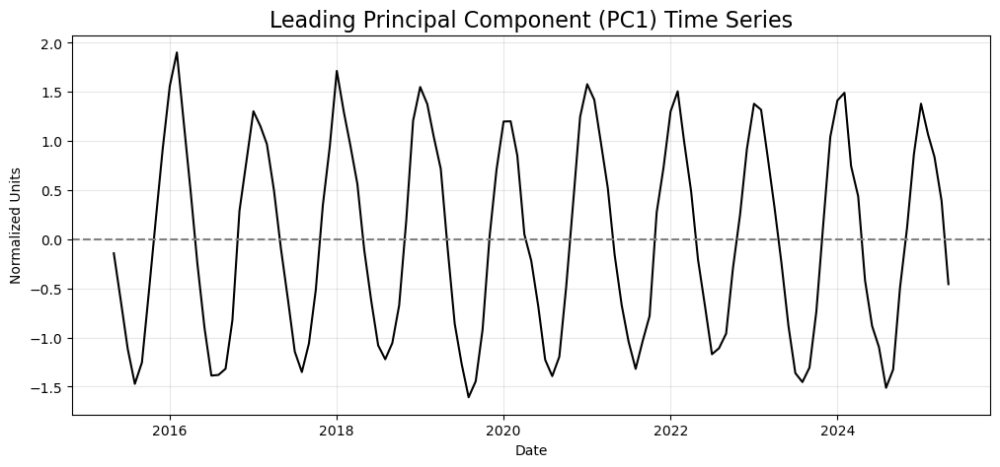

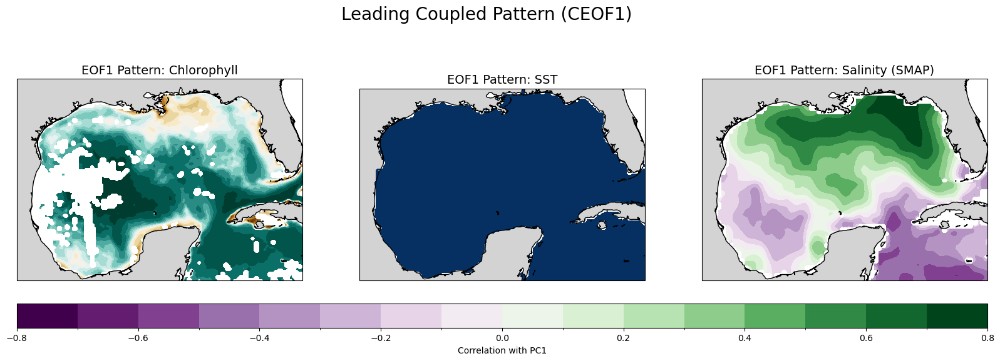

In [8]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from eofs.xarray import Eof

# --- 1. File Paths and Parameters ---
path_chl = r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4"
path_sst = r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4"
path_smap = r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
output_csv_path = r"C:\Users\jspier\pre\study_data\Gulf\principal_components.csv"
n_modes = 5

# --- 2. Load Data ---
# Load data using the exact variable names from your files
da_chl = xr.open_dataset(path_chl)['chlor_a']
da_sst = xr.open_dataset(path_sst)['analysed_sst']
da_smap = xr.open_dataset(path_smap)['smap_sss']

# --- 3. Standardize and Combine Data ---
def standardize(da):
    """Calculates the standardized anomaly for a DataArray."""
    mean = da.mean(dim='StdTime')
    std = da.std(dim='StdTime')
    return (da - mean) / std.where(std > 0, 1)

da_chl_std = standardize(da_chl)
da_sst_std = standardize(da_sst)
da_smap_std = standardize(da_smap)

# Stack the standardized arrays, naming the new dimension 'variable'
combined_data = xr.concat(
    [da_chl_std, da_sst_std, da_smap_std],
    dim='variable'
)
combined_data['variable'] = ['CHL', 'SST', 'SMAP_SSS']

# Transpose the array to make 'StdTime' the first dimension, as required by eofs
combined_data = combined_data.transpose('StdTime', 'variable', 'lat', 'lon')

# --- 4. Perform Combined EOF Analysis ---
# Apply latitude weights to account for grid cell area differences
coslat = np.cos(np.deg2rad(combined_data.coords['lat'].values))
wgts = np.sqrt(coslat)[..., np.newaxis]

# Create an EOF solver on the combined data
solver = Eof(combined_data, weights=wgts)

# --- 5. Generate Numerical and Text Outputs ---

# a) Get and print the variance explained by the leading modes
variance_fraction = solver.varianceFraction(neigs=n_modes)
print("---- Variance Explained by Each Mode ----")
for i in range(n_modes):
    print(f"Mode {i+1}: {variance_fraction.values[i] * 100:.2f}%")
print("---------------------------------------")

# b) Correlate PC1 with the spatially-averaged original variables
# First, get PC1 and create anomaly time series for each variable
pc1 = solver.pcs(npcs=1, pcscaling=1)
da_chl_anom = da_chl - da_chl.mean(dim='StdTime')
da_sst_anom = da_sst - da_sst.mean(dim='StdTime')
da_smap_anom = da_smap - da_smap.mean(dim='StdTime')

# Create a spatially-averaged time series for each anomaly
chl_series = da_chl_anom.mean(['lat', 'lon'])
sst_series = da_sst_anom.mean(['lat', 'lon'])
smap_series = da_smap_anom.mean(['lat', 'lon'])

# Calculate correlation between PC1 and each series
corr_chl = np.corrcoef(pc1.squeeze(), chl_series)[0, 1]
corr_sst = np.corrcoef(pc1.squeeze(), sst_series)[0, 1]
corr_smap = np.corrcoef(pc1.squeeze(), smap_series)[0, 1]

print("\n--- Correlation of PC1 with Spatially-Averaged Variables ---")
print(f"Correlation with Chlorophyll: {corr_chl:.3f}")
print(f"Correlation with SST:         {corr_sst:.3f}")
print(f"Correlation with Salinity:    {corr_smap:.3f}")
print("----------------------------------------------------------")

# c) Save the leading PCs to a text file (CSV) 💾
pcs = solver.pcs(npcs=n_modes, pcscaling=1)
df_pcs = pd.DataFrame(pcs.values, index=pcs['StdTime'].values, columns=[f'PC{i+1}' for i in range(n_modes)])
df_pcs.to_csv(output_csv_path)

print(f"\n✅ Principal components saved to: {output_csv_path}")
print("\n--- First 5 rows of the PC DataFrame ---")
print(df_pcs.head())
print("----------------------------------------")

# --- 6. Generate Visual Outputs 📈 ---

# a) Plot the leading PC time series
plt.figure(figsize=(12, 5))
pc1.plot(color='k')
plt.axhline(0, color='gray', linestyle='--')
plt.title('Leading Principal Component (PC1) Time Series', fontsize=16)
plt.ylabel('Normalized Units')
plt.xlabel('Date')
plt.grid(True, alpha=0.3)
plt.show()

# b) Plot the leading EOF pattern (correlation maps)
eof1 = solver.eofsAsCorrelation(neofs=1)

# Unstack the EOF to plot the spatial pattern for each variable 🗺️
eof1_chl = eof1.sel(variable='CHL').squeeze()
eof1_sst = eof1.sel(variable='SST').squeeze()
eof1_smap = eof1.sel(variable='SMAP_SSS').squeeze()

# Create a figure with 3 subplots for the spatial maps
fig, axes = plt.subplots(
    nrows=1, ncols=3,
    figsize=(20, 6),
    subplot_kw={'projection': ccrs.PlateCarree()}
)

clevs = np.linspace(-0.8, 0.8, 17)

# Plot for Chlorophyll
eof1_chl.plot.contourf(ax=axes[0], levels=clevs, cmap='BrBG', transform=ccrs.PlateCarree(), add_colorbar=False)
axes[0].coastlines()
axes[0].add_feature(cfeature.LAND, facecolor='lightgray')
axes[0].set_title('EOF1 Pattern: Chlorophyll', fontsize=14)

# Plot for SST
eof1_sst.plot.contourf(ax=axes[1], levels=clevs, cmap='RdBu_r', transform=ccrs.PlateCarree(), add_colorbar=False)
axes[1].coastlines()
axes[1].add_feature(cfeature.LAND, facecolor='lightgray')
axes[1].set_title('EOF1 Pattern: SST', fontsize=14)

# Plot for SMAP SSS
im = eof1_smap.plot.contourf(ax=axes[2], levels=clevs, cmap='PRGn', transform=ccrs.PlateCarree(), add_colorbar=False)
axes[2].coastlines()
axes[2].add_feature(cfeature.LAND, facecolor='lightgray')
axes[2].set_title('EOF1 Pattern: Salinity (SMAP)', fontsize=14)

# Add a single colorbar for all subplots
fig.colorbar(im, ax=axes, orientation='horizontal', aspect=40, pad=0.08, label='Correlation with PC1')
plt.suptitle('Leading Coupled Pattern (CEOF1)', fontsize=20, y=1.02)
plt.show()

---- Variance Explained by Each Deseasonalized Mode ----
Mode 1: 17.72%
Mode 2: 7.40%
Mode 3: 7.10%
Mode 4: 5.52%
Mode 5: 5.09%
------------------------------------------------------

--- Correlation of PC1 with Spatially-Averaged Variables ---
Correlation with Chlorophyll: -0.125
Correlation with SST:         0.972
Correlation with Salinity:    0.223
----------------------------------------------------------

✅ Principal components saved to: C:\Users\jspier\pre\study_data\Gulf\deseasonalized_principal_components.csv


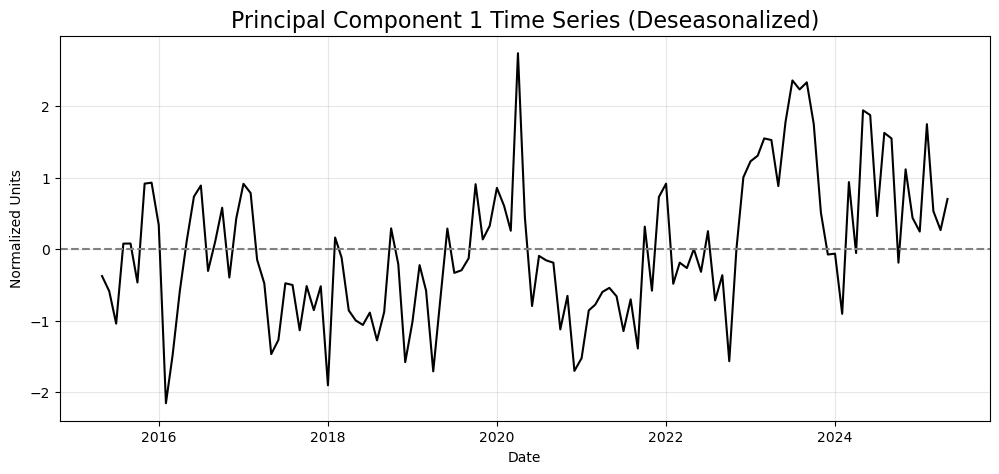

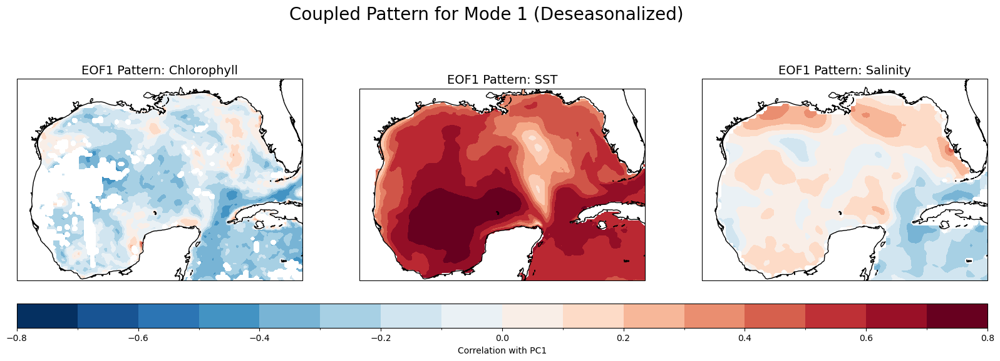

In [11]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from eofs.xarray import Eof

# --- 1. File Paths and Parameters ---
path_chl = r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4"
path_sst = r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4"
path_smap = r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
output_csv_path = r"C:\Users\jspier\pre\study_data\Gulf\deseasonalized_principal_components.csv"

# --- CHOOSE WHICH MODE TO ANALYZE AND PLOT ---
mode_to_plot = 1 # Change this to 2, 3, etc., to analyze other modes
n_modes_total = 5 # Total number of modes to compute

# --- 2. Load and Pre-process Data ---
# Load data
da_chl = xr.open_dataset(path_chl)['chlor_a']
da_sst = xr.open_dataset(path_sst)['analysed_sst']
da_smap = xr.open_dataset(path_smap)['smap_sss']

# ** FIX **: Rename the time dimension to 'time' to conform with the eofs library
da_chl = da_chl.rename({'StdTime': 'time'})
da_sst = da_sst.rename({'StdTime': 'time'})
da_smap = da_smap.rename({'StdTime': 'time'})

# Deseasonalize the data by subtracting the monthly climatology
def deseasonalize(da):
    """Removes the mean seasonal cycle from a DataArray."""
    climatology = da.groupby('time.month').mean('time')
    return da.groupby('time.month') - climatology

da_chl_deseason = deseasonalize(da_chl)
da_sst_deseason = deseasonalize(da_sst)
da_smap_deseason = deseasonalize(da_smap)

# Standardize the deseasonalized anomalies
def standardize(da):
    """Calculates the standardized anomaly for a DataArray."""
    mean = da.mean(dim='time')
    std = da.std(dim='time')
    return (da - mean) / std.where(std > 0, 1)

da_chl_std = standardize(da_chl_deseason)
da_sst_std = standardize(da_sst_deseason)
da_smap_std = standardize(da_smap_deseason)

# --- 3. Combine and Prepare Data for CEOF ---
# Stack the standardized arrays
combined_data = xr.concat(
    [da_chl_std, da_sst_std, da_smap_std],
    dim='variable'
)
combined_data['variable'] = ['CHL', 'SST', 'SMAP_SSS']

# Transpose the array to make 'time' the first dimension
combined_data = combined_data.transpose('time', 'variable', 'lat', 'lon')

# --- 4. Perform Combined EOF Analysis ---
coslat = np.cos(np.deg2rad(combined_data.coords['lat'].values))
wgts = np.sqrt(coslat)[..., np.newaxis]
solver = Eof(combined_data, weights=wgts)

# --- 5. Generate Numerical and Text Outputs ---
# a) Get and print the variance explained
variance_fraction = solver.varianceFraction(neigs=n_modes_total)
print("---- Variance Explained by Each Deseasonalized Mode ----")
for i in range(n_modes_total):
    print(f"Mode {i+1}: {variance_fraction.values[i] * 100:.2f}%")
print("------------------------------------------------------")

# b) Correlate the selected PC with spatially-averaged variables
pcs = solver.pcs(npcs=n_modes_total, pcscaling=1)
pc_selected = pcs.sel(mode=mode_to_plot - 1)

chl_series = da_chl_deseason.mean(['lat', 'lon'])
sst_series = da_sst_deseason.mean(['lat', 'lon'])
smap_series = da_smap_deseason.mean(['lat', 'lon'])

corr_chl = np.corrcoef(pc_selected, chl_series)[0, 1]
corr_sst = np.corrcoef(pc_selected, sst_series)[0, 1]
corr_smap = np.corrcoef(pc_selected, smap_series)[0, 1]

print(f"\n--- Correlation of PC{mode_to_plot} with Spatially-Averaged Variables ---")
print(f"Correlation with Chlorophyll: {corr_chl:.3f}")
print(f"Correlation with SST:         {corr_sst:.3f}")
print(f"Correlation with Salinity:    {corr_smap:.3f}")
print("----------------------------------------------------------")

# c) Save all computed PCs to a text file
df_pcs = pd.DataFrame(pcs.values, index=pcs['time'].values, columns=[f'PC{i+1}' for i in range(n_modes_total)])
df_pcs.to_csv(output_csv_path)
print(f"\n✅ Principal components saved to: {output_csv_path}")

# --- 6. Generate Visual Outputs for the Selected Mode ---
# a) Plot the selected PC time series
plt.figure(figsize=(12, 5))
pc_selected.plot(color='k')
plt.axhline(0, color='gray', linestyle='--')
plt.title(f'Principal Component {mode_to_plot} Time Series (Deseasonalized)', fontsize=16)
plt.ylabel('Normalized Units')
plt.xlabel('Date')
plt.grid(True, alpha=0.3)
plt.show()

# b) Plot the selected EOF pattern
eofs = solver.eofsAsCorrelation(neofs=n_modes_total)
eof_selected = eofs.sel(mode=mode_to_plot - 1)

# Unstack the EOF for plotting
eof_chl = eof_selected.sel(variable='CHL')
eof_sst = eof_selected.sel(variable='SST')
eof_smap = eof_selected.sel(variable='SMAP_SSS')

# Create a figure with 3 subplots
fig, axes = plt.subplots(
    nrows=1, ncols=3,
    figsize=(20, 6),
    subplot_kw={'projection': ccrs.PlateCarree()}
)

clevs = np.linspace(-0.8, 0.8, 17)
cmap_unified = 'RdBu_r'

# Plot for Chlorophyll
eof_chl.plot.contourf(ax=axes[0], levels=clevs, cmap=cmap_unified, transform=ccrs.PlateCarree(), add_colorbar=False)
axes[0].coastlines()
axes[0].set_title(f'EOF{mode_to_plot} Pattern: Chlorophyll', fontsize=14)

# Plot for SST
eof_sst.plot.contourf(ax=axes[1], levels=clevs, cmap=cmap_unified, transform=ccrs.PlateCarree(), add_colorbar=False)
axes[1].coastlines()
axes[1].set_title(f'EOF{mode_to_plot} Pattern: SST', fontsize=14)

# Plot for Salinity
im = eof_smap.plot.contourf(ax=axes[2], levels=clevs, cmap=cmap_unified, transform=ccrs.PlateCarree(), add_colorbar=False)
axes[2].coastlines()
axes[2].set_title(f'EOF{mode_to_plot} Pattern: Salinity', fontsize=14)

# Add a single, unified colorbar
fig.colorbar(im, ax=axes, orientation='horizontal', aspect=40, pad=0.08, label=f'Correlation with PC{mode_to_plot}')
plt.suptitle(f'Coupled Pattern for Mode {mode_to_plot} (Deseasonalized)', fontsize=20, y=1.02)
plt.show()

Gulf Region EOF Analysis
Following Sicily Channel Methodology
Datasets: CHL (Chlorophyll), OSTIA (SST), SMAP (SSS)
Time period: May 2015 - May 2025 (121 monthly time steps)
Study region: Gulf of Mexico
Methodology: Sicily Channel (Rinaldi et al., 2014)

Loading Gulf region datasets...

CHL Dataset (chlor_a):
  File: CHL_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.5% (673,903 / 2,750,693 points)

OSTIA Dataset (analysed_sst):
  File: OSTIA_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.7% (679,899 / 2,750,693 points)

SMAP Dataset (smap_sss):
  File: SMAP_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000

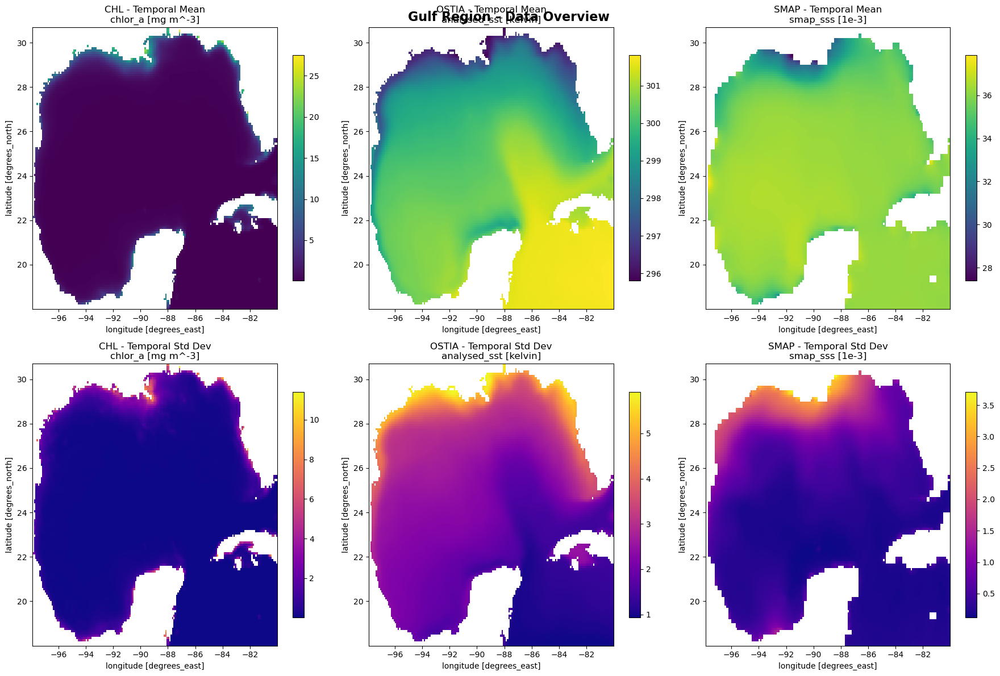

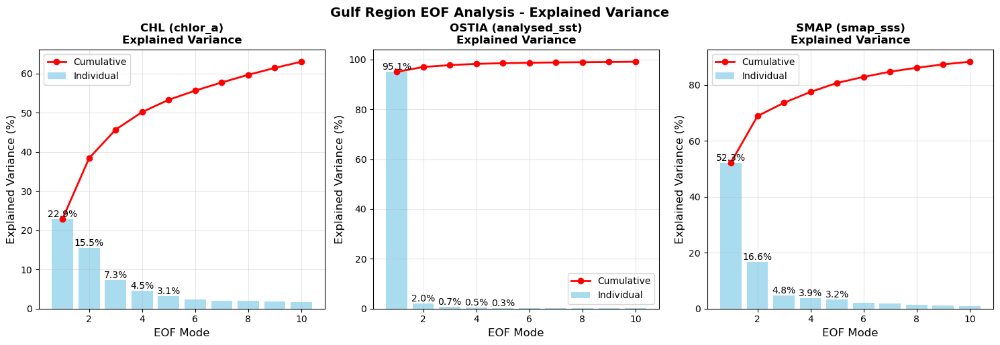


Generating plots for CHL...


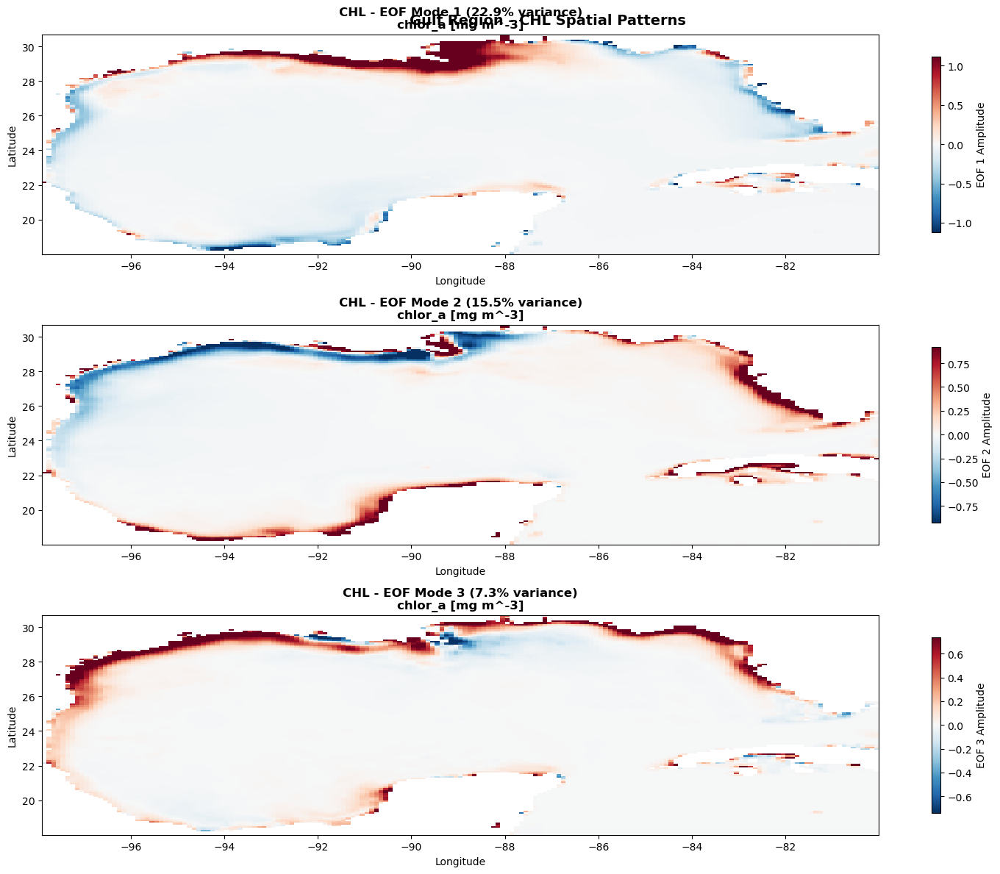

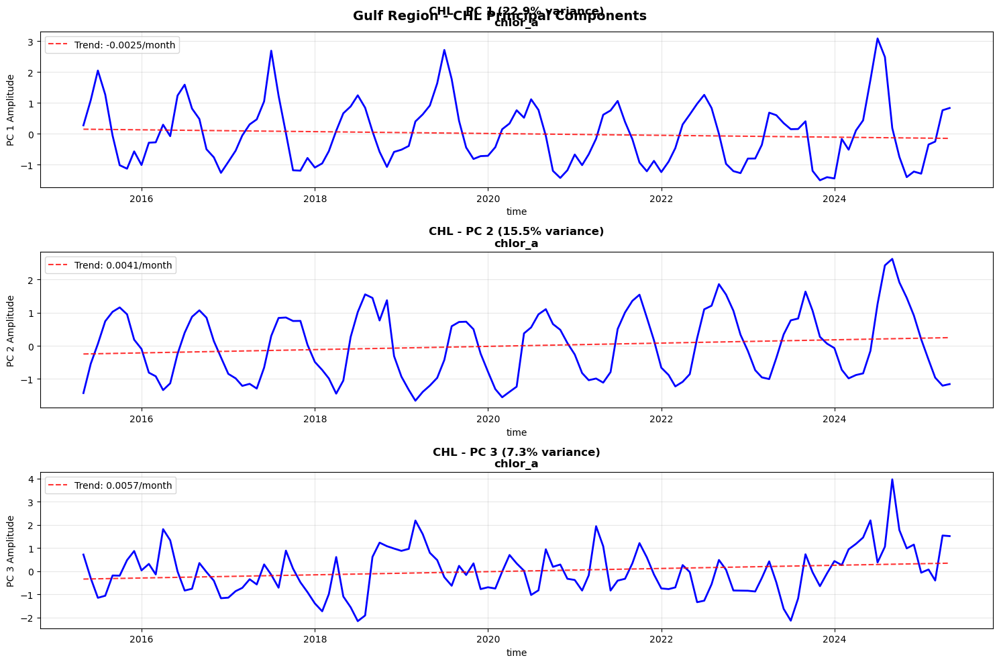


Generating plots for OSTIA...


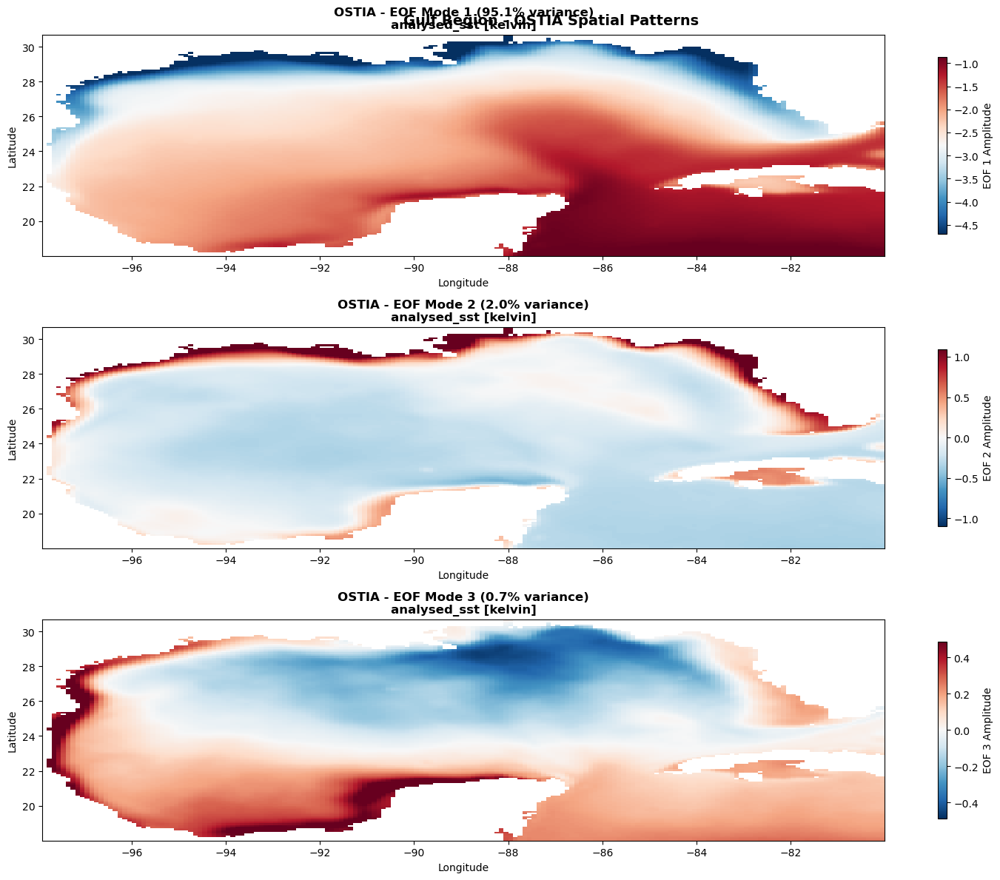

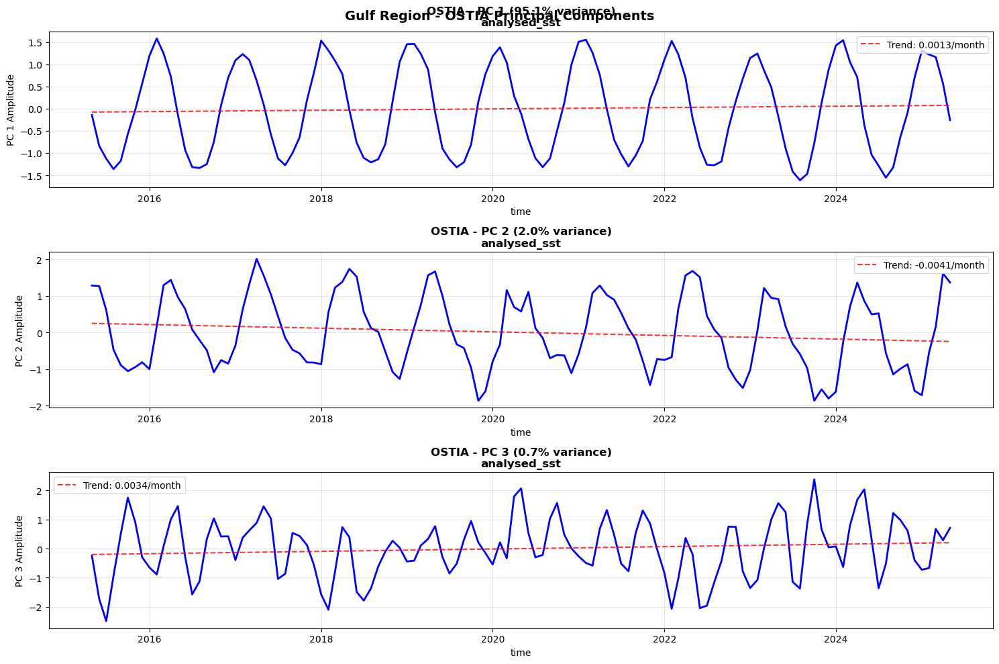


Generating plots for SMAP...


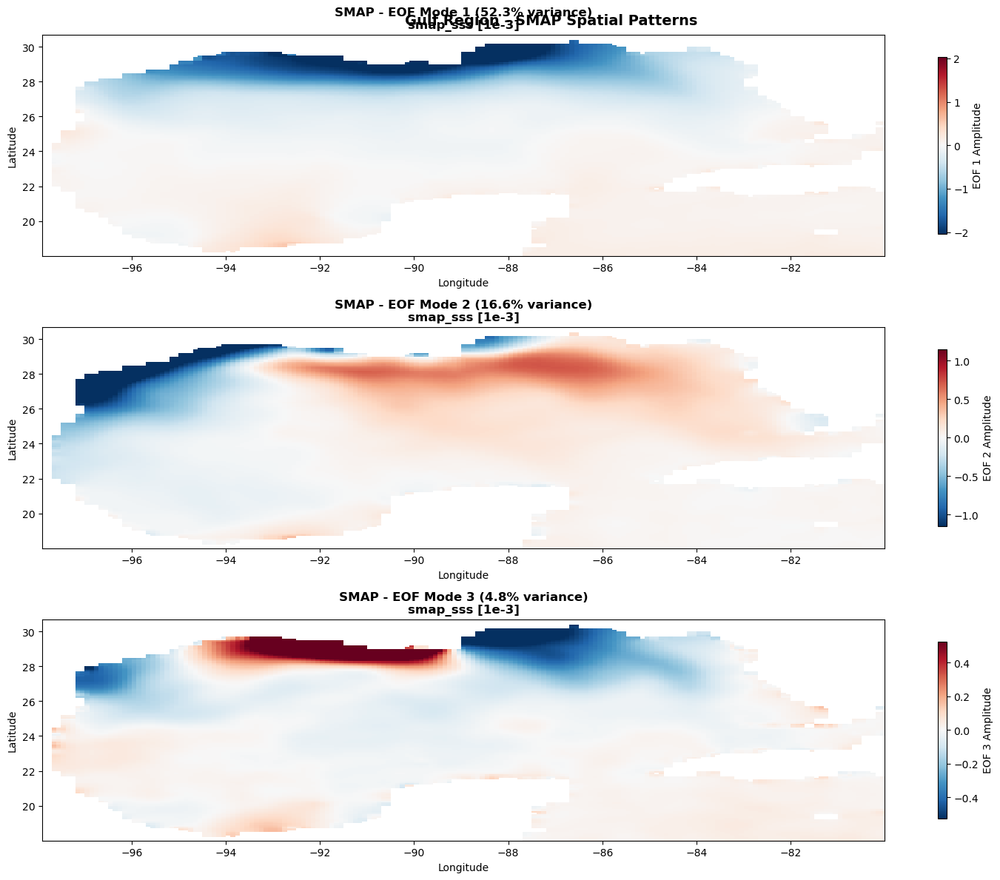

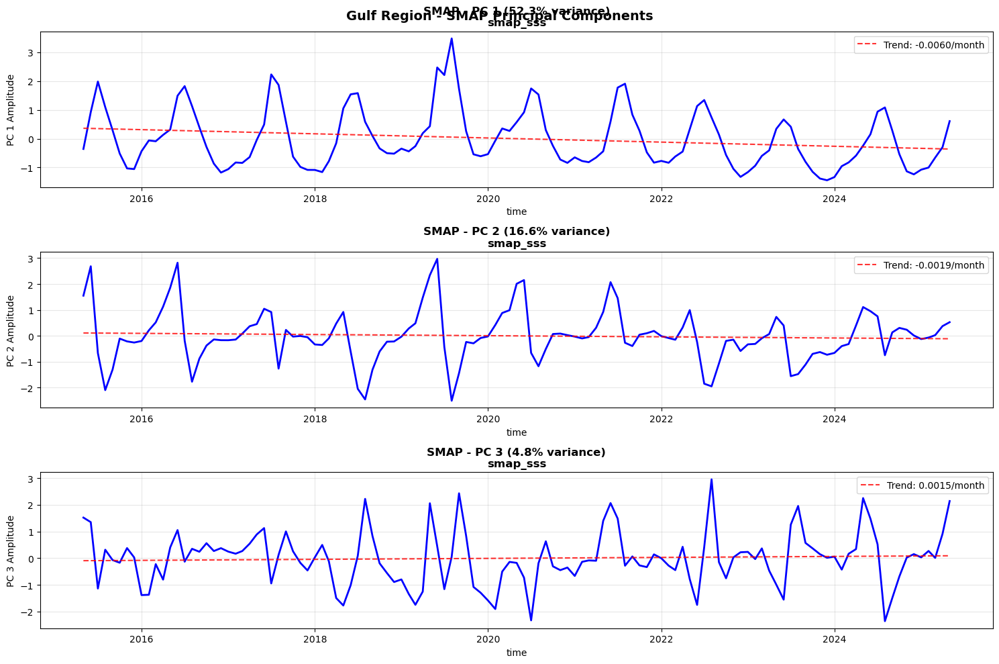


Saving results to 'gulf_eof_results' directory...
  ✓ CHL results saved
  ✓ OSTIA results saved
  ✓ SMAP results saved
  ✓ Summary statistics saved
All results saved to 'gulf_eof_results' directory

ANALYSIS COMPLETE
Results saved to 'gulf_eof_results' directory
Check output files for detailed results and visualizations


In [2]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from eofs.xarray import Eof
from eofs.tools.standard import correlation_map, covariance_map
import warnings
warnings.filterwarnings('ignore')

class GulfEOFAnalysis:
    """
    EOF analysis for Gulf region geospatial time series following Sicily Channel methodology
    Handles chlorophyll (CHL), sea surface temperature (SST), and sea surface salinity (SSS)
    """
    
    def __init__(self, filepaths):
        """
        Initialize with Gulf region netCDF file paths
        
        Parameters:
        -----------
        filepaths : list
            List of netCDF file paths for Gulf region data
        """
        self.filepaths = filepaths
        self.datasets = {}
        self.processed_data = {}
        self.eof_results = {}
        self.missing_data_stats = {}
        
    def load_data(self):
        """Load Gulf region netCDF files and identify variables"""
        print("Loading Gulf region datasets...")
        print("=" * 50)
        
        # Variable mapping for Gulf datasets
        variable_mapping = {
            'CHL': 'chlor_a',
            'OSTIA': 'analysed_sst', 
            'SMAP': 'smap_sss'
        }
        
        for i, filepath in enumerate(self.filepaths):
            try:
                # Load dataset
                ds = xr.open_dataset(filepath, chunks={'StdTime': 50})
                
                # Identify dataset type from filename
                dataset_type = None
                for key in variable_mapping.keys():
                    if key in filepath:
                        dataset_type = key
                        break
                
                if dataset_type is None:
                    print(f"Could not identify dataset type for {filepath}")
                    continue
                    
                var_name = variable_mapping[dataset_type]
                
                if var_name not in ds.data_vars:
                    print(f"Variable {var_name} not found in {filepath}")
                    continue
                
                # Extract data array and standardize coordinates
                data_array = ds[var_name]
                if 'StdTime' in data_array.dims:
                    data_array = data_array.rename({'StdTime': 'time'})
                
                self.datasets[dataset_type] = {
                    'data': data_array,
                    'variable_name': var_name,
                    'filepath': filepath,
                    'units': data_array.attrs.get('units', 'unknown')
                }
                
                print(f"\n{dataset_type} Dataset ({var_name}):")
                filename = filepath.split('\\')[-1]
                print(f"  File: {filename}")
                print(f"  Shape: {data_array.shape}")
                print(f"  Time range: {data_array.time.values[0]} to {data_array.time.values[-1]}")
                print(f"  Spatial extent: {data_array.lat.values.min():.2f}°N - {data_array.lat.values.max():.2f}°N")
                print(f"                  {data_array.lon.values.min():.2f}°E - {data_array.lon.values.max():.2f}°E")
                
                # Calculate missing data statistics
                total_points = data_array.size
                valid_points = (~np.isnan(data_array)).sum().values
                missing_pct = (1 - valid_points/total_points) * 100
                print(f"  Missing data: {missing_pct:.1f}% ({total_points-valid_points:,} / {total_points:,} points)")
                
                self.missing_data_stats[dataset_type] = {
                    'total_points': total_points,
                    'valid_points': valid_points,
                    'missing_percentage': missing_pct
                }
                
            except Exception as e:
                print(f"Error loading {filepath}: {e}")
    
    def analyze_missing_data(self):
        """Analyze spatial patterns of missing data"""
        print("\n" + "=" * 50)
        print("MISSING DATA ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            data = data_info['data']
            print(f"\n{dataset_type} ({data_info['variable_name']}):")
            
            # Calculate missing data percentage for each spatial location
            missing_by_location = np.isnan(data).mean(dim='time') * 100
            
            # Statistics
            locations_over_60pct = (missing_by_location > 60).sum().values
            total_locations = missing_by_location.size
            
            print(f"  Spatial locations with >60% missing: {locations_over_60pct} / {total_locations}")
            print(f"  Percentage of locations to remove: {locations_over_60pct/total_locations*100:.1f}%")
            print(f"  Missing data range: {missing_by_location.min().values:.1f}% - {missing_by_location.max().values:.1f}%")
            print(f"  Mean missing data per location: {missing_by_location.mean().values:.1f}%")
            
            # Store missing data mask
            self.missing_data_stats[dataset_type]['missing_by_location'] = missing_by_location
            self.missing_data_stats[dataset_type]['valid_locations_mask'] = missing_by_location <= 60
    
    def preprocess_data(self):
        """
        Preprocess data following Sicily Channel methodology:
        1. Remove locations with >60% missing data
        2. Apply seasonal climatological interpolation
        3. Remove temporal mean and apply latitude weighting
        """
        print("\n" + "=" * 50)
        print("DATA PREPROCESSING")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            print(f"\nProcessing {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            # Step 1: Remove locations with >60% missing data
            missing_mask = self.missing_data_stats[dataset_type]['missing_by_location'] > 60
            
            # Apply mask - set these locations to NaN
            data_masked = data.where(~missing_mask)
            
            locations_removed = missing_mask.sum().values
            total_locations = missing_mask.size
            print(f"  Removed {locations_removed} locations ({locations_removed/total_locations*100:.1f}%) with >60% missing data")
            
            # Step 2: Seasonal climatological interpolation
            print("  Applying seasonal interpolation...")
            data_interpolated = self._seasonal_interpolation(data_masked)
            
            # Check interpolation results
            remaining_nan = np.isnan(data_interpolated).sum().values
            total_points = data_interpolated.size
            print(f"  Remaining NaN values after interpolation: {remaining_nan} / {total_points} ({remaining_nan/total_points*100:.3f}%)")
            
            # Step 3: Remove temporal mean (centering)
            print("  Removing temporal mean...")
            temporal_mean = data_interpolated.mean(dim='time')
            data_centered = data_interpolated - temporal_mean
            
            # Step 4: Apply latitude weighting (as per Sicily Channel paper)
            print("  Applying latitude weighting...")
            lat_weights = np.sqrt(np.cos(np.deg2rad(data.lat)))
            data_weighted = data_centered * lat_weights
            
            # Store processed data
            self.processed_data[dataset_type] = {
                'data': data_weighted,
                'data_centered': data_centered,  # Keep unweighted version for some analyses
                'temporal_mean': temporal_mean,
                'original_data': data,
                'variable_name': data_info['variable_name'],
                'units': data_info['units']
            }
            
            print(f"  ✓ Preprocessing complete for {dataset_type}")
    
    def _seasonal_interpolation(self, data):
        """
        Apply seasonal climatological interpolation
        Fill missing values with monthly climatological mean for that location
        """
        # Create monthly climatology (mean for each month across all years)
        monthly_clim = data.groupby('time.month').mean(dim='time')
        
        # Create a function to fill NaN values with climatological values
        def fill_with_climatology(monthly_data, month_clim):
            # Where data is NaN, use climatology
            return monthly_data.fillna(month_clim)
        
        # Apply interpolation month by month
        data_filled = data.copy()
        
        for month in range(1, 13):
            month_mask = data.time.dt.month == month
            if month_mask.any():
                month_data = data.isel(time=month_mask)
                month_clim = monthly_clim.sel(month=month)
                
                # Fill NaN values with climatology for this month
                filled_month = month_data.fillna(month_clim)
                data_filled.loc[dict(time=month_mask)] = filled_month
        
        return data_filled
    
    def perform_eof_analysis(self, n_modes=10):
        """
        Perform EOF analysis on each variable separately
        Following Sicily Channel methodology
        """
        print("\n" + "=" * 50)
        print("EOF ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.processed_data.items():
            print(f"\nPerforming EOF analysis: {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            try:
                # Create EOF solver with the processed data
                solver = Eof(data, weights=None)  # weights already applied in preprocessing
                
                # Compute EOFs and PCs
                eofs = solver.eofs(neofs=n_modes, eofscaling=2)  # Unit variance scaling
                pcs = solver.pcs(npcs=n_modes, pcscaling=1)     # Unit variance scaling
                eigenvalues = solver.eigenvalues(neigs=n_modes)
                variance_fractions = solver.varianceFraction(neigs=n_modes)
                
                # Store results
                self.eof_results[dataset_type] = {
                    'eofs': eofs,
                    'pcs': pcs,
                    'eigenvalues': eigenvalues,
                    'variance_fractions': variance_fractions,
                    'solver': solver,
                    'variable_name': data_info['variable_name'],
                    'units': data_info['units']
                }
                
                # Print results
                print(f"  ✓ EOF analysis complete")
                print(f"  First 5 modes explain: {variance_fractions.values[:5] * 100}")
                print(f"  Cumulative variance (first 5): {np.cumsum(variance_fractions.values[:5]) * 100}")
                
                # Compare with Sicily Channel results
                if dataset_type == 'CHL':
                    first_mode_var = variance_fractions.values[0] * 100
                    print(f"  CHL Mode 1 variance: {first_mode_var:.1f}% (Sicily Channel: 78.8%)")
                
            except Exception as e:
                print(f"  ✗ Error in EOF analysis: {e}")
    
    def cross_correlation_analysis(self):
        """
        Perform cross-correlation analysis between variables
        Following Sicily Channel methodology
        """
        if len(self.eof_results) < 2:
            print("Need at least 2 variables for cross-correlation analysis")
            return
            
        print("\n" + "=" * 50)
        print("CROSS-CORRELATION ANALYSIS")
        print("=" * 50)
        
        # Define pairs for correlation analysis
        correlation_pairs = []
        dataset_types = list(self.eof_results.keys())
        
        for i, type1 in enumerate(dataset_types):
            for j, type2 in enumerate(dataset_types[i+1:], i+1):
                correlation_pairs.append((type1, type2))
        
        for type1, type2 in correlation_pairs:
            print(f"\n{type1} vs {type2} Correlation Analysis:")
            print("-" * 40)
            
            pcs1 = self.eof_results[type1]['pcs']
            pcs2 = self.eof_results[type2]['pcs']
            eofs1 = self.eof_results[type1]['eofs']
            eofs2 = self.eof_results[type2]['eofs']
            
            # Analyze first 3 modes
            for mode in range(min(3, pcs1.shape[1], pcs2.shape[1])):
                pc1 = pcs1.isel(mode=mode)
                pc2 = pcs2.isel(mode=mode)
                eof1 = eofs1.isel(mode=mode)
                eof2 = eofs2.isel(mode=mode)
                
                # Temporal correlation
                temp_corr = np.corrcoef(pc1.values, pc2.values)[0, 1]
                
                # Spatial correlation (where both have valid data)
                valid_mask = ~(np.isnan(eof1) | np.isnan(eof2))
                if valid_mask.any():
                    eof1_valid = eof1.values[valid_mask]
                    eof2_valid = eof2.values[valid_mask]
                    spatial_corr = np.corrcoef(eof1_valid, eof2_valid)[0, 1]
                else:
                    spatial_corr = np.nan
                
                print(f"  Mode {mode+1}: Temporal r={temp_corr:.3f}, Spatial r={spatial_corr:.3f}")
                
                # Check for significant correlations (following Sicily Channel thresholds)
                if abs(temp_corr) > 0.5:
                    var1_pct = self.eof_results[type1]['variance_fractions'].values[mode] * 100
                    var2_pct = self.eof_results[type2]['variance_fractions'].values[mode] * 100
                    print(f"    → Strong temporal correlation! ({var1_pct:.1f}% & {var2_pct:.1f}% variance)")
    
    def plot_explained_variance(self, figsize=(15, 5)):
        """Plot explained variance for all EOF analyses"""
        n_datasets = len(self.eof_results)
        if n_datasets == 0:
            print("No EOF results to plot")
            return
            
        fig, axes = plt.subplots(1, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = [axes]
        
        for i, (dataset_type, results) in enumerate(self.eof_results.items()):
            ax = axes[i]
            
            variance_fractions = results['variance_fractions'].values * 100
            cumulative_variance = np.cumsum(variance_fractions)
            
            # Plot individual and cumulative variance
            bars = ax.bar(range(1, len(variance_fractions) + 1), variance_fractions, 
                         alpha=0.7, label='Individual', color='skyblue')
            line = ax.plot(range(1, len(variance_fractions) + 1), cumulative_variance, 
                          'ro-', label='Cumulative', linewidth=2, markersize=6)
            
            # Formatting
            ax.set_xlabel('EOF Mode', fontsize=12)
            ax.set_ylabel('Explained Variance (%)', fontsize=12)
            var_name = results['variable_name']
            ax.set_title(f'{dataset_type} ({var_name})\nExplained Variance', fontsize=12, weight='bold')
            ax.legend()
            ax.grid(True, alpha=0.3)
            
            # Add percentage labels on bars for first few modes
            for j, bar in enumerate(bars[:5]):
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2., height,
                       f'{height:.1f}%', ha='center', va='bottom', fontsize=10)
        
        plt.tight_layout()
        plt.suptitle('Gulf Region EOF Analysis - Explained Variance', y=1.02, fontsize=14, weight='bold')
        plt.show()
    
    def plot_spatial_patterns(self, dataset_type, modes=[0, 1, 2], figsize=(15, 12)):
        """Plot EOF spatial patterns (following Sicily Channel style)"""
        if dataset_type not in self.eof_results:
            print(f"Dataset {dataset_type} not found in EOF results")
            return
        
        results = self.eof_results[dataset_type]
        eofs = results['eofs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= eofs.shape[0]:
                continue
            
            ax = axes[i]
            
            # Get EOF spatial pattern
            eof_data = eofs.isel(mode=mode)
            
            # Plot with appropriate colormap (following Sicily Channel style)
            im = eof_data.plot(ax=ax, cmap='RdBu_r', add_colorbar=False, robust=True)
            
            # Add title with variance percentage
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            units = results['units']
            
            ax.set_title(f'{dataset_type} - EOF Mode {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name} [{units}]', fontsize=12, weight='bold')
            
            # Formatting
            ax.set_xlabel('Longitude', fontsize=10)
            ax.set_ylabel('Latitude', fontsize=10)
            
            # Add colorbar
            cbar = plt.colorbar(im, ax=ax, shrink=0.8)
            cbar.set_label(f'EOF {mode+1} Amplitude', fontsize=10)
        
        plt.tight_layout()
        plt.suptitle(f'Gulf Region - {dataset_type} Spatial Patterns', y=0.98, fontsize=14, weight='bold')
        plt.show()
    
    def plot_principal_components(self, dataset_type, modes=[0, 1, 2], figsize=(15, 10)):
        """Plot principal components time series"""
        if dataset_type not in self.eof_results:
            print(f"Dataset {dataset_type} not found in EOF results")
            return
        
        results = self.eof_results[dataset_type]
        pcs = results['pcs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= pcs.shape[1]:
                continue
            
            ax = axes[i]
            
            # Plot PC time series
            pc_data = pcs.isel(mode=mode)
            pc_data.plot(ax=ax, linewidth=2, color='blue')
            
            # Add variance info
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            
            ax.set_title(f'{dataset_type} - PC {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name}', fontsize=12, weight='bold')
            ax.set_ylabel(f'PC {mode + 1} Amplitude', fontsize=10)
            ax.grid(True, alpha=0.3)
            
            # Add trend line
            time_numeric = np.arange(len(pc_data))
            trend_coef = np.polyfit(time_numeric, pc_data.values, 1)
            trend_line = np.polyval(trend_coef, time_numeric)
            ax.plot(pc_data.time, trend_line, 'r--', alpha=0.8, 
                   label=f'Trend: {trend_coef[0]:.4f}/month')
            ax.legend()
        
        plt.tight_layout()
        plt.suptitle(f'Gulf Region - {dataset_type} Principal Components', y=0.98, fontsize=14, weight='bold')
        plt.show()
    
    def plot_data_overview(self, figsize=(18, 12)):
        """Plot overview of all datasets and their temporal means"""
        n_datasets = len(self.processed_data)
        if n_datasets == 0:
            print("No processed data to plot")
            return
            
        fig, axes = plt.subplots(2, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = axes.reshape(2, 1)
        
        for i, (dataset_type, data_info) in enumerate(self.processed_data.items()):
            # Plot temporal mean
            ax_mean = axes[0, i]
            temporal_mean = data_info['temporal_mean']
            im1 = temporal_mean.plot(ax=ax_mean, cmap='viridis', add_colorbar=False)
            ax_mean.set_title(f'{dataset_type} - Temporal Mean\n{data_info["variable_name"]} [{data_info["units"]}]')
            plt.colorbar(im1, ax=ax_mean, shrink=0.8)
            
            # Plot standard deviation
            ax_std = axes[1, i]
            temporal_std = data_info['data_centered'].std(dim='time')
            im2 = temporal_std.plot(ax=ax_std, cmap='plasma', add_colorbar=False)
            ax_std.set_title(f'{dataset_type} - Temporal Std Dev\n{data_info["variable_name"]} [{data_info["units"]}]')
            plt.colorbar(im2, ax=ax_std, shrink=0.8)
        
        plt.tight_layout()
        plt.suptitle('Gulf Region - Data Overview', y=0.98, fontsize=16, weight='bold')
        plt.show()
    
    def save_results(self, output_dir="gulf_eof_results"):
        """Save EOF results to files"""
        import os
        
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)
        
        print(f"\nSaving results to '{output_dir}' directory...")
        
        for dataset_type, results in self.eof_results.items():
            # Save principal components
            pcs_df = results['pcs'].to_pandas()
            pcs_df.columns = [f'PC_{i+1}' for i in range(pcs_df.shape[1])]
            pcs_df.to_csv(f"{output_dir}/{dataset_type}_principal_components.csv")
            
            # Save explained variance
            variance_fractions = results['variance_fractions'].values
            var_df = pd.DataFrame({
                'Mode': range(1, len(variance_fractions) + 1),
                'Explained_Variance_Fraction': variance_fractions,
                'Explained_Variance_Percent': variance_fractions * 100,
                'Cumulative_Variance_Percent': np.cumsum(variance_fractions) * 100
            })
            var_df.to_csv(f"{output_dir}/{dataset_type}_explained_variance.csv", index=False)
            
            # Save EOFs as NetCDF
            results['eofs'].to_netcdf(f"{output_dir}/{dataset_type}_eofs.nc")
            
            print(f"  ✓ {dataset_type} results saved")
        
        # Save summary statistics
        summary_stats = []
        for dataset_type, results in self.eof_results.items():
            var_fractions = results['variance_fractions'].values * 100
            summary_stats.append({
                'Dataset': dataset_type,
                'Variable': results['variable_name'],
                'Mode1_Variance': var_fractions[0],
                'Mode2_Variance': var_fractions[1],
                'Mode3_Variance': var_fractions[2],
                'Top3_Cumulative': var_fractions[:3].sum(),
                'Total_Modes': len(var_fractions)
            })
        
        summary_df = pd.DataFrame(summary_stats)
        summary_df.to_csv(f"{output_dir}/summary_statistics.csv", index=False)
        
        print(f"  ✓ Summary statistics saved")
        print(f"All results saved to '{output_dir}' directory")

# Example usage and main execution
if __name__ == "__main__":
    # Gulf region file paths
    filepaths = [
        r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4", 
        r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
    ]
    
    print("Gulf Region EOF Analysis")
    print("Following Sicily Channel Methodology")
    print("=" * 60)
    print("Datasets: CHL (Chlorophyll), OSTIA (SST), SMAP (SSS)")
    print("Time period: May 2015 - May 2025 (121 monthly time steps)")
    print("Study region: Gulf of Mexico")
    print("Methodology: Sicily Channel (Rinaldi et al., 2014)")
    print()
    
    # Initialize analysis
    eof_analysis = GulfEOFAnalysis(filepaths)
    
    # Step 1: Load data
    eof_analysis.load_data()
    
    # Step 2: Analyze missing data patterns
    eof_analysis.analyze_missing_data()
    
    # Step 3: Preprocess data (remove locations with >60% missing, interpolate, center, weight)
    eof_analysis.preprocess_data()
    
    # Step 4: Perform EOF analysis
    eof_analysis.perform_eof_analysis(n_modes=10)
    
    # Step 5: Cross-correlation analysis
    eof_analysis.cross_correlation_analysis()
    
    # Step 6: Generate visualizations
    print("\n" + "=" * 50)
    print("GENERATING VISUALIZATIONS")
    print("=" * 50)
    
    # Data overview
    eof_analysis.plot_data_overview()
    
    # Explained variance plots
    eof_analysis.plot_explained_variance()
    
    # Spatial patterns and time series for each dataset
    for dataset_type in eof_analysis.eof_results.keys():
        print(f"\nGenerating plots for {dataset_type}...")
        eof_analysis.plot_spatial_patterns(dataset_type, modes=[0, 1, 2])
        eof_analysis.plot_principal_components(dataset_type, modes=[0, 1, 2])
    
    # Step 7: Save results
    eof_analysis.save_results()
    
    print("\n" + "=" * 50)
    print("ANALYSIS COMPLETE")
    print("=" * 50)
    print("Results saved to 'gulf_eof_results' directory")
    print("Check output files for detailed results and visualizations")

Gulf Region EOF Analysis
Datasets: CHL (Chlorophyll), OSTIA (SST), SMAP (SSS)
Time period: May 2015 - May 2025 (121 monthly time steps)
Study region: Gulf of Mexico

Loading Gulf region datasets...

CHL Dataset (chlor_a):
  File: CHL_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.5% (673,903 / 2,750,693 points)

OSTIA Dataset (analysed_sst):
  File: OSTIA_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.7% (679,899 / 2,750,693 points)

SMAP Dataset (smap_sss):
  File: SMAP_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missi

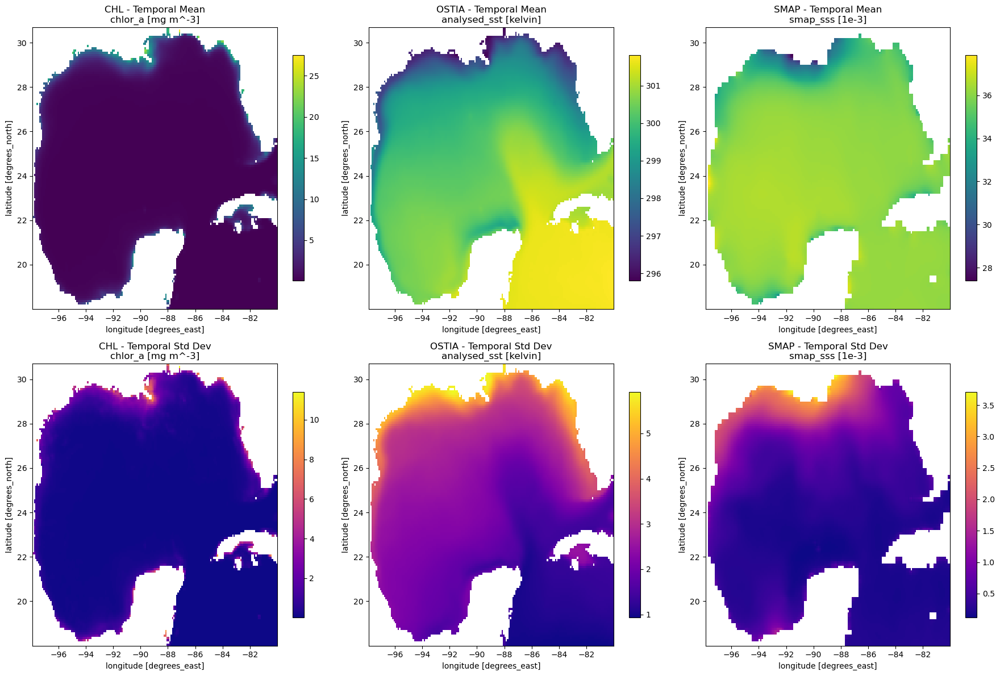

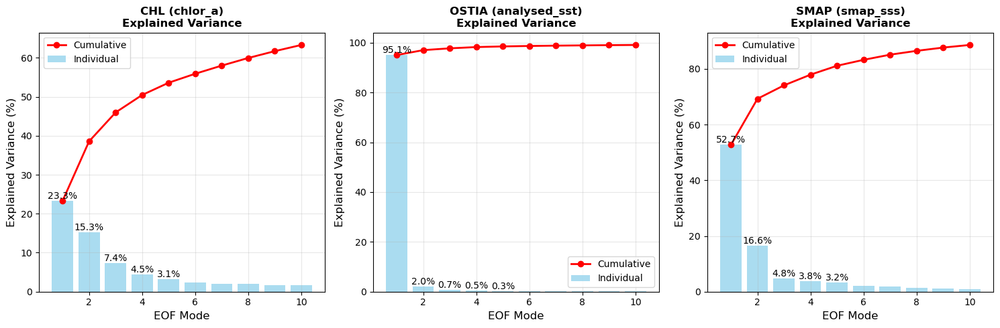


Generating plots for CHL...


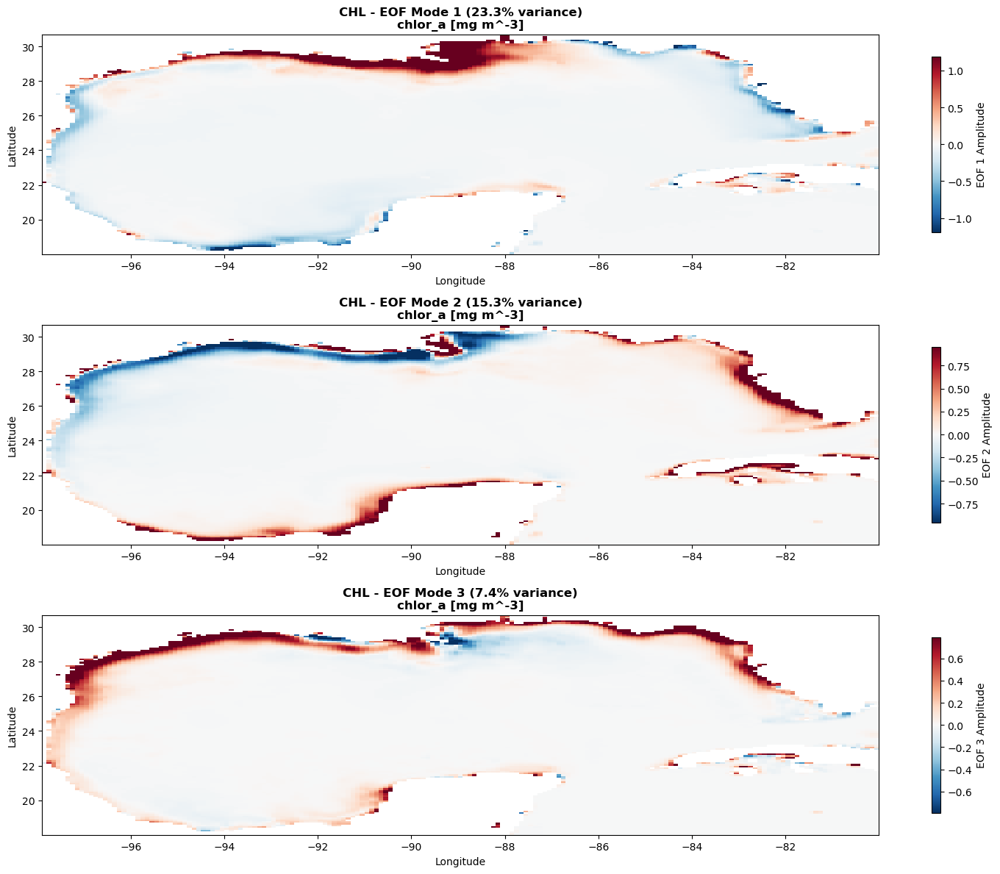

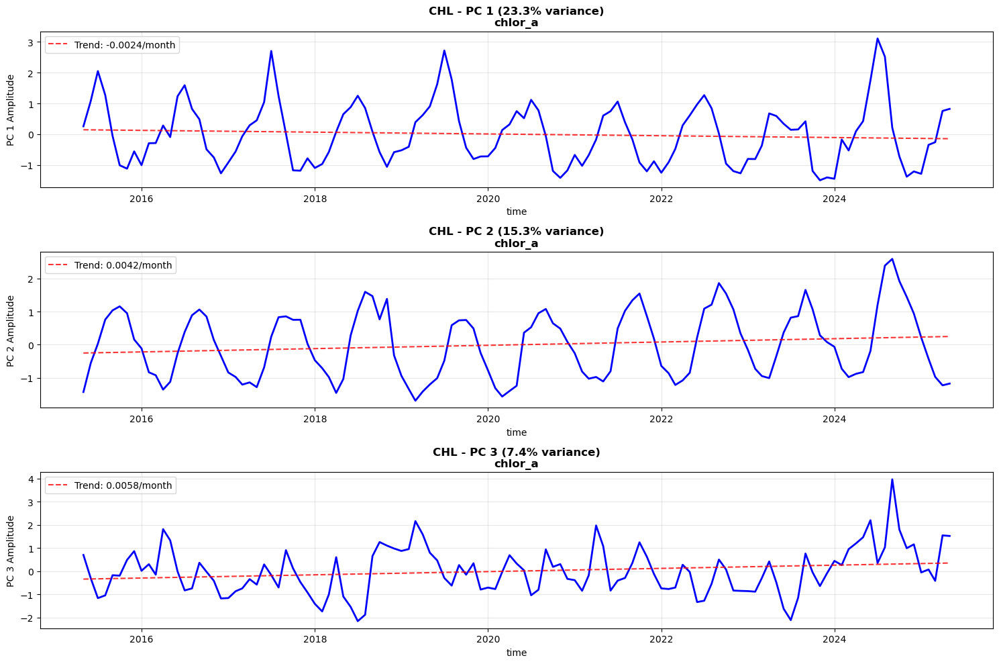


Generating plots for OSTIA...


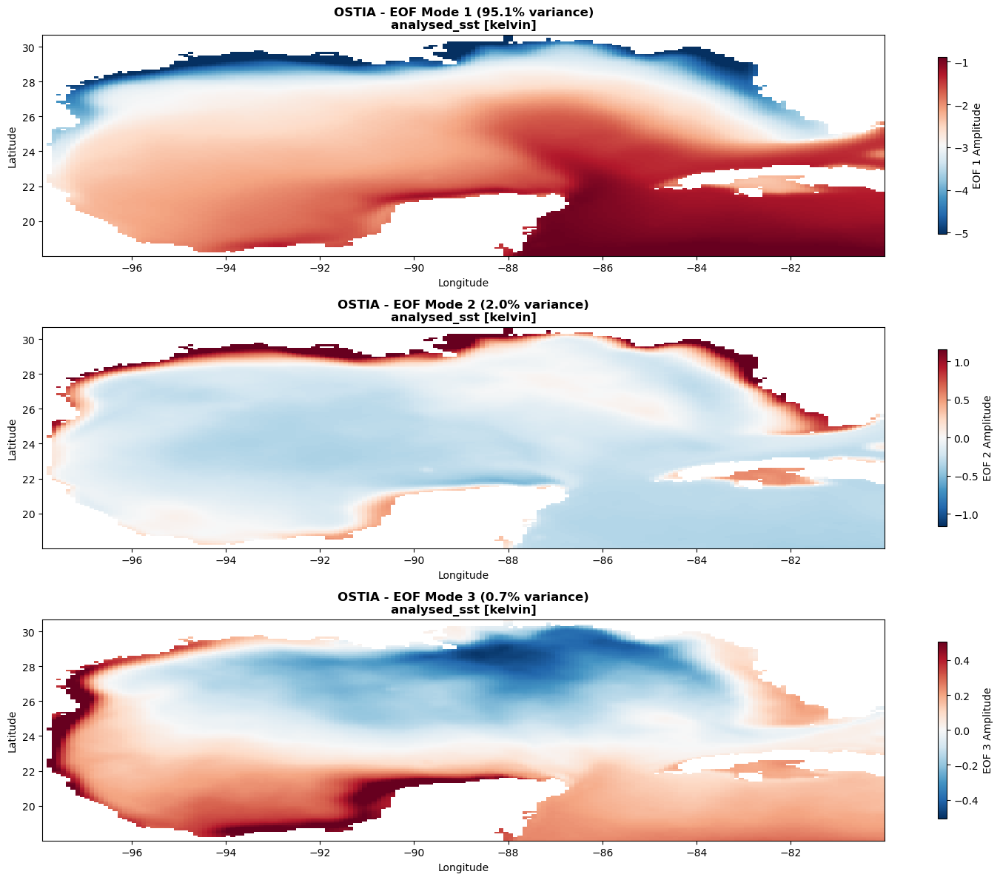

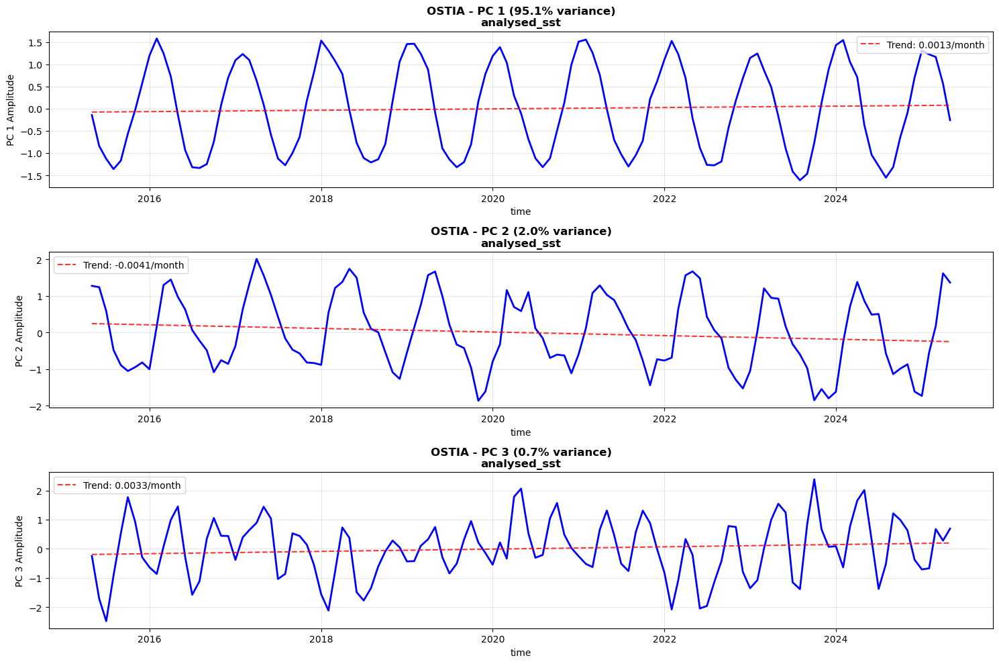


Generating plots for SMAP...


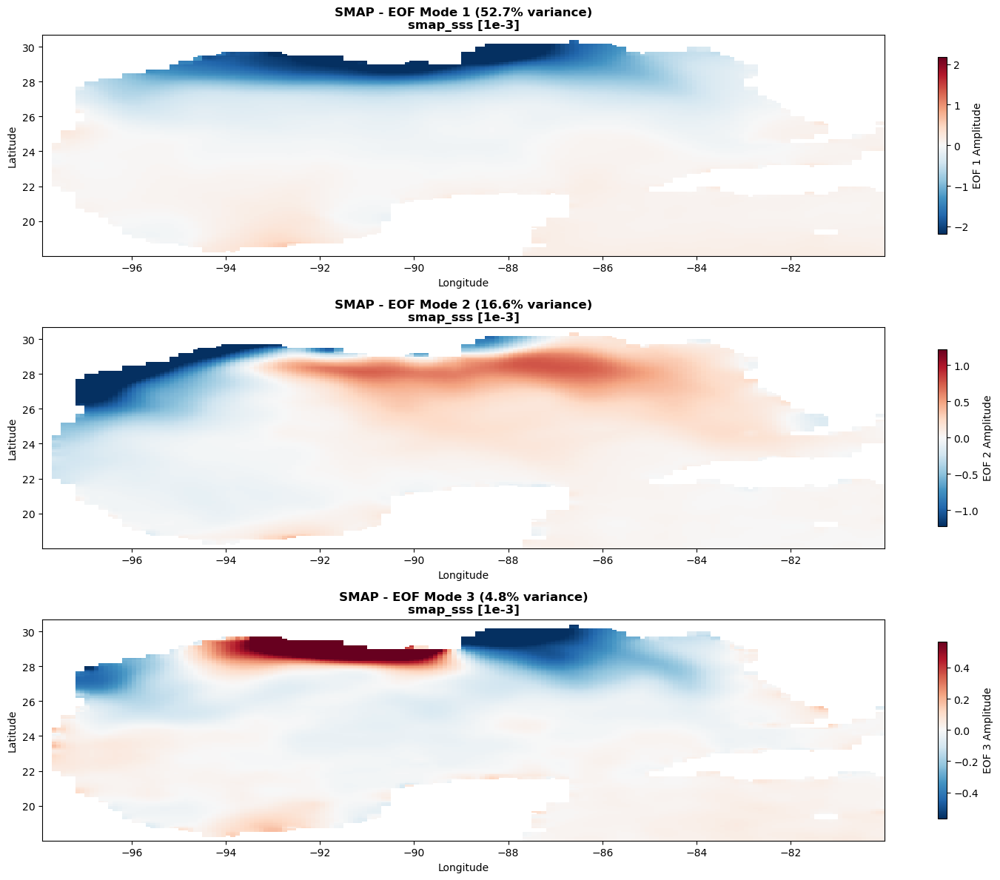

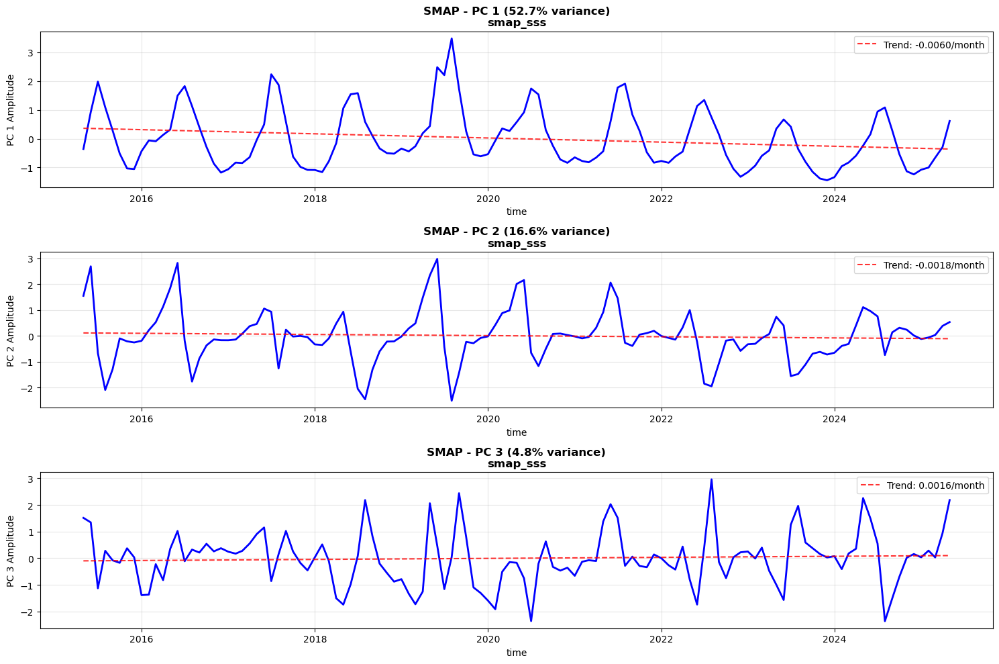


Saving results to 'gulf_eof_results' directory...
CHL results saved
OSTIA results saved
SMAP results saved
Summary statistics saved
All results saved to 'gulf_eof_results' directory

ANALYSIS COMPLETE
Results saved to 'gulf_eof_results' directory
Check output files for detailed results and visualizations


In [4]:
## import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from eofs.xarray import Eof
from eofs.tools.standard import correlation_map, covariance_map
import warnings
warnings.filterwarnings('ignore')

class GulfEOFAnalysis:
    """
    EOF analysis for Gulf region geospatial time series
    Handles chlorophyll (CHL), sea surface temperature (SST), and sea surface salinity (SSS)
    """
    
    def __init__(self, filepaths):
        """
        Initialize with Gulf region netCDF file paths
        
        Parameters:
        -----------
        filepaths : list
            List of netCDF file paths for Gulf region data
        """
        self.filepaths = filepaths
        self.datasets = {}
        self.processed_data = {}
        self.eof_results = {}
        self.missing_data_stats = {}
        
    def load_data(self):
        """Load Gulf region netCDF files and identify variables"""
        print("Loading Gulf region datasets...")
        print("=" * 50)
        
        # Variable mapping for Gulf datasets
        variable_mapping = {
            'CHL': 'chlor_a',
            'OSTIA': 'analysed_sst', 
            'SMAP': 'smap_sss'
        }
        
        for i, filepath in enumerate(self.filepaths):
            try:
                # Load dataset
                ds = xr.open_dataset(filepath, chunks={'StdTime': 50})
                
                # Identify dataset type from filename
                dataset_type = None
                for key in variable_mapping.keys():
                    if key in filepath:
                        dataset_type = key
                        break
                
                if dataset_type is None:
                    print(f"Could not identify dataset type for {filepath}")
                    continue
                    
                var_name = variable_mapping[dataset_type]
                
                if var_name not in ds.data_vars:
                    print(f"Variable {var_name} not found in {filepath}")
                    continue
                
                # Extract data array and standardize coordinates
                data_array = ds[var_name]
                if 'StdTime' in data_array.dims:
                    data_array = data_array.rename({'StdTime': 'time'})
                
                self.datasets[dataset_type] = {
                    'data': data_array,
                    'variable_name': var_name,
                    'filepath': filepath,
                    'units': data_array.attrs.get('units', 'unknown')
                }
                
                print(f"\n{dataset_type} Dataset ({var_name}):")
                filename = filepath.split('\\')[-1]
                print(f"  File: {filename}")
                print(f"  Shape: {data_array.shape}")
                print(f"  Time range: {data_array.time.values[0]} to {data_array.time.values[-1]}")
                print(f"  Spatial extent: {data_array.lat.values.min():.2f}°N - {data_array.lat.values.max():.2f}°N")
                print(f"                  {data_array.lon.values.min():.2f}°E - {data_array.lon.values.max():.2f}°E")
                
                # Calculate missing data statistics
                total_points = data_array.size
                valid_points = (~np.isnan(data_array)).sum().values
                missing_pct = (1 - valid_points/total_points) * 100
                print(f"  Missing data: {missing_pct:.1f}% ({total_points-valid_points:,} / {total_points:,} points)")
                
                self.missing_data_stats[dataset_type] = {
                    'total_points': total_points,
                    'valid_points': valid_points,
                    'missing_percentage': missing_pct
                }
                
            except Exception as e:
                print(f"Error loading {filepath}: {e}")
    
    def analyze_missing_data(self):
        """Analyze spatial patterns of missing data"""
        print("\n" + "=" * 50)
        print("MISSING DATA ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            data = data_info['data']
            print(f"\n{dataset_type} ({data_info['variable_name']}):")
            
            # Calculate missing data percentage for each spatial location
            missing_by_location = np.isnan(data).mean(dim='time') * 100
            
            # Statistics
            locations_over_50pct = (missing_by_location > 50).sum().values
            total_locations = missing_by_location.size
            
            print(f"  Spatial locations with >50% missing: {locations_over_50pct} / {total_locations}")
            print(f"  Percentage of locations to remove: {locations_over_50pct/total_locations*100:.1f}%")
            print(f"  Missing data range: {missing_by_location.min().values:.1f}% - {missing_by_location.max().values:.1f}%")
            print(f"  Mean missing data per location: {missing_by_location.mean().values:.1f}%")
            
            # Store missing data mask
            self.missing_data_stats[dataset_type]['missing_by_location'] = missing_by_location
            self.missing_data_stats[dataset_type]['valid_locations_mask'] = missing_by_location <= 50
    
    def preprocess_data(self):
        """
        Preprocess data:
        1. Remove locations with >50% missing data
        2. Apply seasonal climatological interpolation
        3. Remove temporal mean
        """
        print("\n" + "=" * 50)
        print("DATA PREPROCESSING")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            print(f"\nProcessing {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            # Step 1: Remove locations with >50% missing data
            missing_mask = self.missing_data_stats[dataset_type]['missing_by_location'] > 50
            
            # Apply mask - set these locations to NaN
            data_masked = data.where(~missing_mask)
            
            locations_removed = missing_mask.sum().values
            total_locations = missing_mask.size
            print(f"Removed {locations_removed} locations ({locations_removed/total_locations*100:.1f}%) with >50% missing data")
            
            # Step 2: Seasonal climatological interpolation
            print("Applying seasonal interpolation...")
            data_interpolated = self._seasonal_interpolation(data_masked)
            
            # Check interpolation results
            remaining_nan = np.isnan(data_interpolated).sum().values
            total_points = data_interpolated.size
            print(f"Remaining NaN values after interpolation: {remaining_nan} / {total_points} ({remaining_nan/total_points*100:.3f}%)")
            
            # Step 3: Remove temporal mean (centering)
            print("Removing temporal mean...")
            temporal_mean = data_interpolated.mean(dim='time')
            data_centered = data_interpolated - temporal_mean
            
            # Store processed data
            self.processed_data[dataset_type] = {
                'data': data_centered,
                'temporal_mean': temporal_mean,
                'original_data': data,
                'variable_name': data_info['variable_name'],
                'units': data_info['units']
            }
            
            print(f"Preprocessing complete for {dataset_type}")
    
    def _seasonal_interpolation(self, data):
        """
        Apply seasonal climatological interpolation
        Fill missing values with monthly climatological mean for that location
        """
        # Create monthly climatology (mean for each month across all years)
        monthly_clim = data.groupby('time.month').mean(dim='time')
        
        # Create a function to fill NaN values with climatological values
        def fill_with_climatology(monthly_data, month_clim):
            # Where data is NaN, use climatology
            return monthly_data.fillna(month_clim)
        
        # Apply interpolation month by month
        data_filled = data.copy()
        
        for month in range(1, 13):
            month_mask = data.time.dt.month == month
            if month_mask.any():
                month_data = data.isel(time=month_mask)
                month_clim = monthly_clim.sel(month=month)
                
                # Fill NaN values with climatology for this month
                filled_month = month_data.fillna(month_clim)
                data_filled.loc[dict(time=month_mask)] = filled_month
        
        return data_filled
    
    def perform_eof_analysis(self, n_modes=10):
        """
        Perform EOF analysis on each variable separately
        """
        print("\n" + "=" * 50)
        print("EOF ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.processed_data.items():
            print(f"\nPerforming EOF analysis: {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            try:
                # Create EOF solver with the processed data
                solver = Eof(data, weights=None)
                
                # Compute EOFs and PCs
                eofs = solver.eofs(neofs=n_modes, eofscaling=2)  # Unit variance scaling
                pcs = solver.pcs(npcs=n_modes, pcscaling=1)     # Unit variance scaling
                eigenvalues = solver.eigenvalues(neigs=n_modes)
                variance_fractions = solver.varianceFraction(neigs=n_modes)
                
                # Store results
                self.eof_results[dataset_type] = {
                    'eofs': eofs,
                    'pcs': pcs,
                    'eigenvalues': eigenvalues,
                    'variance_fractions': variance_fractions,
                    'solver': solver,
                    'variable_name': data_info['variable_name'],
                    'units': data_info['units']
                }
                
                # Print results
                print(f"EOF analysis complete")
                print(f"First 5 modes explain: {variance_fractions.values[:5] * 100}")
                print(f"Cumulative variance (first 5): {np.cumsum(variance_fractions.values[:5]) * 100}")
                
            except Exception as e:
                print(f"Error in EOF analysis: {e}")
    
    def cross_correlation_analysis(self):
        """
        Perform cross-correlation analysis between variables
        """
        if len(self.eof_results) < 2:
            print("Need at least 2 variables for cross-correlation analysis")
            return
            
        print("\n" + "=" * 50)
        print("CROSS-CORRELATION ANALYSIS")
        print("=" * 50)
        
        # Define pairs for correlation analysis
        correlation_pairs = []
        dataset_types = list(self.eof_results.keys())
        
        for i, type1 in enumerate(dataset_types):
            for j, type2 in enumerate(dataset_types[i+1:], i+1):
                correlation_pairs.append((type1, type2))
        
        for type1, type2 in correlation_pairs:
            print(f"\n{type1} vs {type2} Correlation Analysis:")
            print("-" * 40)
            
            pcs1 = self.eof_results[type1]['pcs']
            pcs2 = self.eof_results[type2]['pcs']
            eofs1 = self.eof_results[type1]['eofs']
            eofs2 = self.eof_results[type2]['eofs']
            
            # Analyze first 3 modes
            for mode in range(min(3, pcs1.shape[1], pcs2.shape[1])):
                pc1 = pcs1.isel(mode=mode)
                pc2 = pcs2.isel(mode=mode)
                eof1 = eofs1.isel(mode=mode)
                eof2 = eofs2.isel(mode=mode)
                
                # Temporal correlation
                temp_corr = np.corrcoef(pc1.values, pc2.values)[0, 1]
                
                # Spatial correlation (where both have valid data)
                valid_mask = ~(np.isnan(eof1) | np.isnan(eof2))
                if valid_mask.any():
                    eof1_valid = eof1.values[valid_mask]
                    eof2_valid = eof2.values[valid_mask]
                    spatial_corr = np.corrcoef(eof1_valid, eof2_valid)[0, 1]
                else:
                    spatial_corr = np.nan
                
                print(f"  Mode {mode+1}: Temporal r={temp_corr:.3f}, Spatial r={spatial_corr:.3f}")
                
                # Check for significant correlations
                if abs(temp_corr) > 0.5:
                    var1_pct = self.eof_results[type1]['variance_fractions'].values[mode] * 100
                    var2_pct = self.eof_results[type2]['variance_fractions'].values[mode] * 100
                    print(f"    Strong temporal correlation! ({var1_pct:.1f}% & {var2_pct:.1f}% variance)")
    
    def plot_explained_variance(self, figsize=(15, 5)):
        """Plot explained variance for all EOF analyses"""
        n_datasets = len(self.eof_results)
        if n_datasets == 0:
            print("No EOF results to plot")
            return
            
        fig, axes = plt.subplots(1, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = [axes]
        
        for i, (dataset_type, results) in enumerate(self.eof_results.items()):
            ax = axes[i]
            
            variance_fractions = results['variance_fractions'].values * 100
            cumulative_variance = np.cumsum(variance_fractions)
            
            # Plot individual and cumulative variance
            bars = ax.bar(range(1, len(variance_fractions) + 1), variance_fractions, 
                         alpha=0.7, label='Individual', color='skyblue')
            line = ax.plot(range(1, len(variance_fractions) + 1), cumulative_variance, 
                          'ro-', label='Cumulative', linewidth=2, markersize=6)
            
            # Formatting
            ax.set_xlabel('EOF Mode', fontsize=12)
            ax.set_ylabel('Explained Variance (%)', fontsize=12)
            var_name = results['variable_name']
            ax.set_title(f'{dataset_type} ({var_name})\nExplained Variance', fontsize=12, weight='bold')
            ax.legend()
            ax.grid(True, alpha=0.3)
            
            # Add percentage labels on bars for first few modes
            for j, bar in enumerate(bars[:5]):
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2., height,
                       f'{height:.1f}%', ha='center', va='bottom', fontsize=10)
        
        plt.tight_layout()
        plt.show()
    
    def plot_spatial_patterns(self, dataset_type, modes=[0, 1, 2], figsize=(15, 12)):
        """Plot EOF spatial patterns"""
        if dataset_type not in self.eof_results:
            print(f"Dataset {dataset_type} not found in EOF results")
            return
        
        results = self.eof_results[dataset_type]
        eofs = results['eofs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= eofs.shape[0]:
                continue
            
            ax = axes[i]
            
            # Get EOF spatial pattern
            eof_data = eofs.isel(mode=mode)
            
            # Plot with appropriate colormap
            im = eof_data.plot(ax=ax, cmap='RdBu_r', add_colorbar=False, robust=True)
            
            # Add title with variance percentage
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            units = results['units']
            
            ax.set_title(f'{dataset_type} - EOF Mode {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name} [{units}]', fontsize=12, weight='bold')
            
            # Formatting
            ax.set_xlabel('Longitude', fontsize=10)
            ax.set_ylabel('Latitude', fontsize=10)
            
            # Add colorbar
            cbar = plt.colorbar(im, ax=ax, shrink=0.8)
            cbar.set_label(f'EOF {mode+1} Amplitude', fontsize=10)
        
        plt.tight_layout()
        plt.show()
    
    def plot_principal_components(self, dataset_type, modes=[0, 1, 2], figsize=(15, 10)):
        """Plot principal components time series"""
        if dataset_type not in self.eof_results:
            print(f"Dataset {dataset_type} not found in EOF results")
            return
        
        results = self.eof_results[dataset_type]
        pcs = results['pcs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= pcs.shape[1]:
                continue
            
            ax = axes[i]
            
            # Plot PC time series
            pc_data = pcs.isel(mode=mode)
            pc_data.plot(ax=ax, linewidth=2, color='blue')
            
            # Add variance info
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            
            ax.set_title(f'{dataset_type} - PC {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name}', fontsize=12, weight='bold')
            ax.set_ylabel(f'PC {mode + 1} Amplitude', fontsize=10)
            ax.grid(True, alpha=0.3)
            
            # Add trend line
            time_numeric = np.arange(len(pc_data))
            trend_coef = np.polyfit(time_numeric, pc_data.values, 1)
            trend_line = np.polyval(trend_coef, time_numeric)
            ax.plot(pc_data.time, trend_line, 'r--', alpha=0.8, 
                   label=f'Trend: {trend_coef[0]:.4f}/month')
            ax.legend()
        
        plt.tight_layout()
        plt.show()
    
    def plot_data_overview(self, figsize=(18, 12)):
        """Plot overview of all datasets and their temporal means"""
        n_datasets = len(self.processed_data)
        if n_datasets == 0:
            print("No processed data to plot")
            return
            
        fig, axes = plt.subplots(2, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = axes.reshape(2, 1)
        
        for i, (dataset_type, data_info) in enumerate(self.processed_data.items()):
            # Plot temporal mean
            ax_mean = axes[0, i]
            temporal_mean = data_info['temporal_mean']
            im1 = temporal_mean.plot(ax=ax_mean, cmap='viridis', add_colorbar=False)
            ax_mean.set_title(f'{dataset_type} - Temporal Mean\n{data_info["variable_name"]} [{data_info["units"]}]')
            plt.colorbar(im1, ax=ax_mean, shrink=0.8)
            
            # Plot standard deviation
            ax_std = axes[1, i]
            temporal_std = data_info['data'].std(dim='time')
            im2 = temporal_std.plot(ax=ax_std, cmap='plasma', add_colorbar=False)
            ax_std.set_title(f'{dataset_type} - Temporal Std Dev\n{data_info["variable_name"]} [{data_info["units"]}]')
            plt.colorbar(im2, ax=ax_std, shrink=0.8)
        
        plt.tight_layout()
        plt.show()
    
    def save_results(self, output_dir="gulf_eof_results"):
        """Save EOF results to files"""
        import os
        
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)
        
        print(f"\nSaving results to '{output_dir}' directory...")
        
        for dataset_type, results in self.eof_results.items():
            # Save principal components
            pcs_df = results['pcs'].to_pandas()
            pcs_df.columns = [f'PC_{i+1}' for i in range(pcs_df.shape[1])]
            pcs_df.to_csv(f"{output_dir}/{dataset_type}_principal_components.csv")
            
            # Save explained variance
            variance_fractions = results['variance_fractions'].values
            var_df = pd.DataFrame({
                'Mode': range(1, len(variance_fractions) + 1),
                'Explained_Variance_Fraction': variance_fractions,
                'Explained_Variance_Percent': variance_fractions * 100,
                'Cumulative_Variance_Percent': np.cumsum(variance_fractions) * 100
            })
            var_df.to_csv(f"{output_dir}/{dataset_type}_explained_variance.csv", index=False)
            
            # Save EOFs as NetCDF
            results['eofs'].to_netcdf(f"{output_dir}/{dataset_type}_eofs.nc")
            
            print(f"{dataset_type} results saved")
        
        # Save summary statistics
        summary_stats = []
        for dataset_type, results in self.eof_results.items():
            var_fractions = results['variance_fractions'].values * 100
            summary_stats.append({
                'Dataset': dataset_type,
                'Variable': results['variable_name'],
                'Mode1_Variance': var_fractions[0],
                'Mode2_Variance': var_fractions[1],
                'Mode3_Variance': var_fractions[2],
                'Top3_Cumulative': var_fractions[:3].sum(),
                'Total_Modes': len(var_fractions)
            })
        
        summary_df = pd.DataFrame(summary_stats)
        summary_df.to_csv(f"{output_dir}/summary_statistics.csv", index=False)
        
        print(f"Summary statistics saved")
        print(f"All results saved to '{output_dir}' directory")

# Example usage and main execution
if __name__ == "__main__":
    # Gulf region file paths
    filepaths = [
        r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4", 
        r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
    ]
    
    print("Gulf Region EOF Analysis")
    print("=" * 60)
    print("Datasets: CHL (Chlorophyll), OSTIA (SST), SMAP (SSS)")
    print("Time period: May 2015 - May 2025 (121 monthly time steps)")
    print("Study region: Gulf of Mexico")
    print()
    
    # Initialize analysis
    eof_analysis = GulfEOFAnalysis(filepaths)
    
    # Step 1: Load data
    eof_analysis.load_data()
    
    # Step 2: Analyze missing data patterns
    eof_analysis.analyze_missing_data()
    
    # Step 3: Preprocess data (remove locations with >50% missing, interpolate, center)
    eof_analysis.preprocess_data()
    
    # Step 4: Perform EOF analysis
    eof_analysis.perform_eof_analysis(n_modes=10)
    
    # Step 5: Cross-correlation analysis
    eof_analysis.cross_correlation_analysis()
    
    # Step 6: Generate visualizations
    print("\n" + "=" * 50)
    print("GENERATING VISUALIZATIONS")
    print("=" * 50)
    
    # Data overview
    eof_analysis.plot_data_overview()
    
    # Explained variance plots
    eof_analysis.plot_explained_variance()
    
    # Spatial patterns and time series for each dataset
    for dataset_type in eof_analysis.eof_results.keys():
        print(f"\nGenerating plots for {dataset_type}...")
        eof_analysis.plot_spatial_patterns(dataset_type, modes=[0, 1, 2])
        eof_analysis.plot_principal_components(dataset_type, modes=[0, 1, 2])
    
    # Step 7: Save results
    eof_analysis.save_results()
    
    print("\n" + "=" * 50)
    print("ANALYSIS COMPLETE")
    print("=" * 50)
    print("Results saved to 'gulf_eof_results' directory")
    print("Check output files for detailed results and visualizations")

Gulf Region CYCLOSTATIONARY EOF Analysis
Method: Kim & North (1997) CSEOF
Decomposes fields into slow modulations of phase-locked annual cycles
Each mode has 12 different spatial patterns (one per month)
Time period: May 2015 - May 2025 (121 monthly time steps)
Study region: Gulf of Mexico

Loading Gulf region datasets...

CHL Dataset (chlor_a):
  File: CHL_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.5% (673,903 / 2,750,693 points)

OSTIA Dataset (analysed_sst):
  File: OSTIA_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.7% (679,899 / 2,750,693 points)

SMAP Dataset (smap_sss):
  File: SMAP_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:0

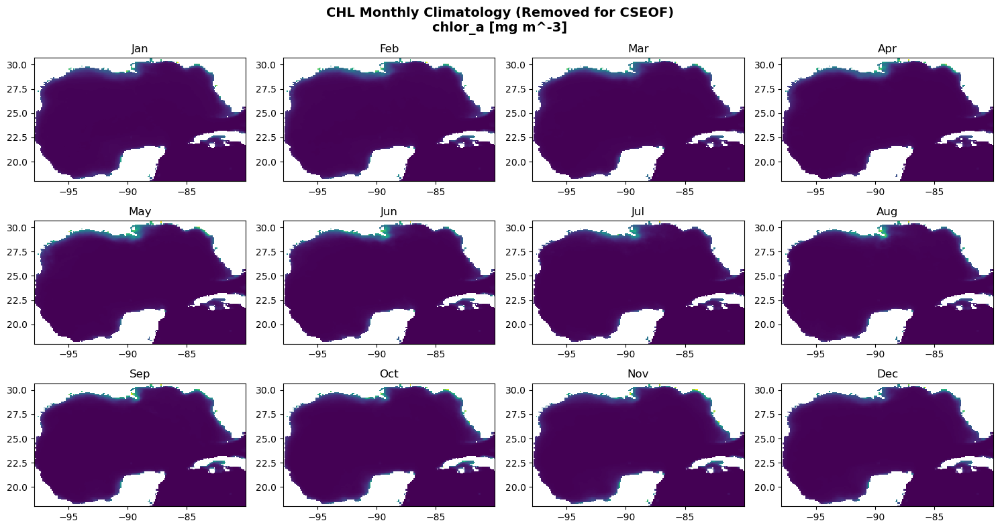

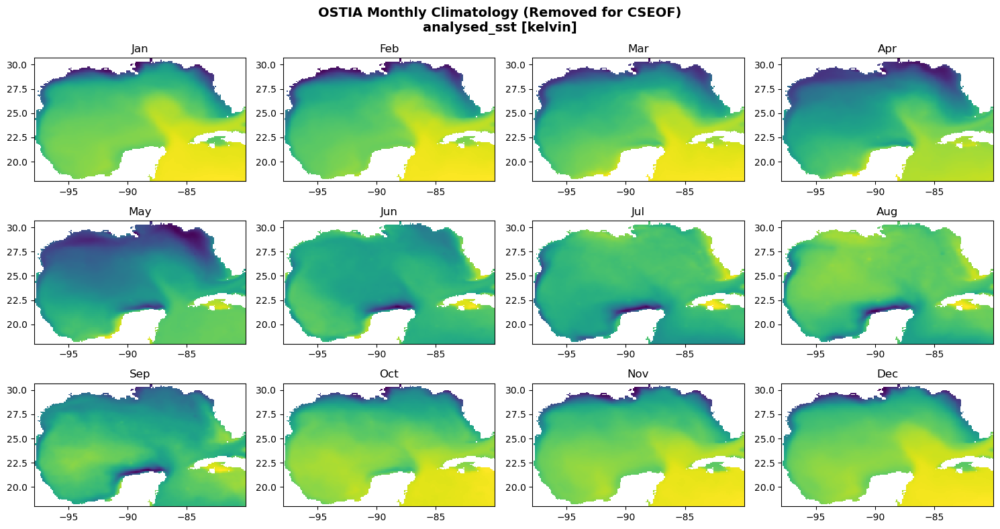

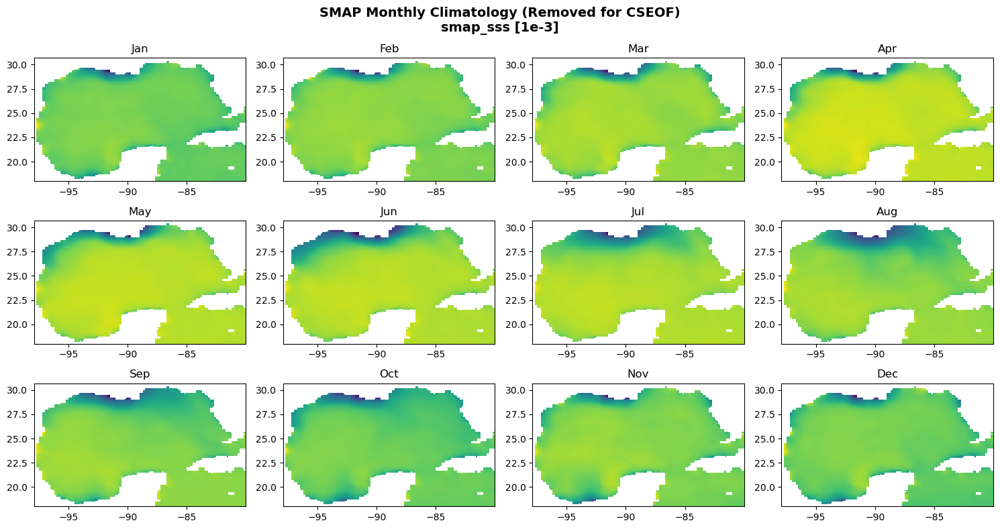

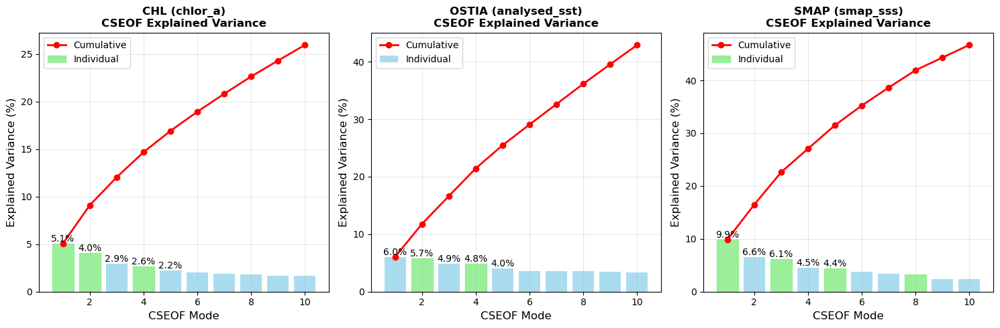


Generating CSEOF plots for CHL...


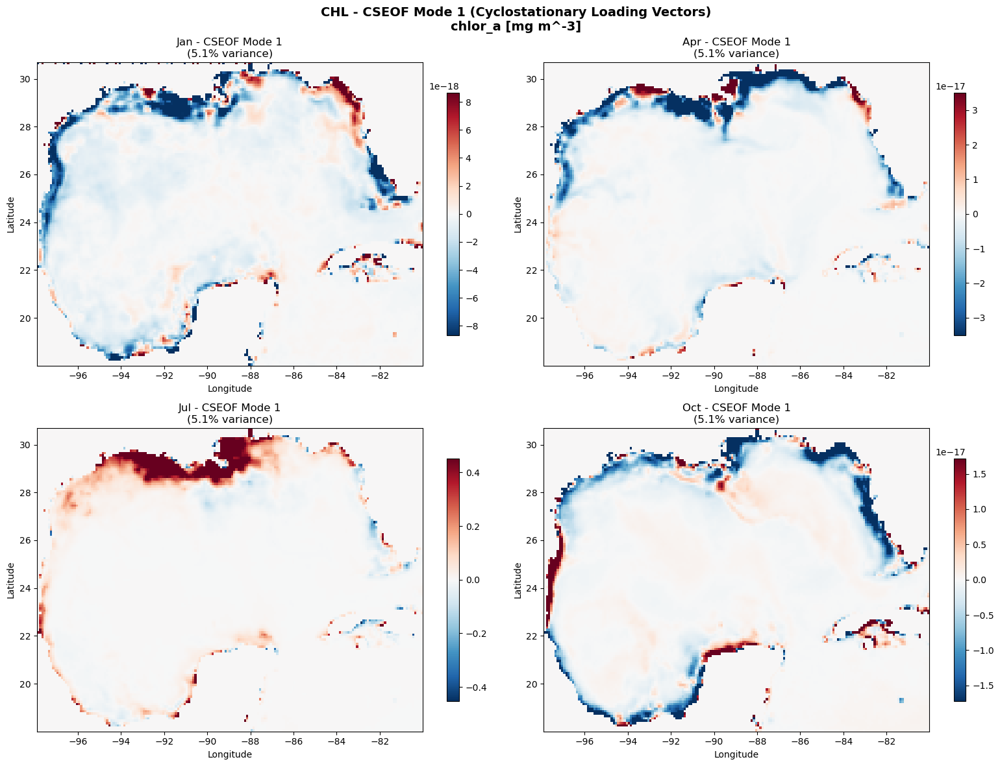

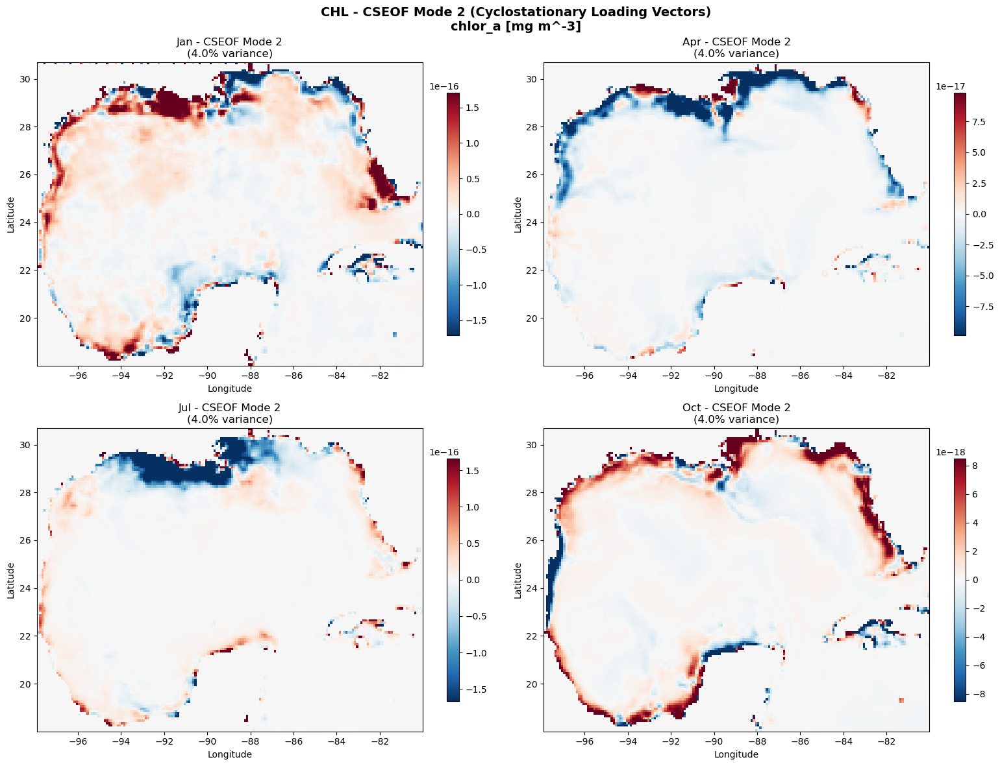

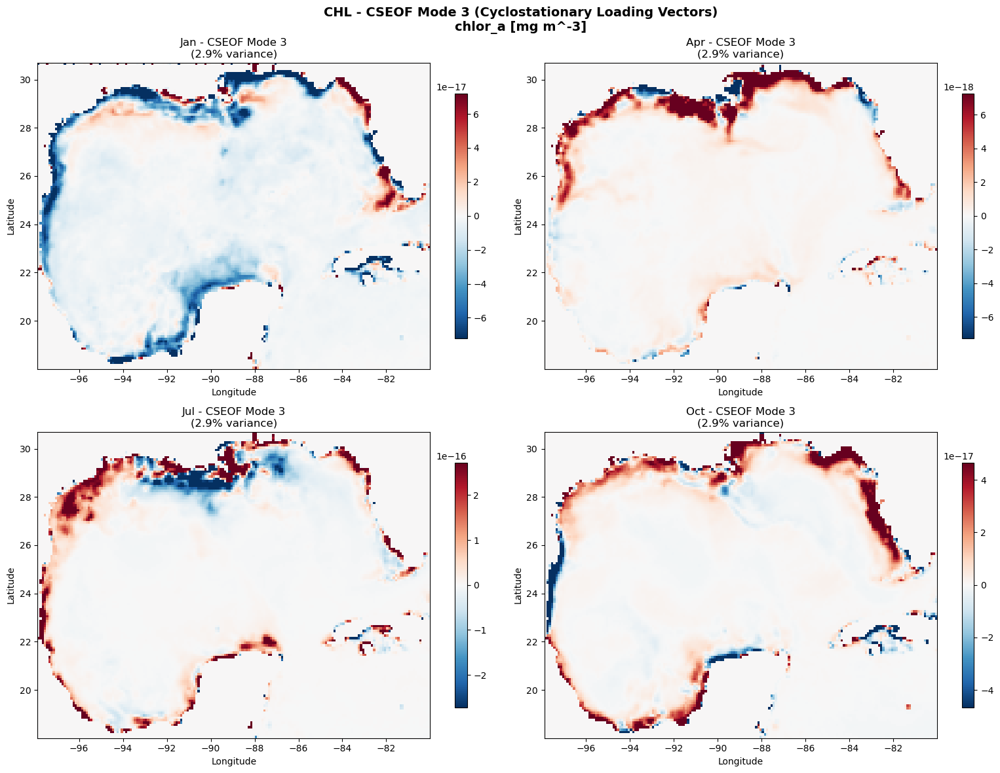

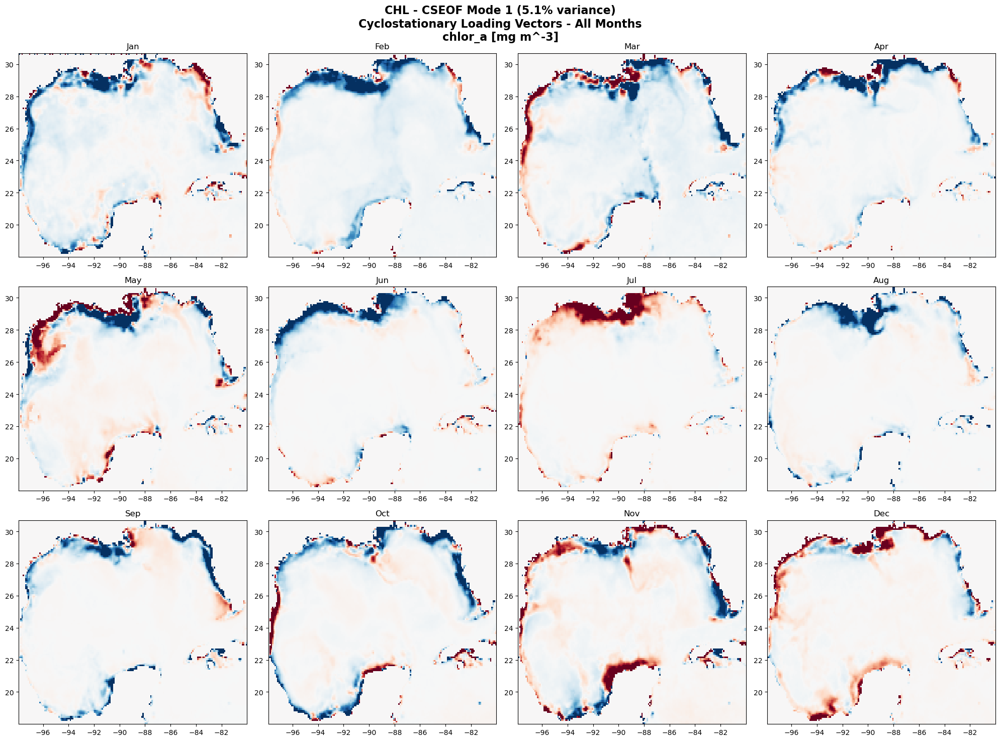

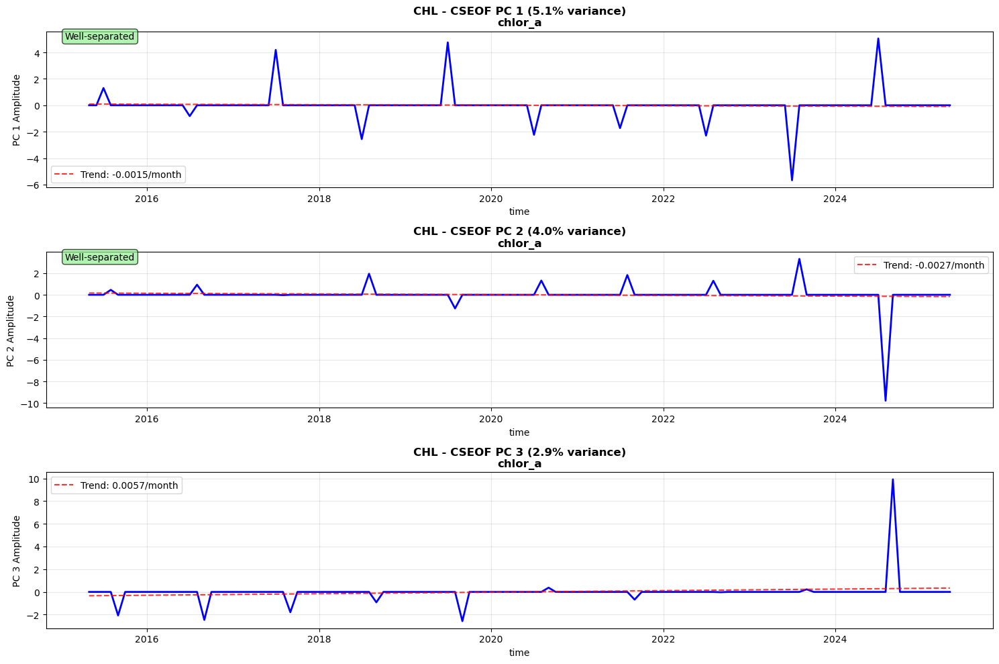


Generating CSEOF plots for OSTIA...


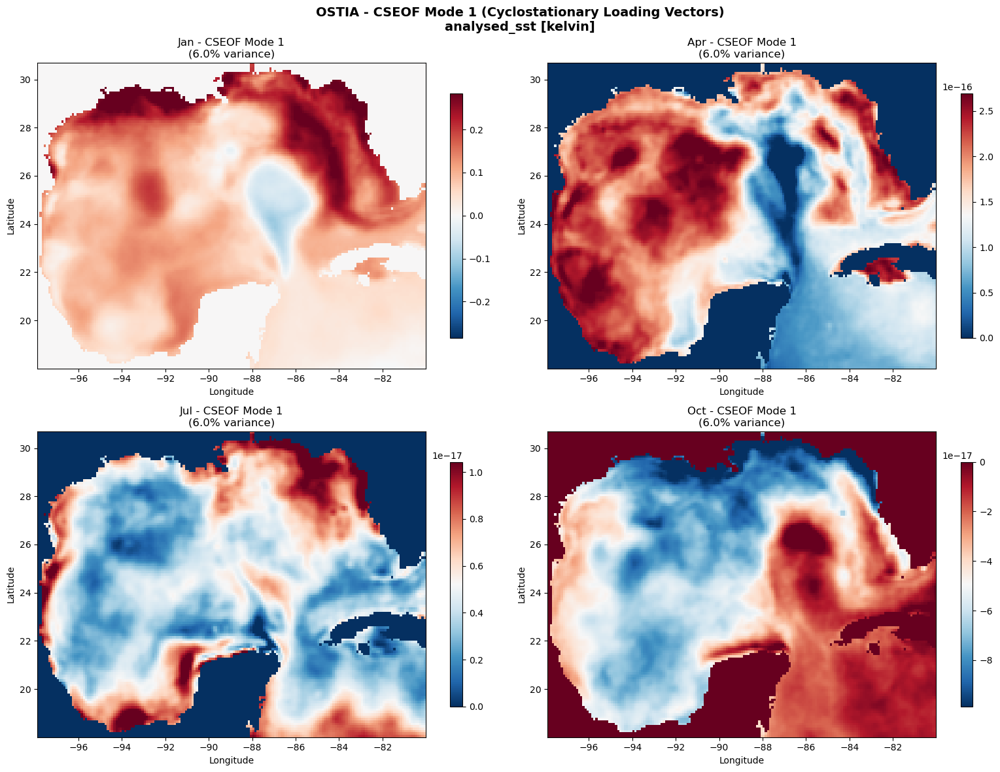

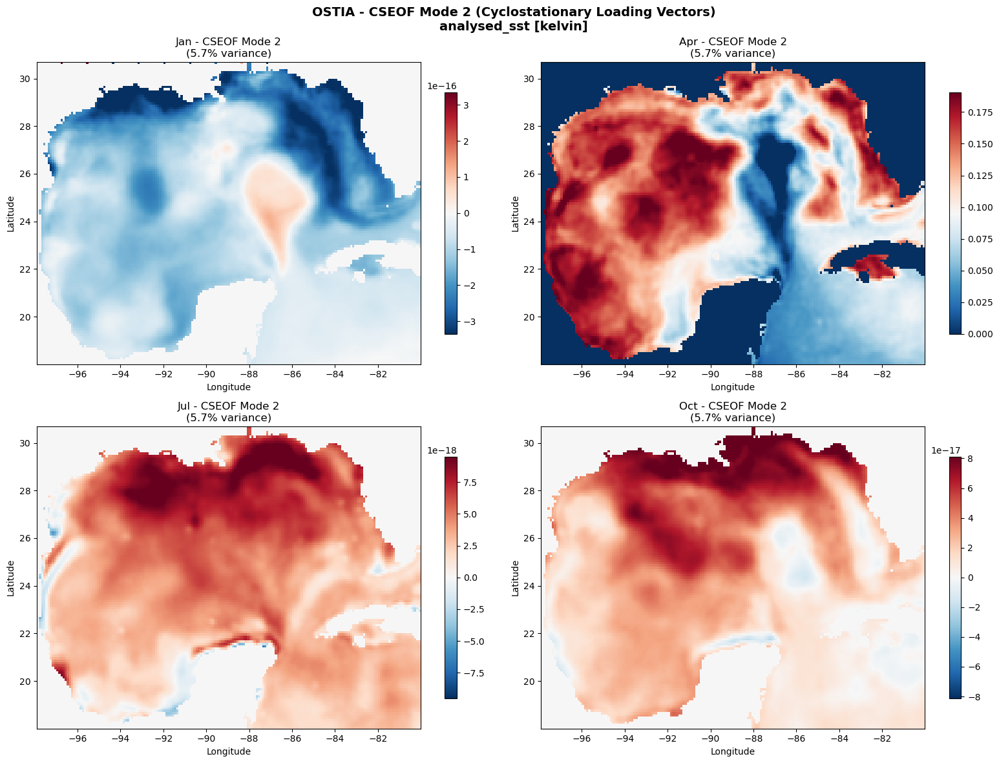

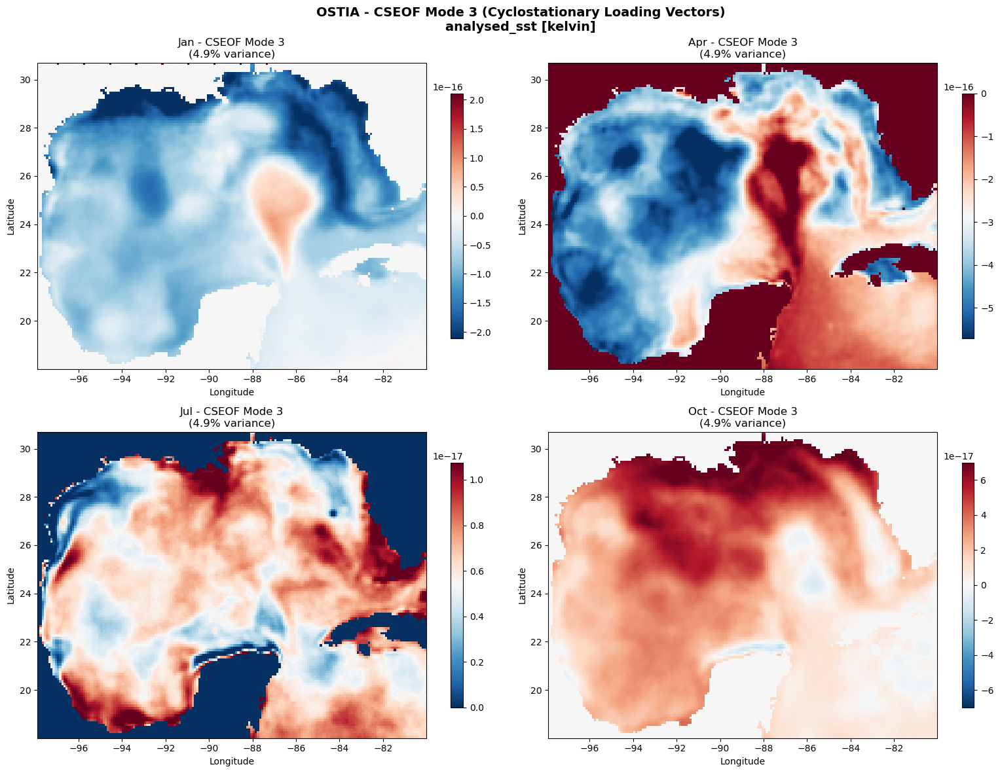

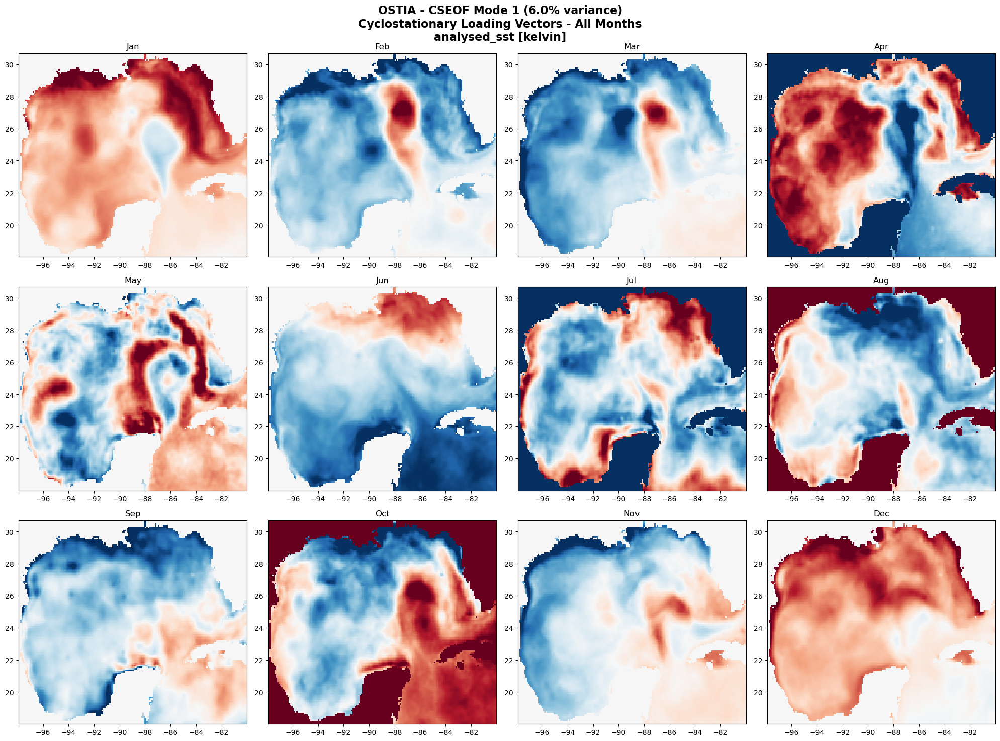

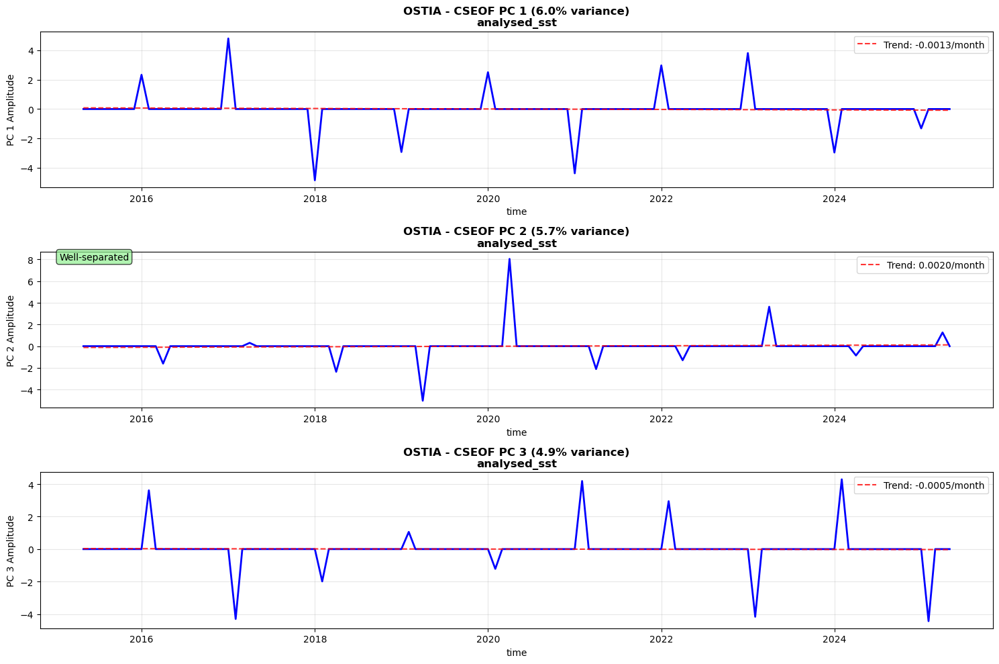


Generating CSEOF plots for SMAP...


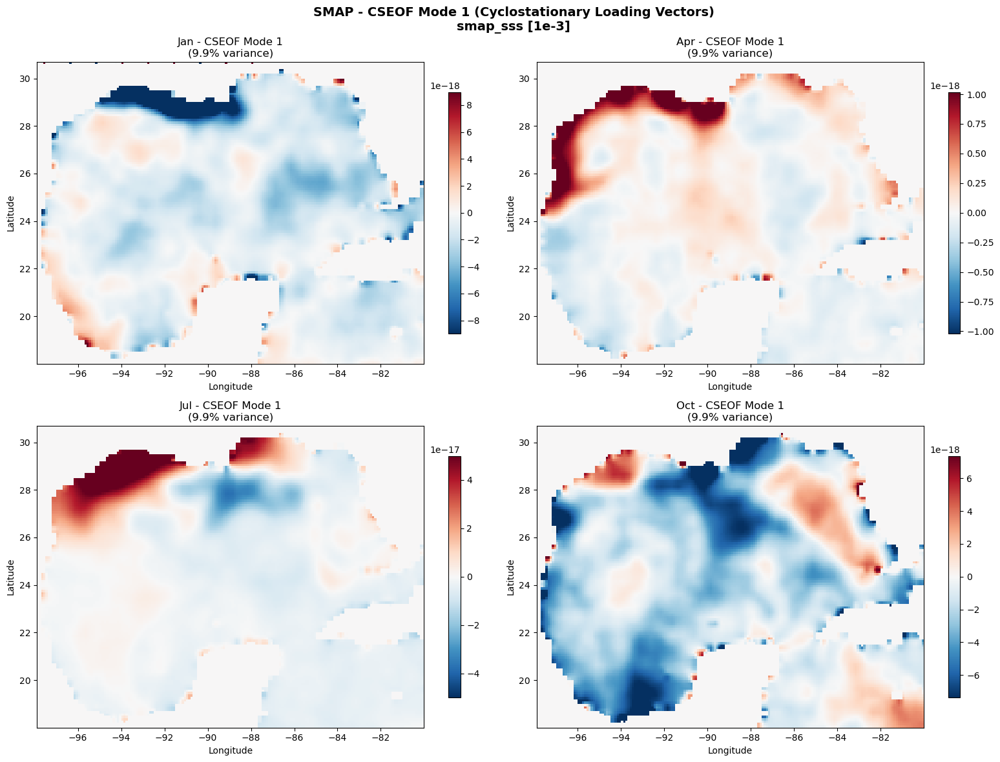

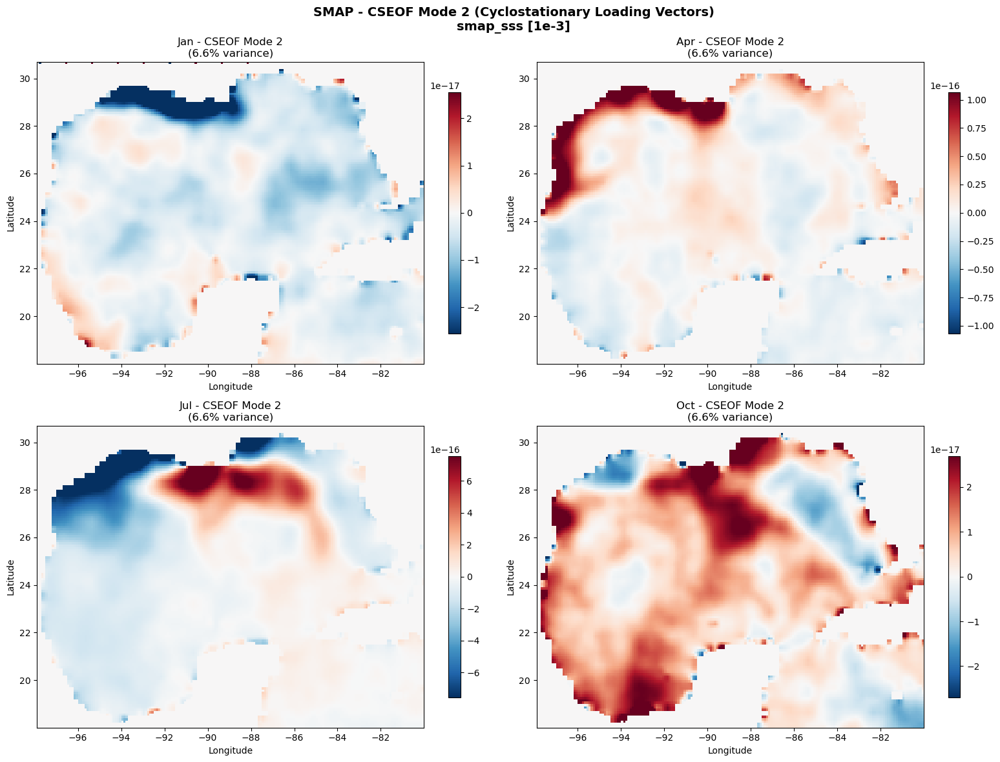

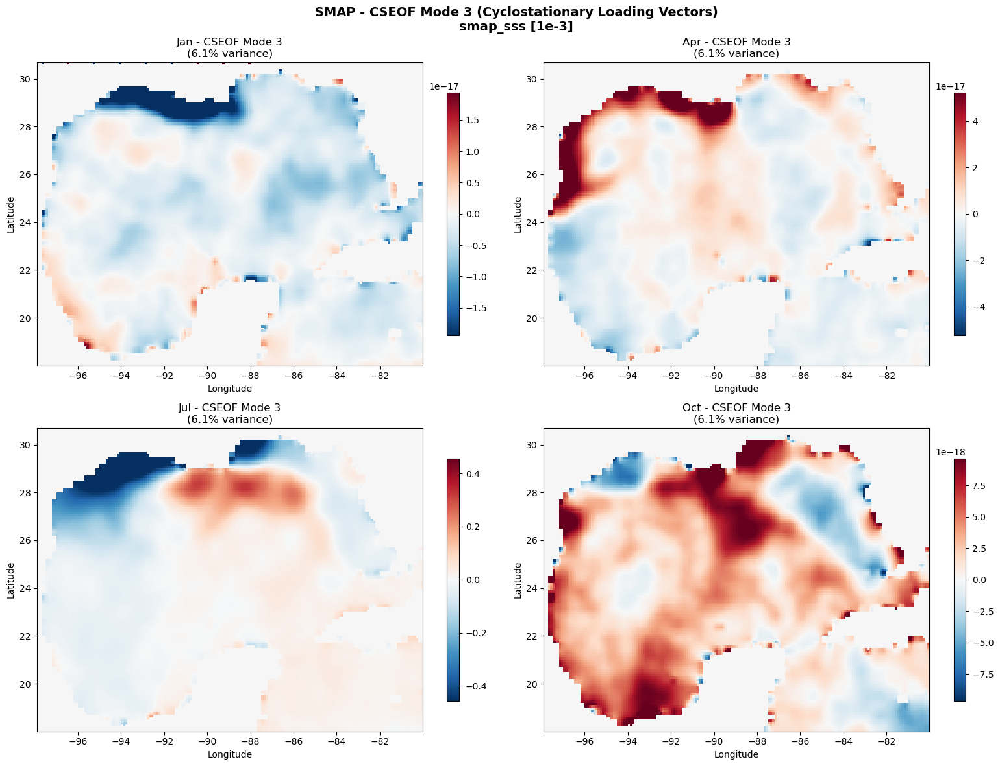

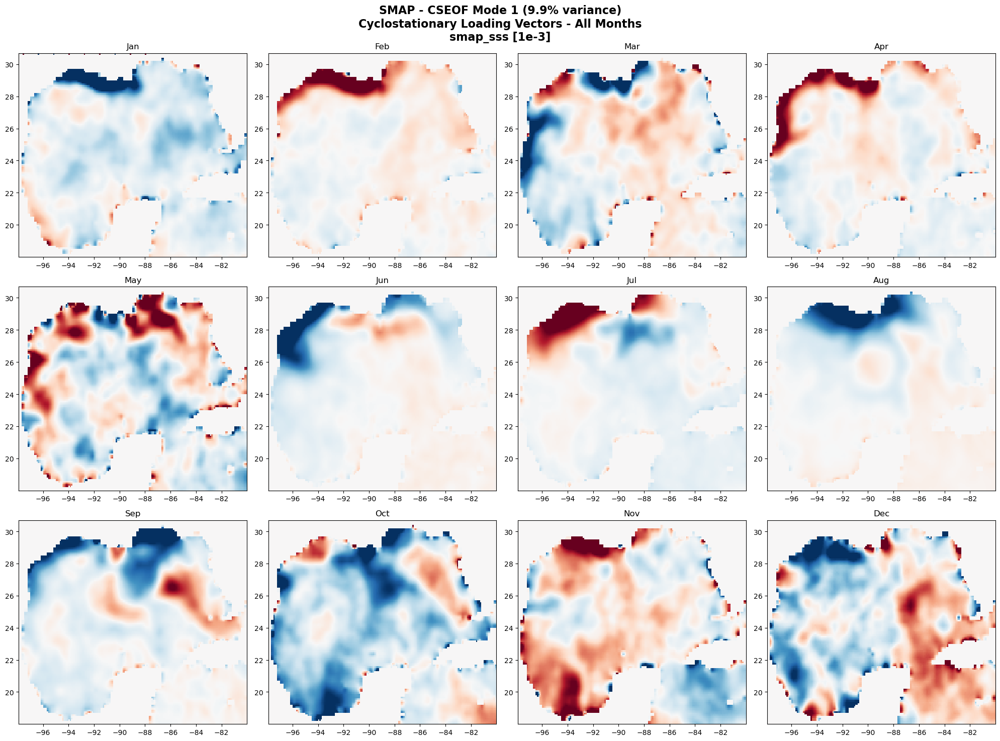

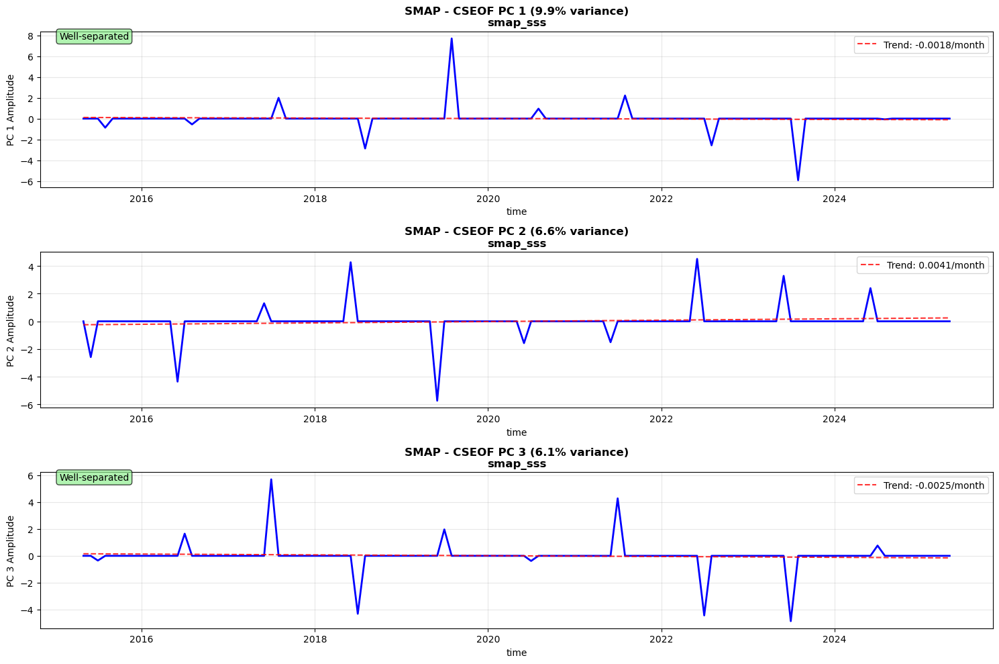


CSEOF ANALYSIS COMPLETE
Results show how spatial patterns evolve throughout the year
Each mode captures seasonally-dependent variability patterns


In [3]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from eofs.xarray import Eof
from eofs.tools.standard import correlation_map, covariance_map
import warnings
warnings.filterwarnings('ignore')

class GulfCyclostationaryEOF:
    """
    Cyclostationary EOF analysis for Gulf region geospatial time series
    Following Kim & North (1997) methodology - decomposes fields into 
    slow modulations of phase-locked annual cycles
    """
    
    def __init__(self, filepaths):
        """
        Initialize with Gulf region netCDF file paths
        
        Parameters:
        -----------
        filepaths : list
            List of netCDF file paths for Gulf region data
        """
        self.filepaths = filepaths
        self.datasets = {}
        self.processed_data = {}
        self.cseof_results = {}
        self.missing_data_stats = {}
        
    def load_data(self):
        """Load Gulf region netCDF files and identify variables"""
        print("Loading Gulf region datasets...")
        print("=" * 50)
        
        # Variable mapping for Gulf datasets
        variable_mapping = {
            'CHL': 'chlor_a',
            'OSTIA': 'analysed_sst', 
            'SMAP': 'smap_sss'
        }
        
        for i, filepath in enumerate(self.filepaths):
            try:
                # Load dataset
                ds = xr.open_dataset(filepath, chunks={'StdTime': 50})
                
                # Identify dataset type from filename
                dataset_type = None
                for key in variable_mapping.keys():
                    if key in filepath:
                        dataset_type = key
                        break
                
                if dataset_type is None:
                    print(f"Could not identify dataset type for {filepath}")
                    continue
                    
                var_name = variable_mapping[dataset_type]
                
                if var_name not in ds.data_vars:
                    print(f"Variable {var_name} not found in {filepath}")
                    continue
                
                # Extract data array and standardize coordinates
                data_array = ds[var_name]
                if 'StdTime' in data_array.dims:
                    data_array = data_array.rename({'StdTime': 'time'})
                
                self.datasets[dataset_type] = {
                    'data': data_array,
                    'variable_name': var_name,
                    'filepath': filepath,
                    'units': data_array.attrs.get('units', 'unknown')
                }
                
                print(f"\n{dataset_type} Dataset ({var_name}):")
                filename = filepath.split('\\')[-1]
                print(f"  File: {filename}")
                print(f"  Shape: {data_array.shape}")
                print(f"  Time range: {data_array.time.values[0]} to {data_array.time.values[-1]}")
                print(f"  Spatial extent: {data_array.lat.values.min():.2f}°N - {data_array.lat.values.max():.2f}°N")
                print(f"                  {data_array.lon.values.min():.2f}°E - {data_array.lon.values.max():.2f}°E")
                
                # Calculate missing data statistics
                total_points = data_array.size
                valid_points = (~np.isnan(data_array)).sum().values
                missing_pct = (1 - valid_points/total_points) * 100
                print(f"  Missing data: {missing_pct:.1f}% ({total_points-valid_points:,} / {total_points:,} points)")
                
                self.missing_data_stats[dataset_type] = {
                    'total_points': total_points,
                    'valid_points': valid_points,
                    'missing_percentage': missing_pct
                }
                
            except Exception as e:
                print(f"Error loading {filepath}: {e}")
    
    def analyze_missing_data(self):
        """Analyze spatial patterns of missing data"""
        print("\n" + "=" * 50)
        print("MISSING DATA ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            data = data_info['data']
            print(f"\n{dataset_type} ({data_info['variable_name']}):")
            
            # Calculate missing data percentage for each spatial location
            missing_by_location = np.isnan(data).mean(dim='time') * 100
            
            # Statistics
            locations_over_50pct = (missing_by_location > 50).sum().values
            total_locations = missing_by_location.size
            
            print(f"  Spatial locations with >50% missing: {locations_over_50pct} / {total_locations}")
            print(f"  Percentage of locations to remove: {locations_over_50pct/total_locations*100:.1f}%")
            print(f"  Missing data range: {missing_by_location.min().values:.1f}% - {missing_by_location.max().values:.1f}%")
            print(f"  Mean missing data per location: {missing_by_location.mean().values:.1f}%")
            
            # Store missing data mask
            self.missing_data_stats[dataset_type]['missing_by_location'] = missing_by_location
            self.missing_data_stats[dataset_type]['valid_locations_mask'] = missing_by_location <= 50
    
    def preprocess_data(self):
        """
        Preprocess data for CSEOF:
        1. Remove locations with >50% missing data
        2. Apply seasonal climatological interpolation
        3. Remove climatological mean for each month separately
        4. Apply area weighting
        """
        print("\n" + "=" * 50)
        print("CSEOF DATA PREPROCESSING")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            print(f"\nProcessing {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            # Step 1: Remove locations with >50% missing data
            missing_mask = self.missing_data_stats[dataset_type]['missing_by_location'] > 50
            data_masked = data.where(~missing_mask)
            
            locations_removed = missing_mask.sum().values
            total_locations = missing_mask.size
            print(f"Removed {locations_removed} locations ({locations_removed/total_locations*100:.1f}%) with >50% missing data")
            
            # Step 2: Seasonal climatological interpolation
            print("Applying seasonal interpolation...")
            data_interpolated = self._seasonal_interpolation(data_masked)
            
            # Step 3: Remove climatological mean for each month (as per paper methodology)
            print("Removing monthly climatological mean...")
            monthly_climatology = data_interpolated.groupby('time.month').mean(dim='time')
            data_anomalies = data_interpolated.groupby('time.month') - monthly_climatology
            
            # Step 4: Apply area weighting (as mentioned in the paper)
            print("Applying area weighting...")
            lat_weights = np.sqrt(np.cos(np.deg2rad(data_anomalies.lat)))
            data_weighted = data_anomalies * lat_weights
            
            # Store processed data
            self.processed_data[dataset_type] = {
                'data': data_weighted,
                'data_anomalies': data_anomalies,
                'monthly_climatology': monthly_climatology,
                'original_data': data,
                'variable_name': data_info['variable_name'],
                'units': data_info['units'],
                'lat_weights': lat_weights
            }
            
            print(f"CSEOF preprocessing complete for {dataset_type}")
    
    def _seasonal_interpolation(self, data):
        """Apply seasonal climatological interpolation"""
        # Create monthly climatology (mean for each month across all years)
        monthly_clim = data.groupby('time.month').mean(dim='time')
        
        # Apply interpolation month by month
        data_filled = data.copy()
        
        for month in range(1, 13):
            month_mask = data.time.dt.month == month
            if month_mask.any():
                month_data = data.isel(time=month_mask)
                month_clim = monthly_clim.sel(month=month)
                
                # Fill NaN values with climatology for this month
                filled_month = month_data.fillna(month_clim)
                data_filled.loc[dict(time=month_mask)] = filled_month
        
        return data_filled
    
    def create_cseof_matrix(self, dataset_type):
        """
        Create CSEOF data matrix following Kim & North (1997) methodology
        Arrange data as [12*space, time] matrix where each month gets separate spatial rows
        """
        print(f"\nCreating CSEOF data matrix for {dataset_type}...")
        
        data = self.processed_data[dataset_type]['data']
        
        # Get dimensions
        n_time = data.shape[0]
        n_lat = data.shape[1] 
        n_lon = data.shape[2]
        n_space = n_lat * n_lon
        
        # Create the CSEOF matrix: [12*space, time]
        # Each month gets its own set of spatial rows
        cseof_matrix = np.zeros((12 * n_space, n_time))
        
        # Fill the matrix
        for t in range(n_time):
            month_idx = data.time.dt.month.values[t] - 1  # Convert to 0-based indexing
            
            # Get spatial data for this time step
            spatial_data = data.isel(time=t).values.flatten()
            
            # Put data in the rows corresponding to this month
            start_row = month_idx * n_space
            end_row = (month_idx + 1) * n_space
            cseof_matrix[start_row:end_row, t] = spatial_data
        
        # Handle NaN values
        cseof_matrix = np.nan_to_num(cseof_matrix, nan=0.0)
        
        print(f"CSEOF matrix shape: {cseof_matrix.shape}")
        print(f"Original data shape: {data.shape}")
        print(f"Matrix structure: 12 months × {n_space} spatial points = {12 * n_space} rows")
        
        return cseof_matrix, (n_lat, n_lon)
    
    def perform_cseof_analysis(self, n_modes=10):
        """
        Perform Cyclostationary EOF analysis following Kim & North (1997)
        """
        print("\n" + "=" * 50)
        print("CYCLOSTATIONARY EOF ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.processed_data.items():
            print(f"\nPerforming CSEOF analysis: {dataset_type} ({data_info['variable_name']})...")
            
            # Create CSEOF data matrix
            cseof_matrix, spatial_shape = self.create_cseof_matrix(dataset_type)
            
            # Convert to xarray for EOF analysis
            time_coord = data_info['data'].time
            space_coord = np.arange(cseof_matrix.shape[0])
            
            cseof_xr = xr.DataArray(
                cseof_matrix.T,  # Transpose to [time, space*12] for eofs package
                dims=['time', 'space'],
                coords={'time': time_coord, 'space': space_coord}
            )
            
            try:
                # Create EOF solver
                solver = Eof(cseof_xr, weights=None)
                
                # Compute EOFs and PCs
                eofs = solver.eofs(neofs=n_modes, eofscaling=2)
                pcs = solver.pcs(npcs=n_modes, pcscaling=1)
                eigenvalues = solver.eigenvalues(neigs=n_modes)
                variance_fractions = solver.varianceFraction(neigs=n_modes)
                
                # Store results
                self.cseof_results[dataset_type] = {
                    'eofs': eofs,
                    'pcs': pcs,
                    'eigenvalues': eigenvalues,
                    'variance_fractions': variance_fractions,
                    'solver': solver,
                    'spatial_shape': spatial_shape,  # (n_lat, n_lon)
                    'cseof_matrix': cseof_matrix,
                    'variable_name': data_info['variable_name'],
                    'units': data_info['units'],
                    'lat_weights': data_info['lat_weights']
                }
                
                print(f"CSEOF analysis complete")
                print(f"First 5 modes explain: {variance_fractions.values[:5] * 100}")
                print(f"Cumulative variance (first 5): {np.cumsum(variance_fractions.values[:5]) * 100}")
                
                # Apply North's criterion for mode significance
                self._apply_north_criterion(dataset_type)
                
            except Exception as e:
                print(f"Error in CSEOF analysis: {e}")
    
    def _apply_north_criterion(self, dataset_type):
        """Apply North's criterion to test mode separation"""
        results = self.cseof_results[dataset_type]
        eigenvalues = results['eigenvalues'].values
        n_samples = len(results['pcs'].time)
        
        # Calculate North's criterion: delta_lambda = lambda * sqrt(2/N)
        delta_lambda = eigenvalues * np.sqrt(2 / n_samples)
        
        # Test for well-separated modes
        well_separated = []
        for i in range(len(eigenvalues) - 1):
            separation = eigenvalues[i] - eigenvalues[i + 1]
            criterion = delta_lambda[i]
            well_separated.append(separation > criterion)
        
        results['north_criterion'] = delta_lambda
        results['well_separated'] = well_separated
        
        n_separated = sum(well_separated) + 1  # +1 because we compare adjacent pairs
        print(f"North's criterion: First {n_separated} modes are statistically well-separated")
    
    def extract_monthly_pattern(self, dataset_type, mode, month):
        """
        Extract the spatial pattern for a specific mode and month
        This is the Cyclostationary Loading Vector (CSLV) for that month
        """
        if dataset_type not in self.cseof_results:
            return None
            
        results = self.cseof_results[dataset_type]
        eof_vector = results['eofs'].isel(mode=mode).values
        n_lat, n_lon = results['spatial_shape']
        n_space = n_lat * n_lon
        
        # Extract the pattern for the specified month (0-based indexing)
        month_idx = month - 1
        start_idx = month_idx * n_space
        end_idx = (month_idx + 1) * n_space
        
        month_pattern = eof_vector[start_idx:end_idx].reshape(n_lat, n_lon)
        
        # Remove area weighting for visualization
        lat_weights = results['lat_weights']
        # Broadcast lat_weights to match the 2D pattern shape
        lat_weights_2d = np.broadcast_to(lat_weights.values[:, np.newaxis], month_pattern.shape)
        month_pattern = month_pattern / lat_weights_2d
        
        # Create xarray with proper coordinates
        original_data = self.processed_data[dataset_type]['data']
        
        spatial_pattern = xr.DataArray(
            month_pattern,
            dims=['lat', 'lon'],
            coords={'lat': original_data.lat, 'lon': original_data.lon}
        )
        
        return spatial_pattern
    
    def plot_cseof_mode(self, dataset_type, mode=0, months=[1, 4, 7, 10], figsize=(16, 12)):
        """
        Plot CSEOF mode patterns for different months (Cyclostationary Loading Vectors)
        """
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        n_months = len(months)
        
        fig, axes = plt.subplots(2, 2, figsize=figsize)
        axes = axes.flatten()
        
        month_names = ['', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        for i, month in enumerate(months):
            ax = axes[i]
            
            # Extract CSLV for this month
            spatial_pattern = self.extract_monthly_pattern(dataset_type, mode, month)
            
            if spatial_pattern is not None:
                im = spatial_pattern.plot(ax=ax, cmap='RdBu_r', add_colorbar=False, robust=True)
                
                # Add title
                variance_pct = results['variance_fractions'].values[mode] * 100
                ax.set_title(f'{month_names[month]} - CSEOF Mode {mode+1}\n({variance_pct:.1f}% variance)')
                
                # Add colorbar
                plt.colorbar(im, ax=ax, shrink=0.8)
            
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')
        
        plt.suptitle(f'{dataset_type} - CSEOF Mode {mode+1} (Cyclostationary Loading Vectors)\n'
                    f'{results["variable_name"]} [{results["units"]}]', 
                    fontsize=14, weight='bold')
        plt.tight_layout()
        plt.show()
    
    def plot_all_monthly_patterns(self, dataset_type, mode=0, figsize=(20, 15)):
        """
        Plot all 12 monthly patterns for a CSEOF mode
        """
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        for month in range(1, 13):
            ax = axes[month-1]
            
            # Extract CSLV for this month
            spatial_pattern = self.extract_monthly_pattern(dataset_type, mode, month)
            
            if spatial_pattern is not None:
                im = spatial_pattern.plot(ax=ax, cmap='RdBu_r', add_colorbar=False, robust=True)
                ax.set_title(f'{month_names[month-1]}')
                
            ax.set_xlabel('')
            ax.set_ylabel('')
        
        # Add overall title and colorbar
        variance_pct = results['variance_fractions'].values[mode] * 100
        plt.suptitle(f'{dataset_type} - CSEOF Mode {mode+1} ({variance_pct:.1f}% variance)\n'
                    f'Cyclostationary Loading Vectors - All Months\n'
                    f'{results["variable_name"]} [{results["units"]}]', 
                    fontsize=16, weight='bold')
        
        # Add a common colorbar
        plt.tight_layout()
        plt.show()
    
    def plot_principal_components(self, dataset_type, modes=[0, 1, 2], figsize=(15, 10)):
        """Plot principal components time series"""
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        pcs = results['pcs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= pcs.shape[1]:
                continue
            
            ax = axes[i]
            
            # Plot PC time series
            pc_data = pcs.isel(mode=mode)
            pc_data.plot(ax=ax, linewidth=2, color='blue')
            
            # Add variance info
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            
            ax.set_title(f'{dataset_type} - CSEOF PC {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name}', fontsize=12, weight='bold')
            ax.set_ylabel(f'PC {mode + 1} Amplitude', fontsize=10)
            ax.grid(True, alpha=0.3)
            
            # Add trend line
            time_numeric = np.arange(len(pc_data))
            trend_coef = np.polyfit(time_numeric, pc_data.values, 1)
            trend_line = np.polyval(trend_coef, time_numeric)
            ax.plot(pc_data.time, trend_line, 'r--', alpha=0.8, 
                   label=f'Trend: {trend_coef[0]:.4f}/month')
            ax.legend()
            
            # Mark well-separated modes
            if mode < len(results['well_separated']) and results['well_separated'][mode]:
                ax.text(0.02, 0.95, 'Well-separated', transform=ax.transAxes, 
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgreen", alpha=0.7))
        
        plt.tight_layout()
        plt.show()
    
    def plot_explained_variance(self, figsize=(15, 5)):
        """Plot explained variance for CSEOF analysis"""
        n_datasets = len(self.cseof_results)
        if n_datasets == 0:
            print("No CSEOF results to plot")
            return
            
        fig, axes = plt.subplots(1, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = [axes]
        
        for i, (dataset_type, results) in enumerate(self.cseof_results.items()):
            ax = axes[i]
            
            variance_fractions = results['variance_fractions'].values * 100
            cumulative_variance = np.cumsum(variance_fractions)
            
            # Plot individual and cumulative variance
            bars = ax.bar(range(1, len(variance_fractions) + 1), variance_fractions, 
                         alpha=0.7, label='Individual', color='skyblue')
            line = ax.plot(range(1, len(variance_fractions) + 1), cumulative_variance, 
                          'ro-', label='Cumulative', linewidth=2, markersize=6)
            
            # Highlight well-separated modes
            well_separated = results.get('well_separated', [])
            for j in range(min(len(well_separated), len(bars))):
                if well_separated[j]:
                    bars[j].set_color('lightgreen')
                    bars[j].set_alpha(0.9)
            
            # Formatting
            ax.set_xlabel('CSEOF Mode', fontsize=12)
            ax.set_ylabel('Explained Variance (%)', fontsize=12)
            var_name = results['variable_name']
            ax.set_title(f'{dataset_type} ({var_name})\nCSEOF Explained Variance', fontsize=12, weight='bold')
            ax.legend()
            ax.grid(True, alpha=0.3)
            
            # Add percentage labels on bars for first few modes
            for j, bar in enumerate(bars[:5]):
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2., height,
                       f'{height:.1f}%', ha='center', va='bottom', fontsize=10)
        
        plt.tight_layout()
        plt.show()
    
    def plot_monthly_climatology(self, dataset_type, figsize=(15, 8)):
        """Plot monthly climatology that was removed during preprocessing"""
        if dataset_type not in self.processed_data:
            print(f"Dataset {dataset_type} not found")
            return
            
        data_info = self.processed_data[dataset_type]
        monthly_clim = data_info['monthly_climatology']
        
        # Create subplot for each month
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        for i, month in enumerate(range(1, 13)):
            ax = axes[i]
            clim_data = monthly_clim.sel(month=month)
            
            im = clim_data.plot(ax=ax, cmap='viridis', add_colorbar=False)
            ax.set_title(f'{months[i]}')
            ax.set_xlabel('')
            ax.set_ylabel('')
            
        plt.suptitle(f'{dataset_type} Monthly Climatology (Removed for CSEOF)\n{data_info["variable_name"]} [{data_info["units"]}]', 
                    fontsize=14, weight='bold')
        plt.tight_layout()
        plt.show()

# Example usage
if __name__ == "__main__":
    # Gulf region file paths
    filepaths = [
        r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4", 
        r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
    ]
    
    print("Gulf Region CYCLOSTATIONARY EOF Analysis")
    print("=" * 60)
    print("Method: Kim & North (1997) CSEOF")
    print("Decomposes fields into slow modulations of phase-locked annual cycles")
    print("Each mode has 12 different spatial patterns (one per month)")
    print("Time period: May 2015 - May 2025 (121 monthly time steps)")
    print("Study region: Gulf of Mexico")
    print()
    
    # Initialize analysis
    cseof_analysis = GulfCyclostationaryEOF(filepaths)
    
    # Step 1: Load data
    cseof_analysis.load_data()
    
    # Step 2: Analyze missing data patterns
    cseof_analysis.analyze_missing_data()
    
    # Step 3: Preprocess data for CSEOF
    cseof_analysis.preprocess_data()
    
    # Step 4: Perform CSEOF analysis
    cseof_analysis.perform_cseof_analysis(n_modes=10)
    
    # Step 5: Generate visualizations
    print("\n" + "=" * 50)
    print("GENERATING CSEOF VISUALIZATIONS")
    print("=" * 50)
    
    # Show monthly climatology that was removed
    for dataset_type in cseof_analysis.processed_data.keys():
        cseof_analysis.plot_monthly_climatology(dataset_type)
    
    # Explained variance plots
    cseof_analysis.plot_explained_variance()
    
    # CSEOF modes and principal components
    for dataset_type in cseof_analysis.cseof_results.keys():
        print(f"\nGenerating CSEOF plots for {dataset_type}...")
        
        # Plot first 3 modes with seasonal patterns
        cseof_analysis.plot_cseof_mode(dataset_type, mode=0, months=[1, 4, 7, 10])
        cseof_analysis.plot_cseof_mode(dataset_type, mode=1, months=[1, 4, 7, 10])
        cseof_analysis.plot_cseof_mode(dataset_type, mode=2, months=[1, 4, 7, 10])
        
        # Plot all 12 months for first mode
        cseof_analysis.plot_all_monthly_patterns(dataset_type, mode=0)
        
        # Plot principal components
        cseof_analysis.plot_principal_components(dataset_type, modes=[0, 1, 2])
    
    print("\n" + "=" * 50)
    print("CSEOF ANALYSIS COMPLETE")
    print("=" * 50)
    print("Results show how spatial patterns evolve throughout the year")
    print("Each mode captures seasonally-dependent variability patterns")

Gulf Region CYCLOSTATIONARY EOF Analysis
Method: Kim & North (1997) CSEOF
Decomposes fields into slow modulations of phase-locked annual cycles
Each mode has 12 different spatial patterns (one per month)
Time period: May 2015 - May 2025 (121 monthly time steps)
Study region: Gulf of Mexico

Loading Gulf region datasets...

CHL Dataset (chlor_a):
  File: CHL_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.5% (673,903 / 2,750,693 points)

OSTIA Dataset (analysed_sst):
  File: OSTIA_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.7% (679,899 / 2,750,693 points)

SMAP Dataset (smap_sss):
  File: SMAP_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:0

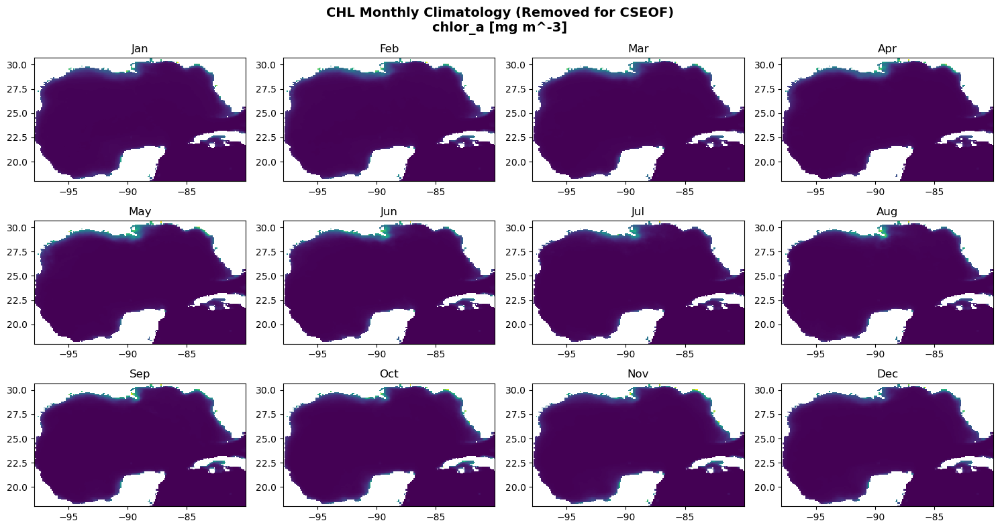

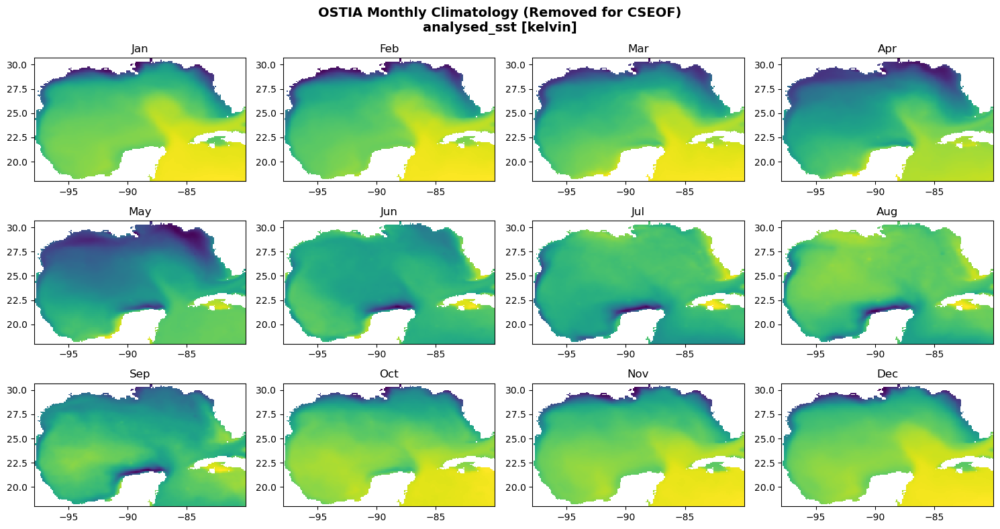

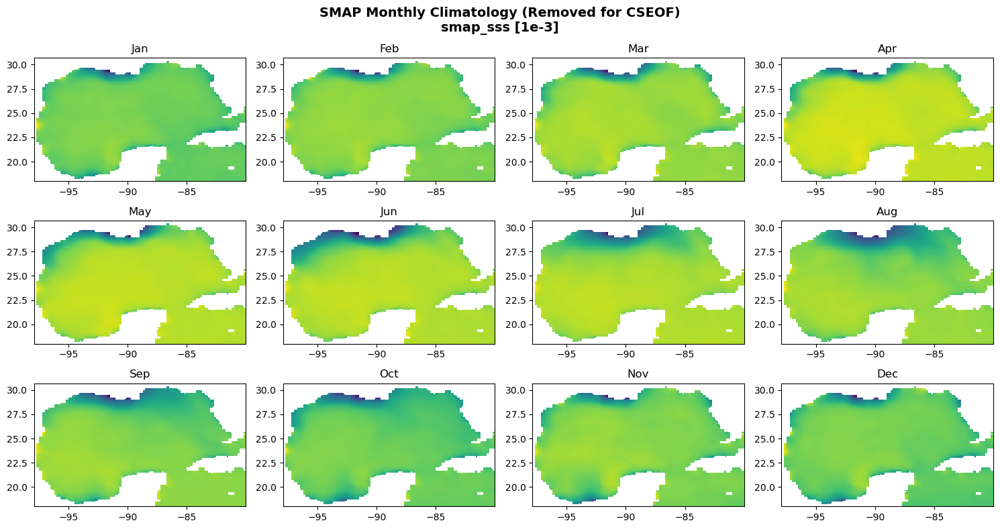

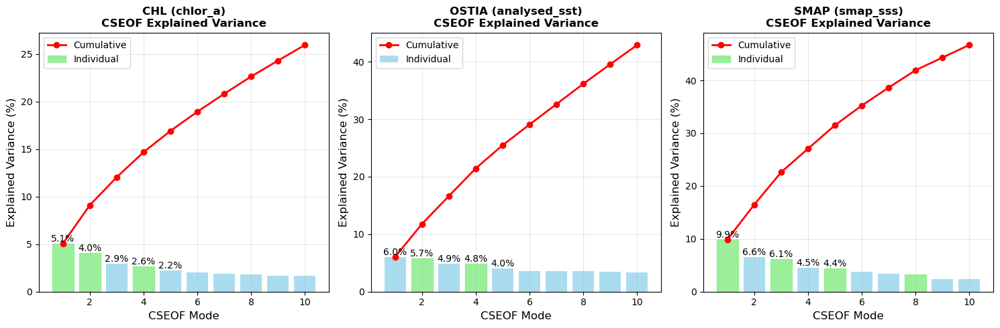


Generating CSEOF plots for CHL...


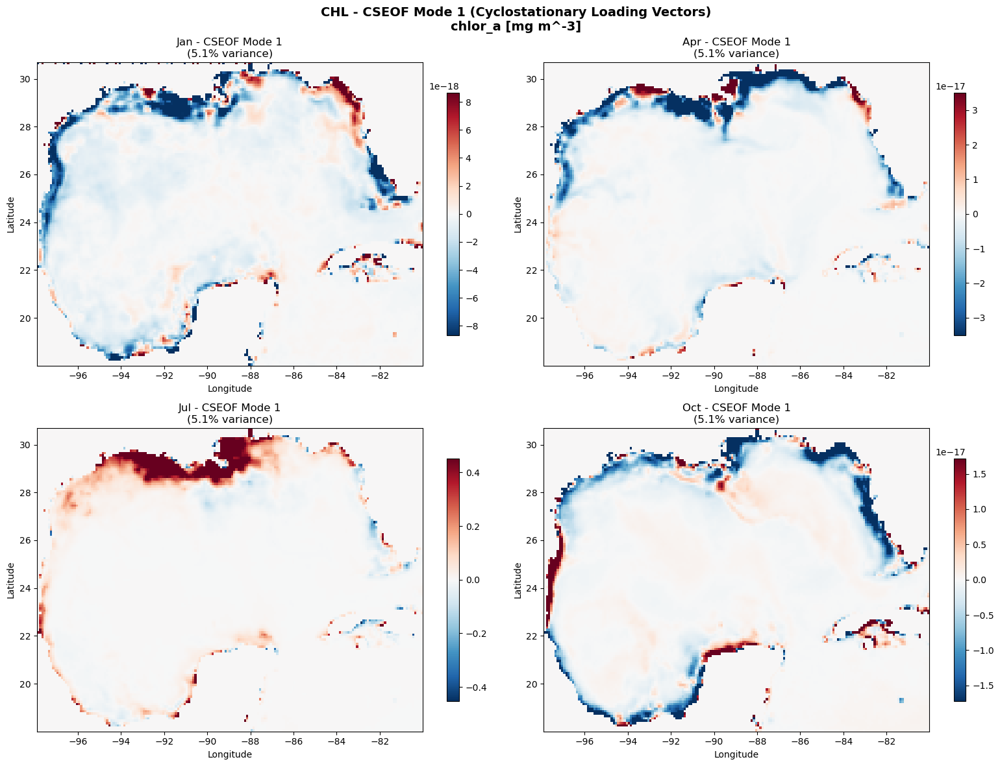

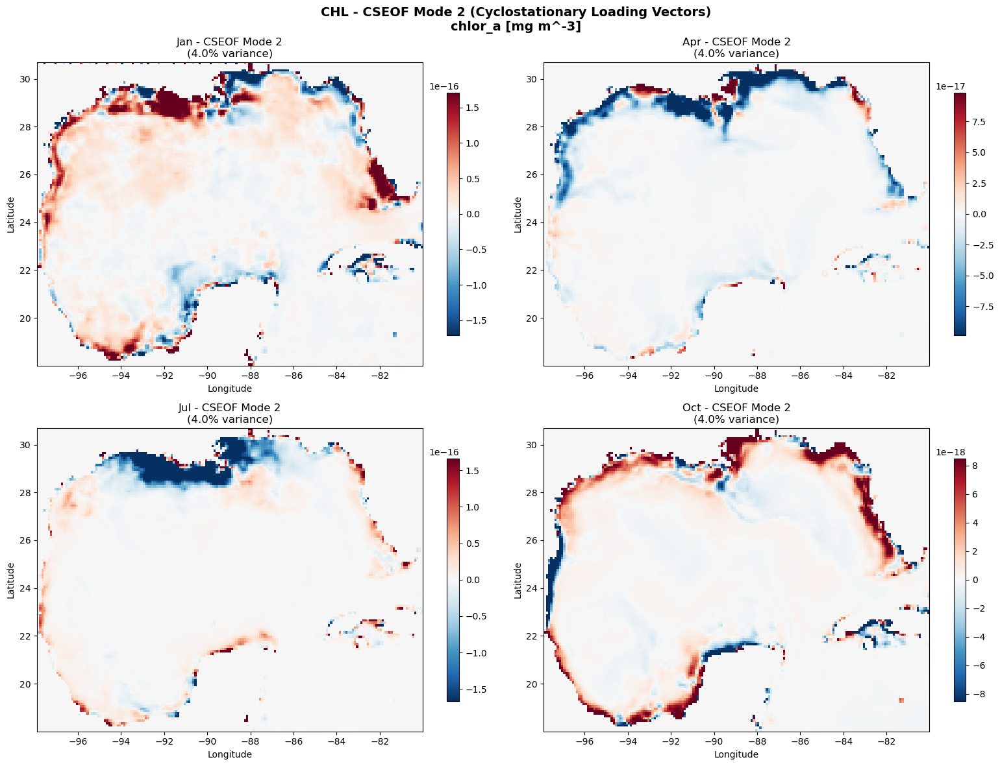

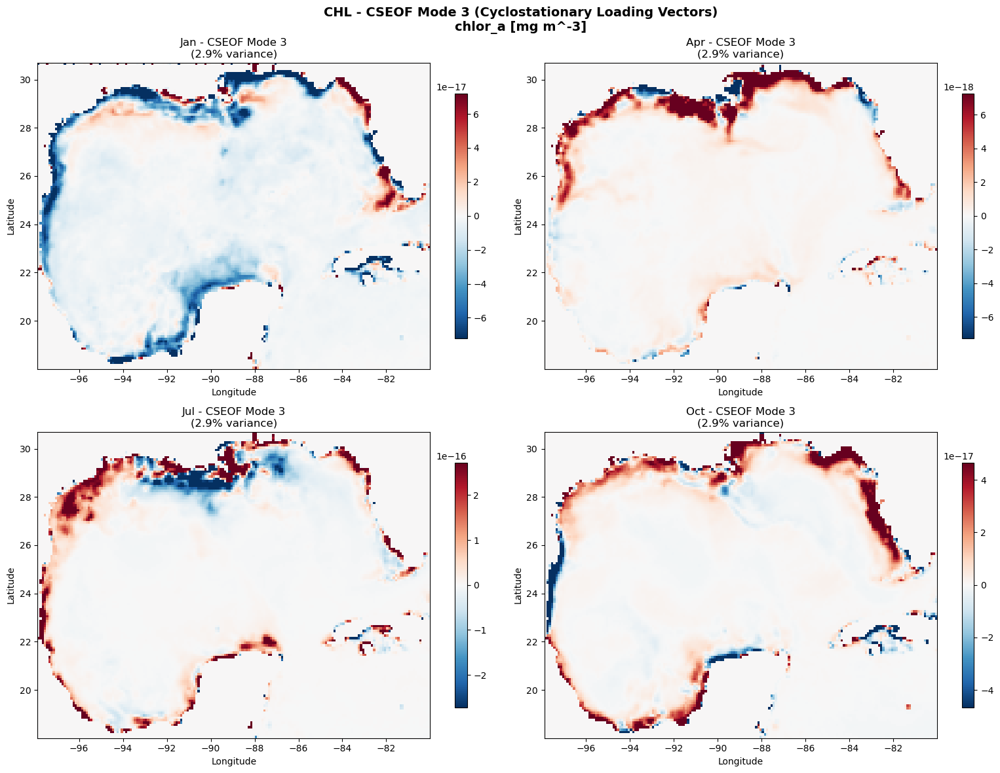

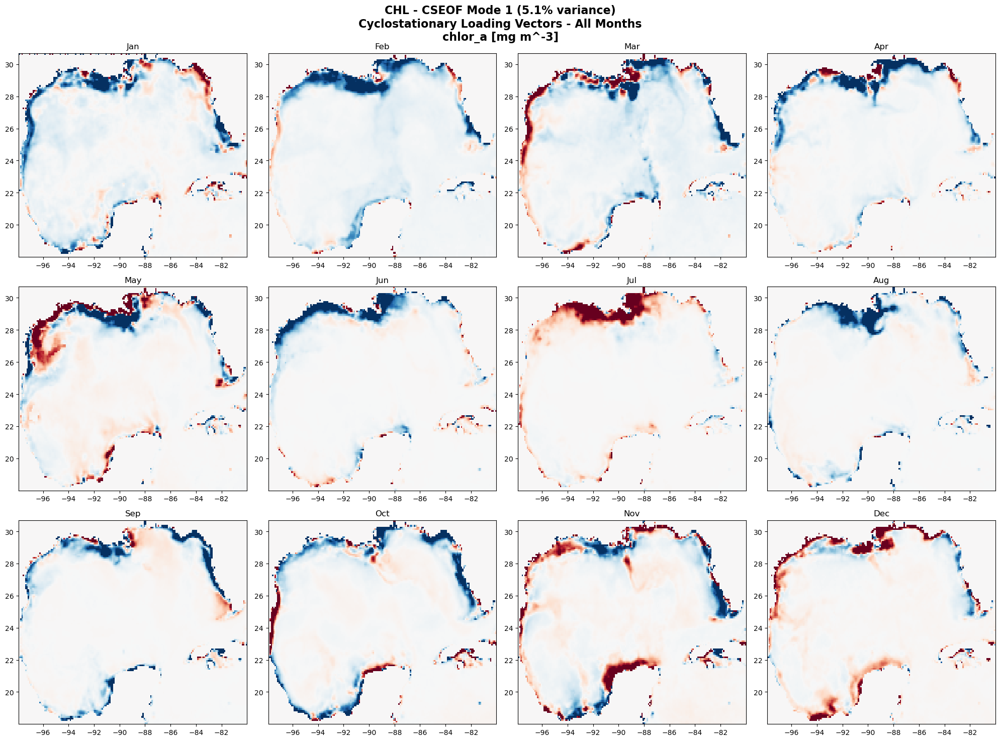

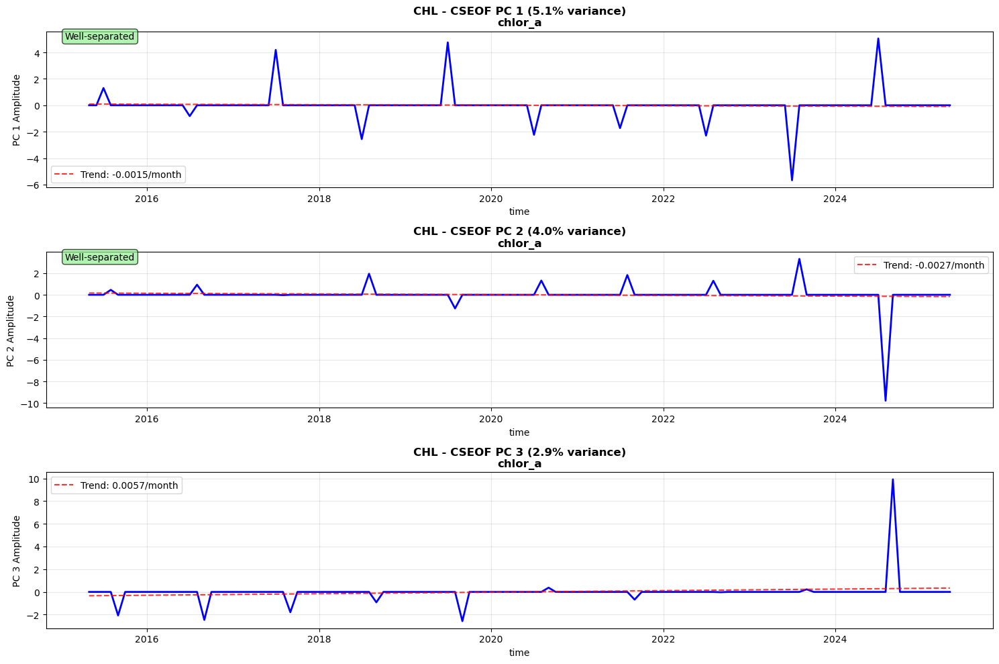


Generating CSEOF plots for OSTIA...


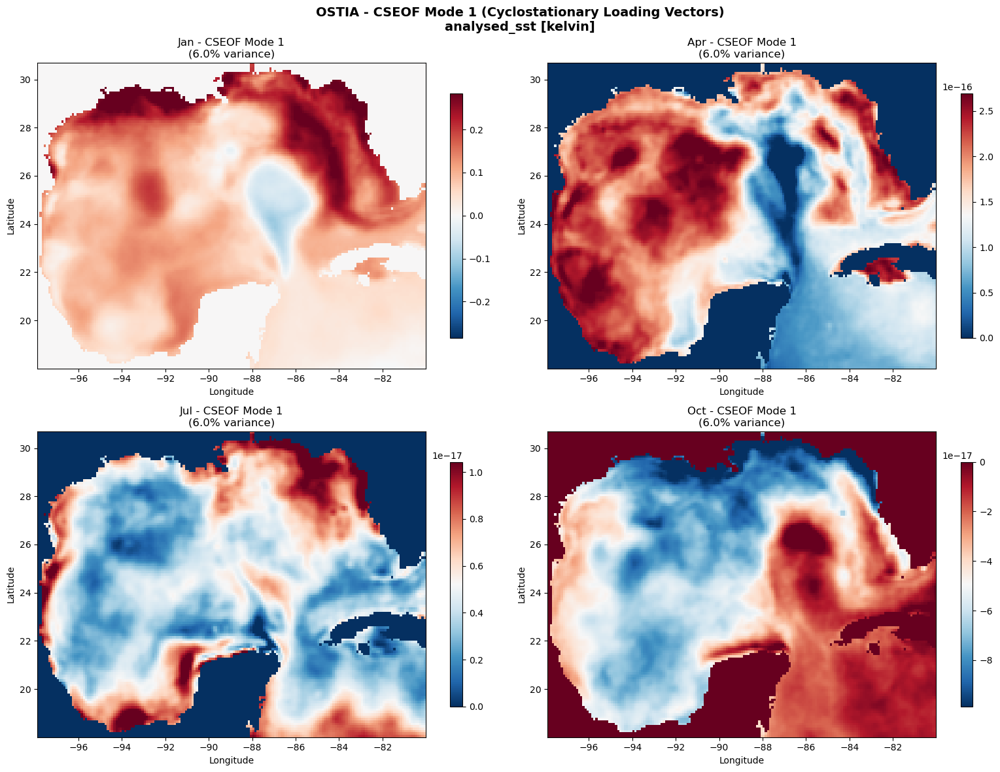

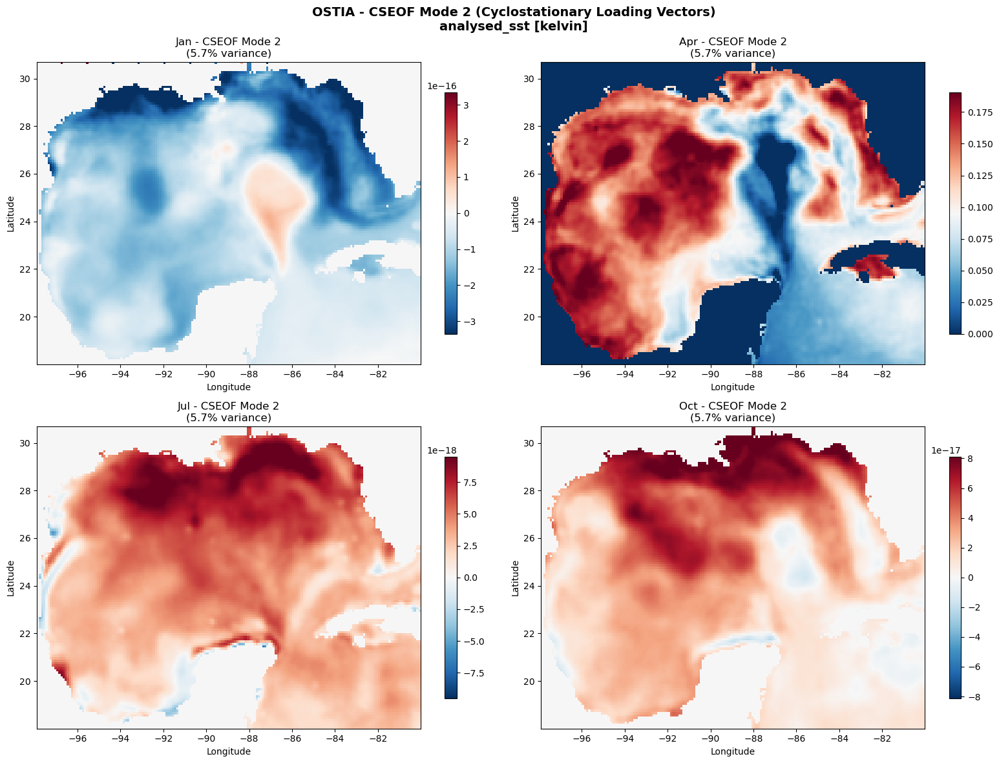

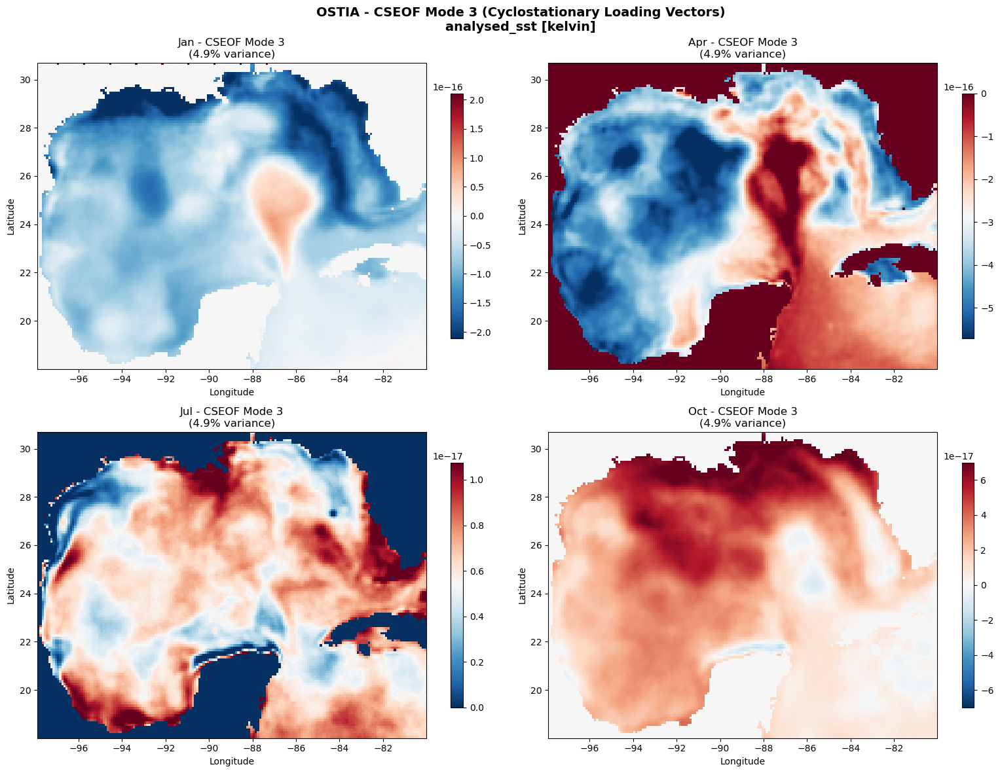

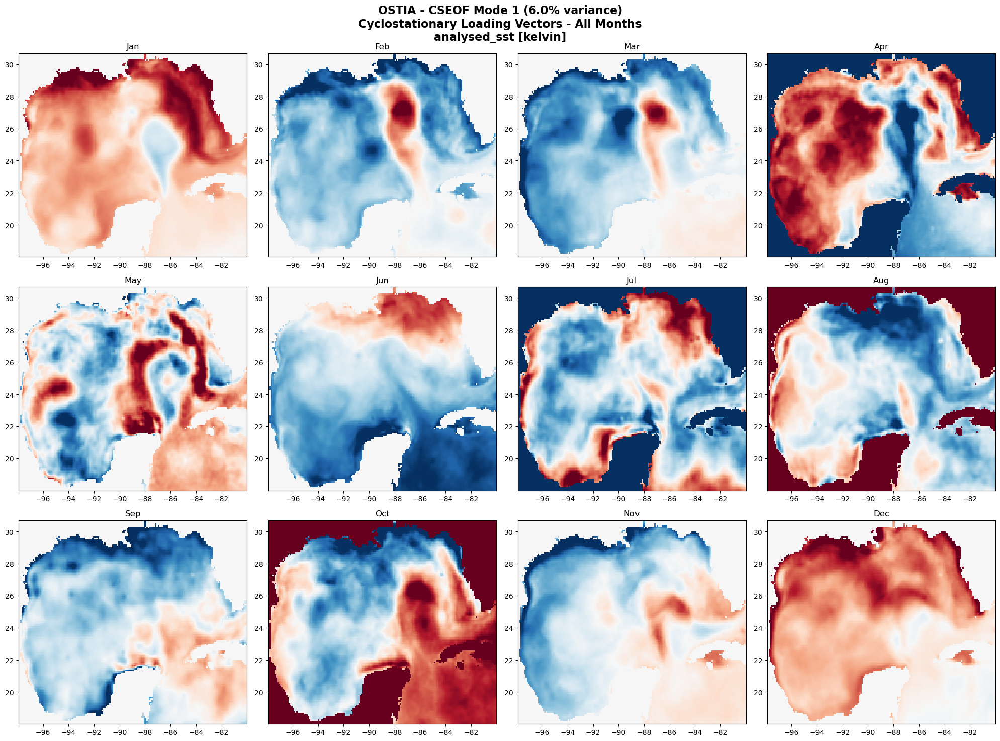

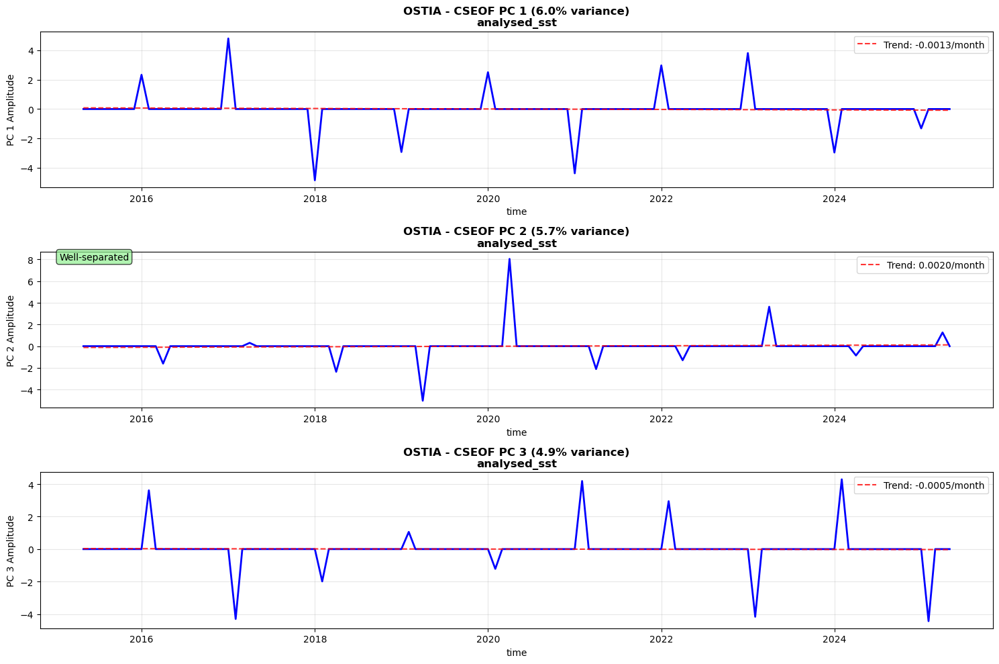


Generating CSEOF plots for SMAP...


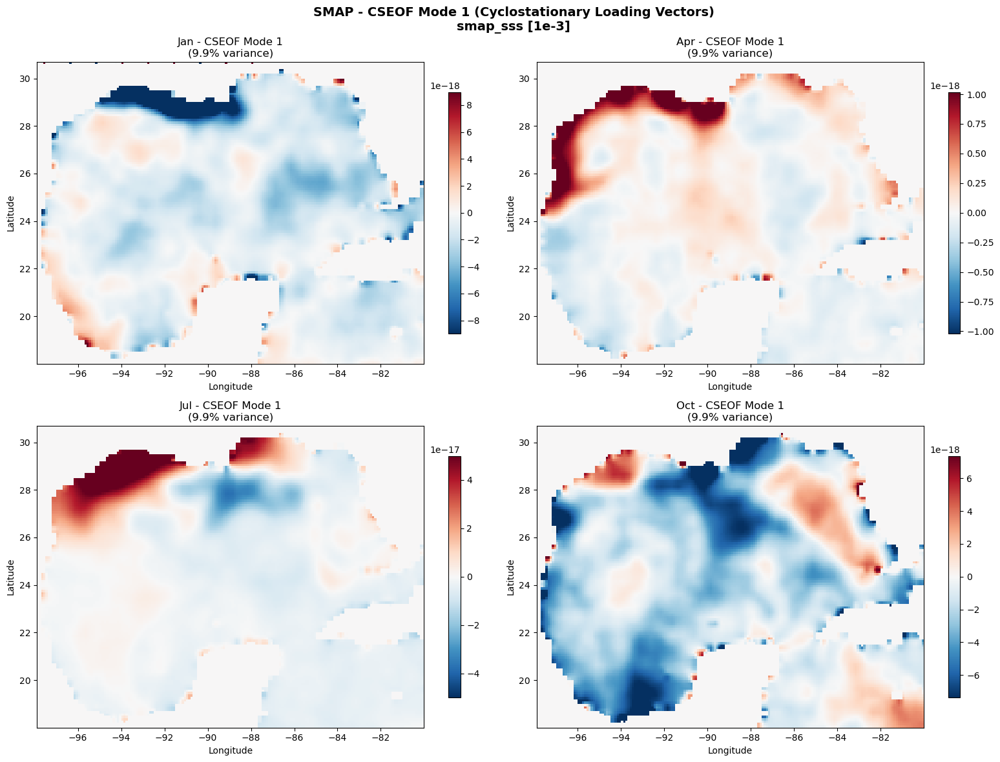

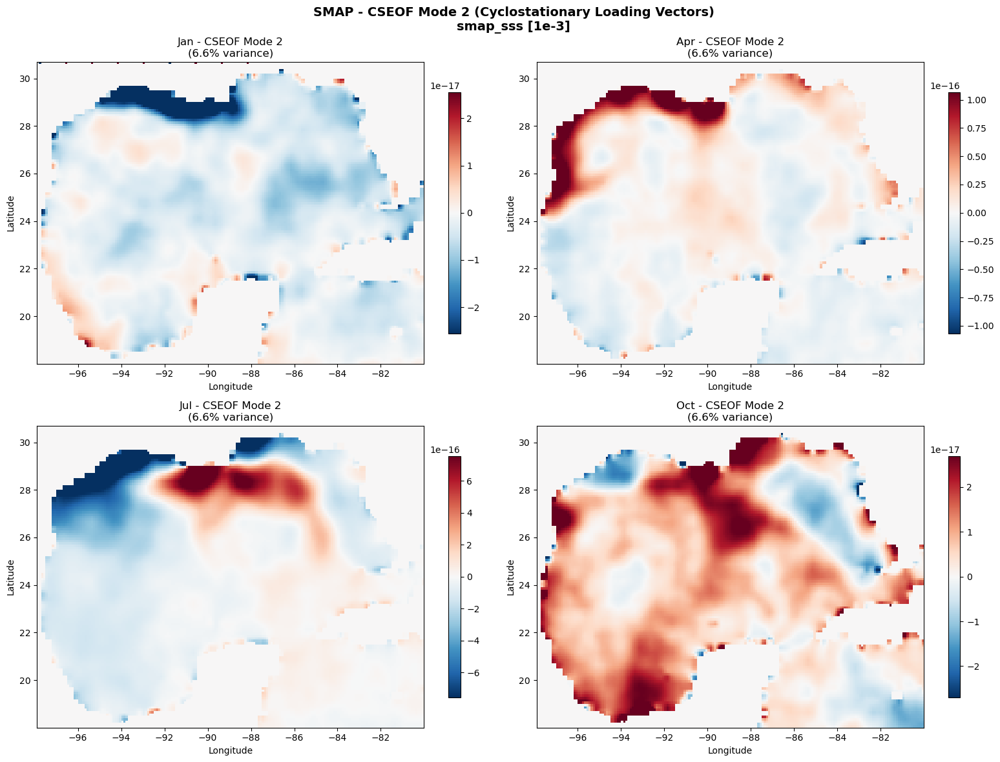

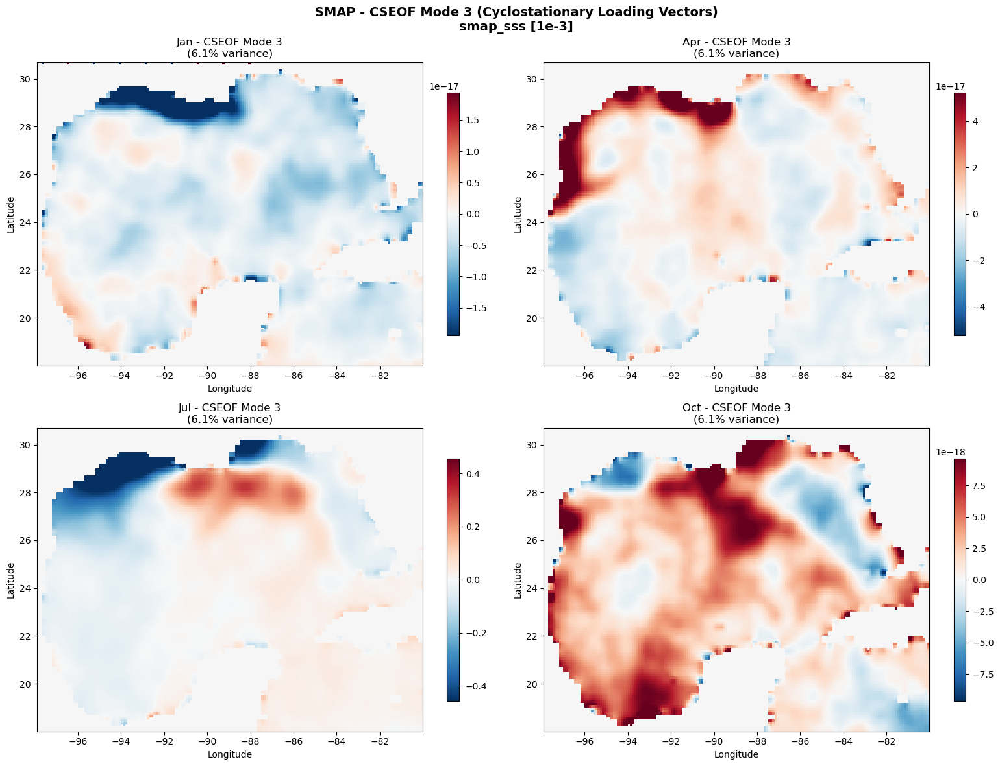

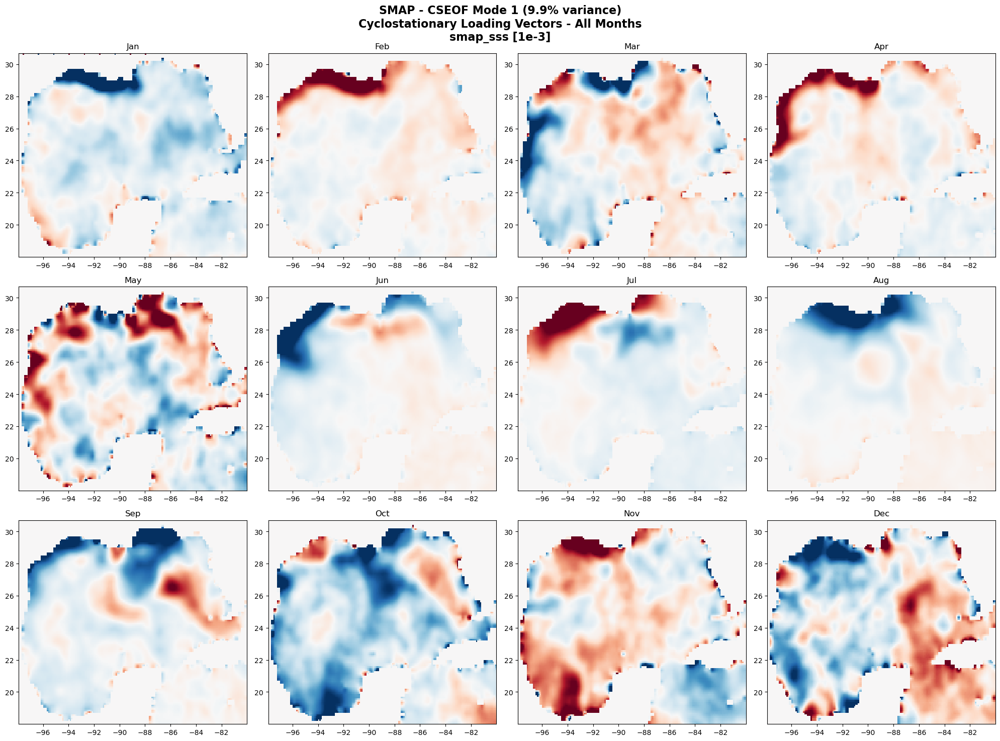

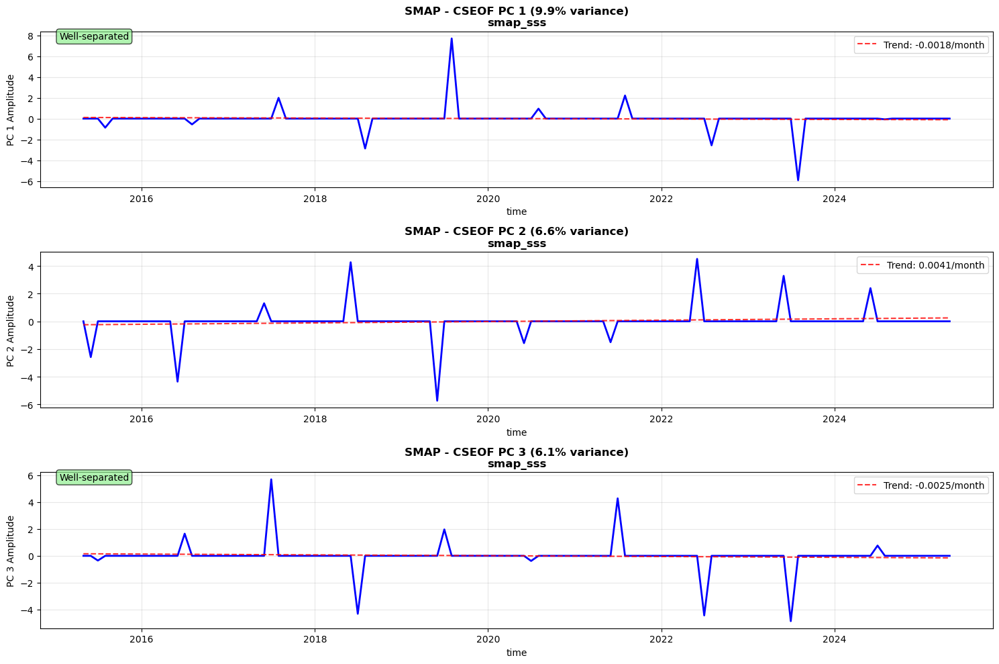


CSEOF ANALYSIS COMPLETE
Results show how spatial patterns evolve throughout the year
Each mode captures seasonally-dependent variability patterns


In [4]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from eofs.xarray import Eof
from eofs.tools.standard import correlation_map, covariance_map
import warnings
warnings.filterwarnings('ignore')

class GulfCyclostationaryEOF:
    """
    Cyclostationary EOF analysis for Gulf region geospatial time series
    Following Kim & North (1997) methodology - decomposes fields into 
    slow modulations of phase-locked annual cycles
    """
    
    def __init__(self, filepaths):
        """
        Initialize with Gulf region netCDF file paths
        
        Parameters:
        -----------
        filepaths : list
            List of netCDF file paths for Gulf region data
        """
        self.filepaths = filepaths
        self.datasets = {}
        self.processed_data = {}
        self.cseof_results = {}
        self.missing_data_stats = {}
        
    def load_data(self):
        """Load Gulf region netCDF files and identify variables"""
        print("Loading Gulf region datasets...")
        print("=" * 50)
        
        # Variable mapping for Gulf datasets
        variable_mapping = {
            'CHL': 'chlor_a',
            'OSTIA': 'analysed_sst', 
            'SMAP': 'smap_sss'
        }
        
        for i, filepath in enumerate(self.filepaths):
            try:
                # Load dataset
                ds = xr.open_dataset(filepath, chunks={'StdTime': 50})
                
                # Identify dataset type from filename
                dataset_type = None
                for key in variable_mapping.keys():
                    if key in filepath:
                        dataset_type = key
                        break
                
                if dataset_type is None:
                    print(f"Could not identify dataset type for {filepath}")
                    continue
                    
                var_name = variable_mapping[dataset_type]
                
                if var_name not in ds.data_vars:
                    print(f"Variable {var_name} not found in {filepath}")
                    continue
                
                # Extract data array and standardize coordinates
                data_array = ds[var_name]
                if 'StdTime' in data_array.dims:
                    data_array = data_array.rename({'StdTime': 'time'})
                
                self.datasets[dataset_type] = {
                    'data': data_array,
                    'variable_name': var_name,
                    'filepath': filepath,
                    'units': data_array.attrs.get('units', 'unknown')
                }
                
                print(f"\n{dataset_type} Dataset ({var_name}):")
                filename = filepath.split('\\')[-1]
                print(f"  File: {filename}")
                print(f"  Shape: {data_array.shape}")
                print(f"  Time range: {data_array.time.values[0]} to {data_array.time.values[-1]}")
                print(f"  Spatial extent: {data_array.lat.values.min():.2f}°N - {data_array.lat.values.max():.2f}°N")
                print(f"                  {data_array.lon.values.min():.2f}°E - {data_array.lon.values.max():.2f}°E")
                
                # Calculate missing data statistics
                total_points = data_array.size
                valid_points = (~np.isnan(data_array)).sum().values
                missing_pct = (1 - valid_points/total_points) * 100
                print(f"  Missing data: {missing_pct:.1f}% ({total_points-valid_points:,} / {total_points:,} points)")
                
                self.missing_data_stats[dataset_type] = {
                    'total_points': total_points,
                    'valid_points': valid_points,
                    'missing_percentage': missing_pct
                }
                
            except Exception as e:
                print(f"Error loading {filepath}: {e}")
    
    def analyze_missing_data(self):
        """Analyze spatial patterns of missing data"""
        print("\n" + "=" * 50)
        print("MISSING DATA ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            data = data_info['data']
            print(f"\n{dataset_type} ({data_info['variable_name']}):")
            
            # Calculate missing data percentage for each spatial location
            missing_by_location = np.isnan(data).mean(dim='time') * 100
            
            # Statistics
            locations_over_50pct = (missing_by_location > 50).sum().values
            total_locations = missing_by_location.size
            
            print(f"  Spatial locations with >50% missing: {locations_over_50pct} / {total_locations}")
            print(f"  Percentage of locations to remove: {locations_over_50pct/total_locations*100:.1f}%")
            print(f"  Missing data range: {missing_by_location.min().values:.1f}% - {missing_by_location.max().values:.1f}%")
            print(f"  Mean missing data per location: {missing_by_location.mean().values:.1f}%")
            
            # Store missing data mask
            self.missing_data_stats[dataset_type]['missing_by_location'] = missing_by_location
            self.missing_data_stats[dataset_type]['valid_locations_mask'] = missing_by_location <= 50
    
    def preprocess_data(self):
        """
        Preprocess data for CSEOF:
        1. Remove locations with >50% missing data
        2. Apply seasonal climatological interpolation
        3. Remove climatological mean for each month separately
        4. Apply area weighting
        """
        print("\n" + "=" * 50)
        print("CSEOF DATA PREPROCESSING")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            print(f"\nProcessing {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            # Step 1: Remove locations with >50% missing data
            missing_mask = self.missing_data_stats[dataset_type]['missing_by_location'] > 50
            data_masked = data.where(~missing_mask)
            
            locations_removed = missing_mask.sum().values
            total_locations = missing_mask.size
            print(f"Removed {locations_removed} locations ({locations_removed/total_locations*100:.1f}%) with >50% missing data")
            
            # Step 2: Seasonal climatological interpolation
            print("Applying seasonal interpolation...")
            data_interpolated = self._seasonal_interpolation(data_masked)
            
            # Step 3: Remove climatological mean for each month (as per paper methodology)
            print("Removing monthly climatological mean...")
            monthly_climatology = data_interpolated.groupby('time.month').mean(dim='time')
            data_anomalies = data_interpolated.groupby('time.month') - monthly_climatology
            
            # Step 4: Apply area weighting (as mentioned in the paper)
            print("Applying area weighting...")
            lat_weights = np.sqrt(np.cos(np.deg2rad(data_anomalies.lat)))
            data_weighted = data_anomalies * lat_weights
            
            # Store processed data
            self.processed_data[dataset_type] = {
                'data': data_weighted,
                'data_anomalies': data_anomalies,
                'monthly_climatology': monthly_climatology,
                'original_data': data,
                'variable_name': data_info['variable_name'],
                'units': data_info['units'],
                'lat_weights': lat_weights
            }
            
            print(f"CSEOF preprocessing complete for {dataset_type}")
    
    def _seasonal_interpolation(self, data):
        """Apply seasonal climatological interpolation"""
        # Create monthly climatology (mean for each month across all years)
        monthly_clim = data.groupby('time.month').mean(dim='time')
        
        # Apply interpolation month by month
        data_filled = data.copy()
        
        for month in range(1, 13):
            month_mask = data.time.dt.month == month
            if month_mask.any():
                month_data = data.isel(time=month_mask)
                month_clim = monthly_clim.sel(month=month)
                
                # Fill NaN values with climatology for this month
                filled_month = month_data.fillna(month_clim)
                data_filled.loc[dict(time=month_mask)] = filled_month
        
        return data_filled
    
    def create_cseof_matrix(self, dataset_type):
        """
        Create CSEOF data matrix following Kim & North (1997) methodology
        Arrange data as [12*space, time] matrix where each month gets separate spatial rows
        """
        print(f"\nCreating CSEOF data matrix for {dataset_type}...")
        
        data = self.processed_data[dataset_type]['data']
        
        # Get dimensions
        n_time = data.shape[0]
        n_lat = data.shape[1] 
        n_lon = data.shape[2]
        n_space = n_lat * n_lon
        
        # Create the CSEOF matrix: [12*space, time]
        # Each month gets its own set of spatial rows
        cseof_matrix = np.zeros((12 * n_space, n_time))
        
        # Fill the matrix
        for t in range(n_time):
            month_idx = data.time.dt.month.values[t] - 1  # Convert to 0-based indexing
            
            # Get spatial data for this time step
            spatial_data = data.isel(time=t).values.flatten()
            
            # Put data in the rows corresponding to this month
            start_row = month_idx * n_space
            end_row = (month_idx + 1) * n_space
            cseof_matrix[start_row:end_row, t] = spatial_data
        
        # Handle NaN values
        cseof_matrix = np.nan_to_num(cseof_matrix, nan=0.0)
        
        print(f"CSEOF matrix shape: {cseof_matrix.shape}")
        print(f"Original data shape: {data.shape}")
        print(f"Matrix structure: 12 months × {n_space} spatial points = {12 * n_space} rows")
        
        return cseof_matrix, (n_lat, n_lon)
    
    def perform_cseof_analysis(self, n_modes=10):
        """
        Perform Cyclostationary EOF analysis following Kim & North (1997)
        """
        print("\n" + "=" * 50)
        print("CYCLOSTATIONARY EOF ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.processed_data.items():
            print(f"\nPerforming CSEOF analysis: {dataset_type} ({data_info['variable_name']})...")
            
            # Create CSEOF data matrix
            cseof_matrix, spatial_shape = self.create_cseof_matrix(dataset_type)
            
            # Convert to xarray for EOF analysis
            time_coord = data_info['data'].time
            space_coord = np.arange(cseof_matrix.shape[0])
            
            cseof_xr = xr.DataArray(
                cseof_matrix.T,  # Transpose to [time, space*12] for eofs package
                dims=['time', 'space'],
                coords={'time': time_coord, 'space': space_coord}
            )
            
            try:
                # Create EOF solver
                solver = Eof(cseof_xr, weights=None)
                
                # Compute EOFs and PCs
                eofs = solver.eofs(neofs=n_modes, eofscaling=2)
                pcs = solver.pcs(npcs=n_modes, pcscaling=1)
                eigenvalues = solver.eigenvalues(neigs=n_modes)
                variance_fractions = solver.varianceFraction(neigs=n_modes)
                
                # Store results
                self.cseof_results[dataset_type] = {
                    'eofs': eofs,
                    'pcs': pcs,
                    'eigenvalues': eigenvalues,
                    'variance_fractions': variance_fractions,
                    'solver': solver,
                    'spatial_shape': spatial_shape,  # (n_lat, n_lon)
                    'cseof_matrix': cseof_matrix,
                    'variable_name': data_info['variable_name'],
                    'units': data_info['units'],
                    'lat_weights': data_info['lat_weights']
                }
                
                print(f"CSEOF analysis complete")
                print(f"First 5 modes explain: {variance_fractions.values[:5] * 100}")
                print(f"Cumulative variance (first 5): {np.cumsum(variance_fractions.values[:5]) * 100}")
                
                # Apply North's criterion for mode significance
                self._apply_north_criterion(dataset_type)
                
            except Exception as e:
                print(f"Error in CSEOF analysis: {e}")
    
    def _apply_north_criterion(self, dataset_type):
        """Apply North's criterion to test mode separation"""
        results = self.cseof_results[dataset_type]
        eigenvalues = results['eigenvalues'].values
        n_samples = len(results['pcs'].time)
        
        # Calculate North's criterion: delta_lambda = lambda * sqrt(2/N)
        delta_lambda = eigenvalues * np.sqrt(2 / n_samples)
        
        # Test for well-separated modes
        well_separated = []
        for i in range(len(eigenvalues) - 1):
            separation = eigenvalues[i] - eigenvalues[i + 1]
            criterion = delta_lambda[i]
            well_separated.append(separation > criterion)
        
        results['north_criterion'] = delta_lambda
        results['well_separated'] = well_separated
        
        n_separated = sum(well_separated) + 1  # +1 because we compare adjacent pairs
        print(f"North's criterion: First {n_separated} modes are statistically well-separated")
    
    def extract_monthly_pattern(self, dataset_type, mode, month):
        """
        Extract the spatial pattern for a specific mode and month
        This is the Cyclostationary Loading Vector (CSLV) for that month
        """
        if dataset_type not in self.cseof_results:
            return None
            
        results = self.cseof_results[dataset_type]
        eof_vector = results['eofs'].isel(mode=mode).values
        n_lat, n_lon = results['spatial_shape']
        n_space = n_lat * n_lon
        
        # Extract the pattern for the specified month (0-based indexing)
        month_idx = month - 1
        start_idx = month_idx * n_space
        end_idx = (month_idx + 1) * n_space
        
        month_pattern = eof_vector[start_idx:end_idx].reshape(n_lat, n_lon)
        
        # Remove area weighting for visualization
        lat_weights = results['lat_weights']
        # Broadcast lat_weights to match the 2D pattern shape
        lat_weights_2d = np.broadcast_to(lat_weights.values[:, np.newaxis], month_pattern.shape)
        month_pattern = month_pattern / lat_weights_2d
        
        # Create xarray with proper coordinates
        original_data = self.processed_data[dataset_type]['data']
        
        spatial_pattern = xr.DataArray(
            month_pattern,
            dims=['lat', 'lon'],
            coords={'lat': original_data.lat, 'lon': original_data.lon}
        )
        
        return spatial_pattern
    
    def plot_cseof_mode(self, dataset_type, mode=0, months=[1, 4, 7, 10], figsize=(16, 12)):
        """
        Plot CSEOF mode patterns for different months (Cyclostationary Loading Vectors)
        """
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        n_months = len(months)
        
        fig, axes = plt.subplots(2, 2, figsize=figsize)
        axes = axes.flatten()
        
        month_names = ['', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        for i, month in enumerate(months):
            ax = axes[i]
            
            # Extract CSLV for this month
            spatial_pattern = self.extract_monthly_pattern(dataset_type, mode, month)
            
            if spatial_pattern is not None:
                im = spatial_pattern.plot(ax=ax, cmap='RdBu_r', add_colorbar=False, robust=True)
                
                # Add title
                variance_pct = results['variance_fractions'].values[mode] * 100
                ax.set_title(f'{month_names[month]} - CSEOF Mode {mode+1}\n({variance_pct:.1f}% variance)')
                
                # Add colorbar
                plt.colorbar(im, ax=ax, shrink=0.8)
            
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')
        
        plt.suptitle(f'{dataset_type} - CSEOF Mode {mode+1} (Cyclostationary Loading Vectors)\n'
                    f'{results["variable_name"]} [{results["units"]}]', 
                    fontsize=14, weight='bold')
        plt.tight_layout()
        plt.show()
    
    def plot_all_monthly_patterns(self, dataset_type, mode=0, figsize=(20, 15)):
        """
        Plot all 12 monthly patterns for a CSEOF mode
        """
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        for month in range(1, 13):
            ax = axes[month-1]
            
            # Extract CSLV for this month
            spatial_pattern = self.extract_monthly_pattern(dataset_type, mode, month)
            
            if spatial_pattern is not None:
                im = spatial_pattern.plot(ax=ax, cmap='RdBu_r', add_colorbar=False, robust=True)
                ax.set_title(f'{month_names[month-1]}')
                
            ax.set_xlabel('')
            ax.set_ylabel('')
        
        # Add overall title and colorbar
        variance_pct = results['variance_fractions'].values[mode] * 100
        plt.suptitle(f'{dataset_type} - CSEOF Mode {mode+1} ({variance_pct:.1f}% variance)\n'
                    f'Cyclostationary Loading Vectors - All Months\n'
                    f'{results["variable_name"]} [{results["units"]}]', 
                    fontsize=16, weight='bold')
        
        # Add a common colorbar
        plt.tight_layout()
        plt.show()
    
    def plot_principal_components(self, dataset_type, modes=[0, 1, 2], figsize=(15, 10)):
        """Plot principal components time series"""
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        pcs = results['pcs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= pcs.shape[1]:
                continue
            
            ax = axes[i]
            
            # Plot PC time series
            pc_data = pcs.isel(mode=mode)
            pc_data.plot(ax=ax, linewidth=2, color='blue')
            
            # Add variance info
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            
            ax.set_title(f'{dataset_type} - CSEOF PC {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name}', fontsize=12, weight='bold')
            ax.set_ylabel(f'PC {mode + 1} Amplitude', fontsize=10)
            ax.grid(True, alpha=0.3)
            
            # Add trend line
            time_numeric = np.arange(len(pc_data))
            trend_coef = np.polyfit(time_numeric, pc_data.values, 1)
            trend_line = np.polyval(trend_coef, time_numeric)
            ax.plot(pc_data.time, trend_line, 'r--', alpha=0.8, 
                   label=f'Trend: {trend_coef[0]:.4f}/month')
            ax.legend()
            
            # Mark well-separated modes
            if mode < len(results['well_separated']) and results['well_separated'][mode]:
                ax.text(0.02, 0.95, 'Well-separated', transform=ax.transAxes, 
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgreen", alpha=0.7))
        
        plt.tight_layout()
        plt.show()
    
    def plot_explained_variance(self, figsize=(15, 5)):
        """Plot explained variance for CSEOF analysis"""
        n_datasets = len(self.cseof_results)
        if n_datasets == 0:
            print("No CSEOF results to plot")
            return
            
        fig, axes = plt.subplots(1, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = [axes]
        
        for i, (dataset_type, results) in enumerate(self.cseof_results.items()):
            ax = axes[i]
            
            variance_fractions = results['variance_fractions'].values * 100
            cumulative_variance = np.cumsum(variance_fractions)
            
            # Plot individual and cumulative variance
            bars = ax.bar(range(1, len(variance_fractions) + 1), variance_fractions, 
                         alpha=0.7, label='Individual', color='skyblue')
            line = ax.plot(range(1, len(variance_fractions) + 1), cumulative_variance, 
                          'ro-', label='Cumulative', linewidth=2, markersize=6)
            
            # Highlight well-separated modes
            well_separated = results.get('well_separated', [])
            for j in range(min(len(well_separated), len(bars))):
                if well_separated[j]:
                    bars[j].set_color('lightgreen')
                    bars[j].set_alpha(0.9)
            
            # Formatting
            ax.set_xlabel('CSEOF Mode', fontsize=12)
            ax.set_ylabel('Explained Variance (%)', fontsize=12)
            var_name = results['variable_name']
            ax.set_title(f'{dataset_type} ({var_name})\nCSEOF Explained Variance', fontsize=12, weight='bold')
            ax.legend()
            ax.grid(True, alpha=0.3)
            
            # Add percentage labels on bars for first few modes
            for j, bar in enumerate(bars[:5]):
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2., height,
                       f'{height:.1f}%', ha='center', va='bottom', fontsize=10)
        
        plt.tight_layout()
        plt.show()
    
    def plot_monthly_climatology(self, dataset_type, figsize=(15, 8)):
        """Plot monthly climatology that was removed during preprocessing"""
        if dataset_type not in self.processed_data:
            print(f"Dataset {dataset_type} not found")
            return
            
        data_info = self.processed_data[dataset_type]
        monthly_clim = data_info['monthly_climatology']
        
        # Create subplot for each month
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        for i, month in enumerate(range(1, 13)):
            ax = axes[i]
            clim_data = monthly_clim.sel(month=month)
            
            im = clim_data.plot(ax=ax, cmap='viridis', add_colorbar=False)
            ax.set_title(f'{months[i]}')
            ax.set_xlabel('')
            ax.set_ylabel('')
            
        plt.suptitle(f'{dataset_type} Monthly Climatology (Removed for CSEOF)\n{data_info["variable_name"]} [{data_info["units"]}]', 
                    fontsize=14, weight='bold')
        plt.tight_layout()
        plt.show()

# Example usage
if __name__ == "__main__":
    # Gulf region file paths
    filepaths = [
        r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4", 
        r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
    ]
    
    print("Gulf Region CYCLOSTATIONARY EOF Analysis")
    print("=" * 60)
    print("Method: Kim & North (1997) CSEOF")
    print("Decomposes fields into slow modulations of phase-locked annual cycles")
    print("Each mode has 12 different spatial patterns (one per month)")
    print("Time period: May 2015 - May 2025 (121 monthly time steps)")
    print("Study region: Gulf of Mexico")
    print()
    
    # Initialize analysis
    cseof_analysis = GulfCyclostationaryEOF(filepaths)
    
    # Step 1: Load data
    cseof_analysis.load_data()
    
    # Step 2: Analyze missing data patterns
    cseof_analysis.analyze_missing_data()
    
    # Step 3: Preprocess data for CSEOF
    cseof_analysis.preprocess_data()
    
    # Step 4: Perform CSEOF analysis
    cseof_analysis.perform_cseof_analysis(n_modes=10)
    
    # Step 5: Generate visualizations
    print("\n" + "=" * 50)
    print("GENERATING CSEOF VISUALIZATIONS")
    print("=" * 50)
    
    # Show monthly climatology that was removed
    for dataset_type in cseof_analysis.processed_data.keys():
        cseof_analysis.plot_monthly_climatology(dataset_type)
    
    # Explained variance plots
    cseof_analysis.plot_explained_variance()
    
    # CSEOF modes and principal components
    for dataset_type in cseof_analysis.cseof_results.keys():
        print(f"\nGenerating CSEOF plots for {dataset_type}...")
        
        # Plot first 3 modes with seasonal patterns
        cseof_analysis.plot_cseof_mode(dataset_type, mode=0, months=[1, 4, 7, 10])
        cseof_analysis.plot_cseof_mode(dataset_type, mode=1, months=[1, 4, 7, 10])
        cseof_analysis.plot_cseof_mode(dataset_type, mode=2, months=[1, 4, 7, 10])
        
        # Plot all 12 months for first mode
        cseof_analysis.plot_all_monthly_patterns(dataset_type, mode=0)
        
        # Plot principal components
        cseof_analysis.plot_principal_components(dataset_type, modes=[0, 1, 2])
    
    print("\n" + "=" * 50)
    print("CSEOF ANALYSIS COMPLETE")
    print("=" * 50)
    print("Results show how spatial patterns evolve throughout the year")
    print("Each mode captures seasonally-dependent variability patterns")

Gulf Region CYCLOSTATIONARY EOF Analysis
Method: Kim & North (1997) CSEOF
Decomposes fields into slow modulations of phase-locked annual cycles
Each mode has 12 different spatial patterns (one per month)
Time period: May 2015 - May 2025 (121 monthly time steps)
Study region: Gulf of Mexico

Loading Gulf region datasets...

CHL Dataset (chlor_a):
  File: CHL_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.5% (673,903 / 2,750,693 points)

OSTIA Dataset (analysed_sst):
  File: OSTIA_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:00.000000000 to 2025-05-01T00:00:00.000000000
  Spatial extent: 18.05°N - 30.65°N
                  -97.85°E - -80.05°E
  Missing data: 24.7% (679,899 / 2,750,693 points)

SMAP Dataset (smap_sss):
  File: SMAP_MO_Gulf_10.nc4
  Shape: (121, 127, 179)
  Time range: 2015-05-01T00:00:0

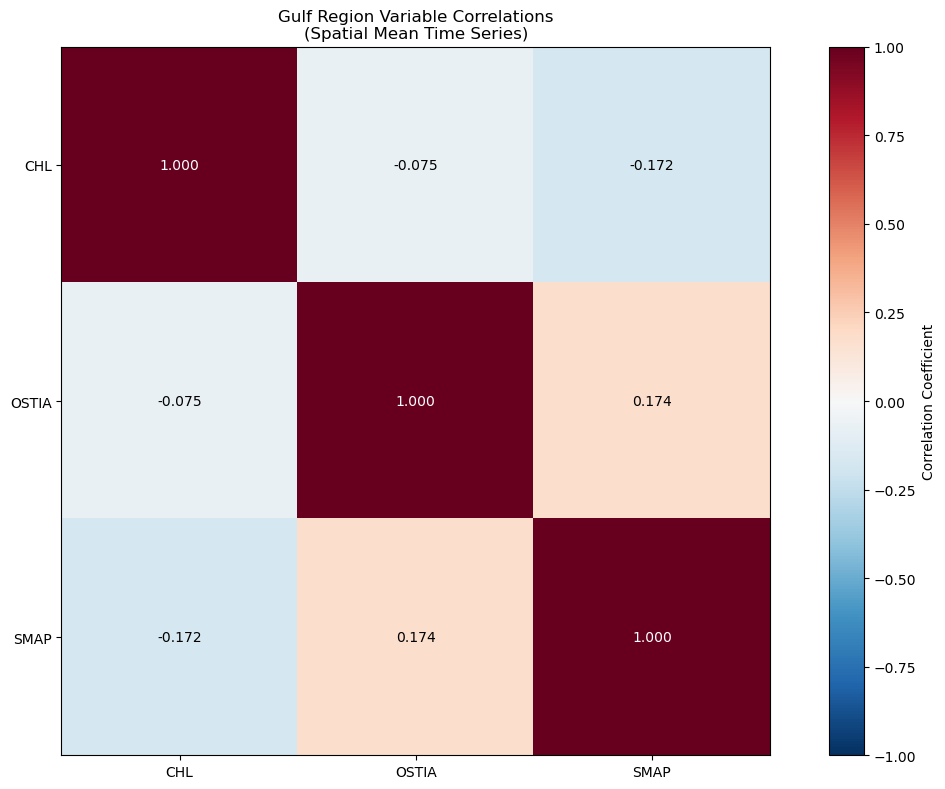


CSEOF CROSS-CORRELATION ANALYSIS

CHL vs OSTIA CSEOF Correlation Analysis:
--------------------------------------------------


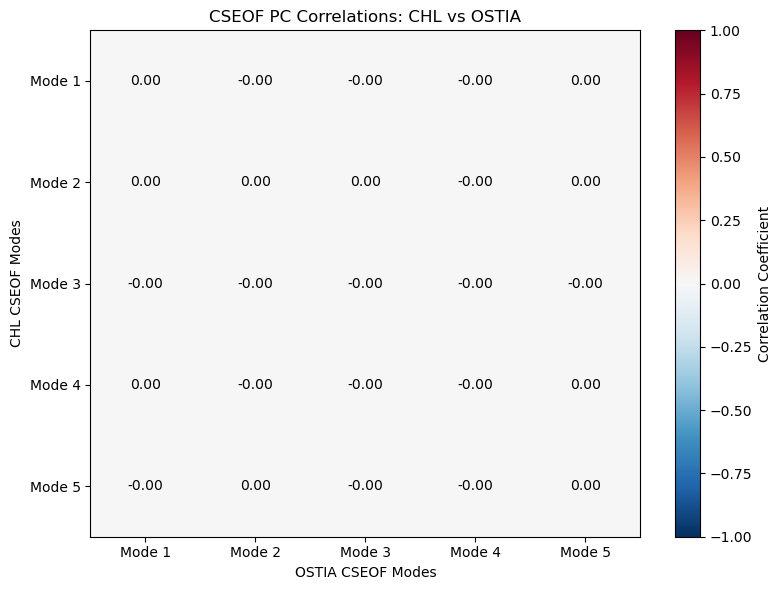


CHL vs SMAP CSEOF Correlation Analysis:
--------------------------------------------------
  Mode 1 vs Mode 3: r=0.646 (5.1% & 6.1% variance)


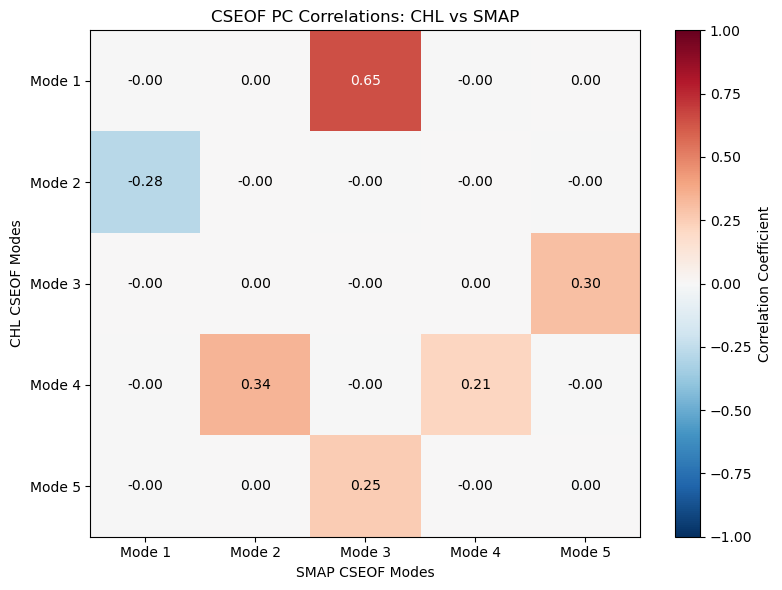


OSTIA vs SMAP CSEOF Correlation Analysis:
--------------------------------------------------


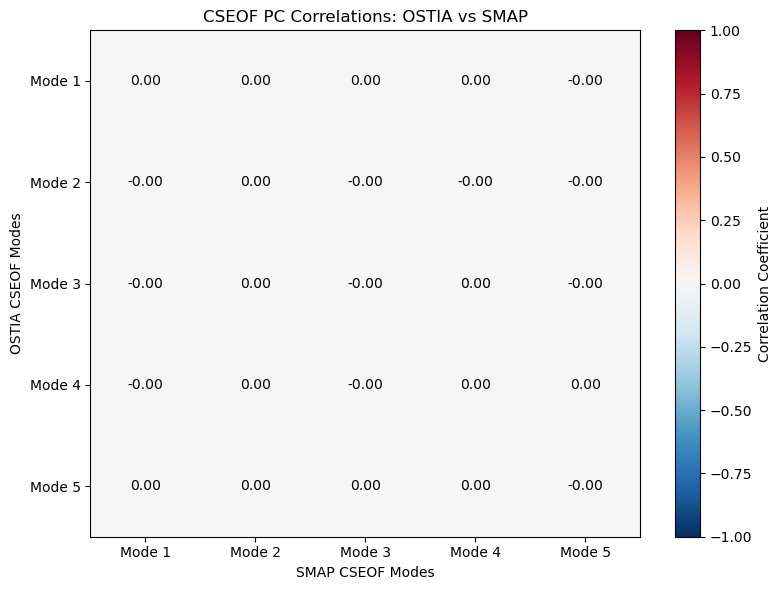


GENERATING CSEOF VISUALIZATIONS


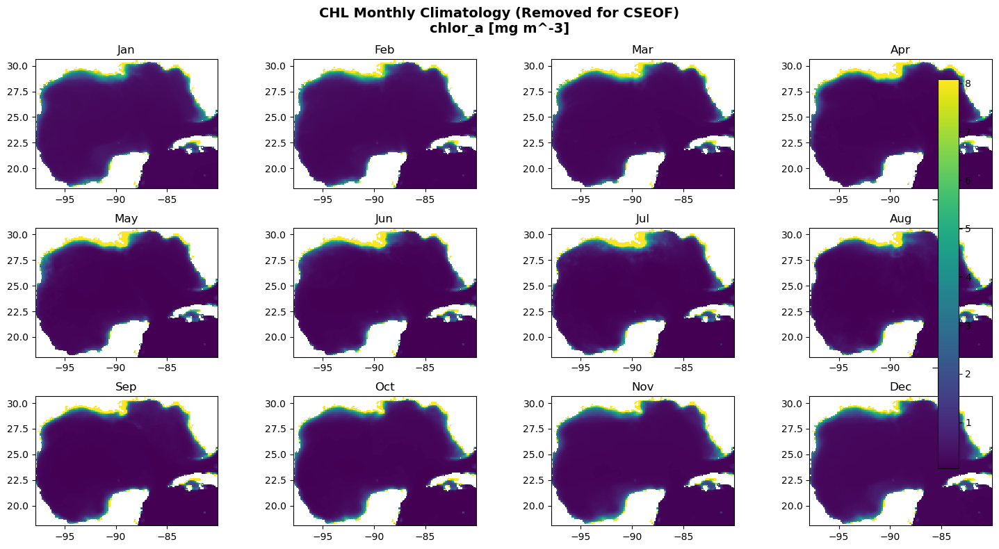

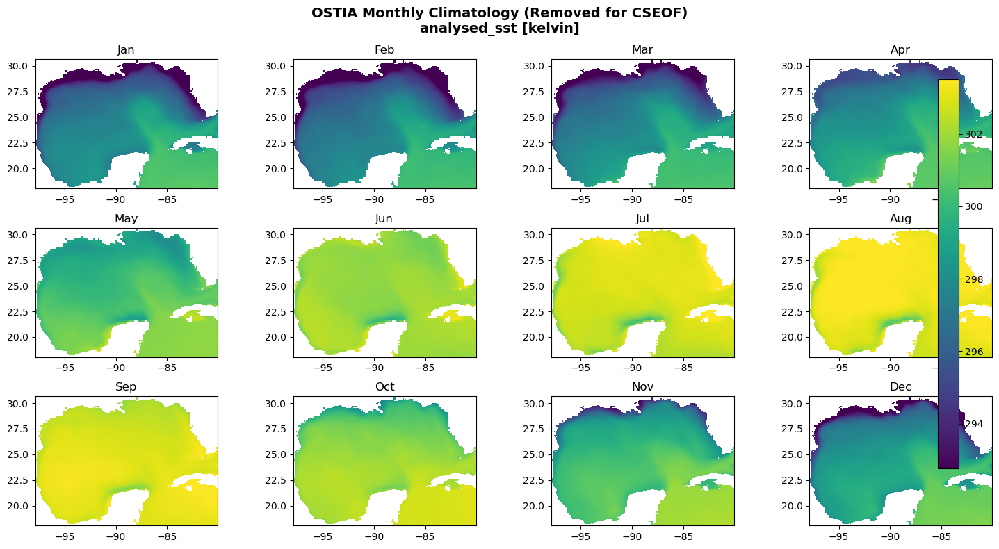

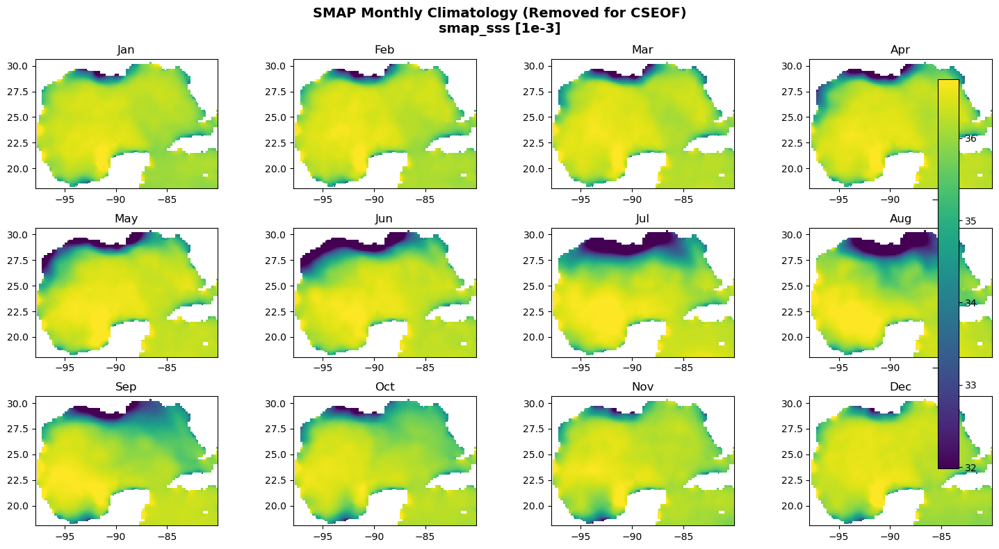

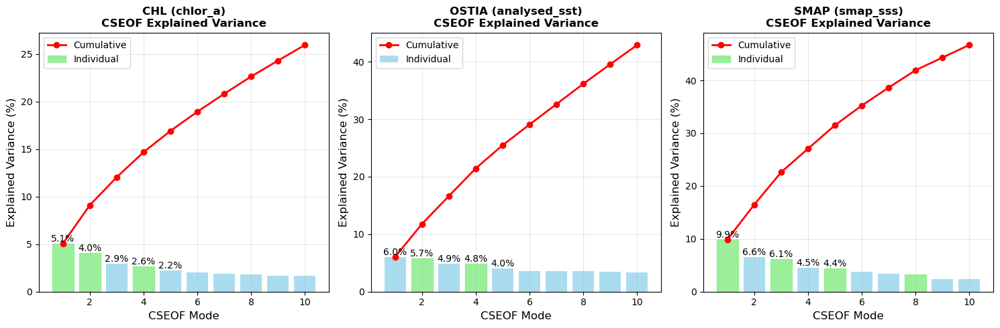


Generating CSEOF plots for CHL...


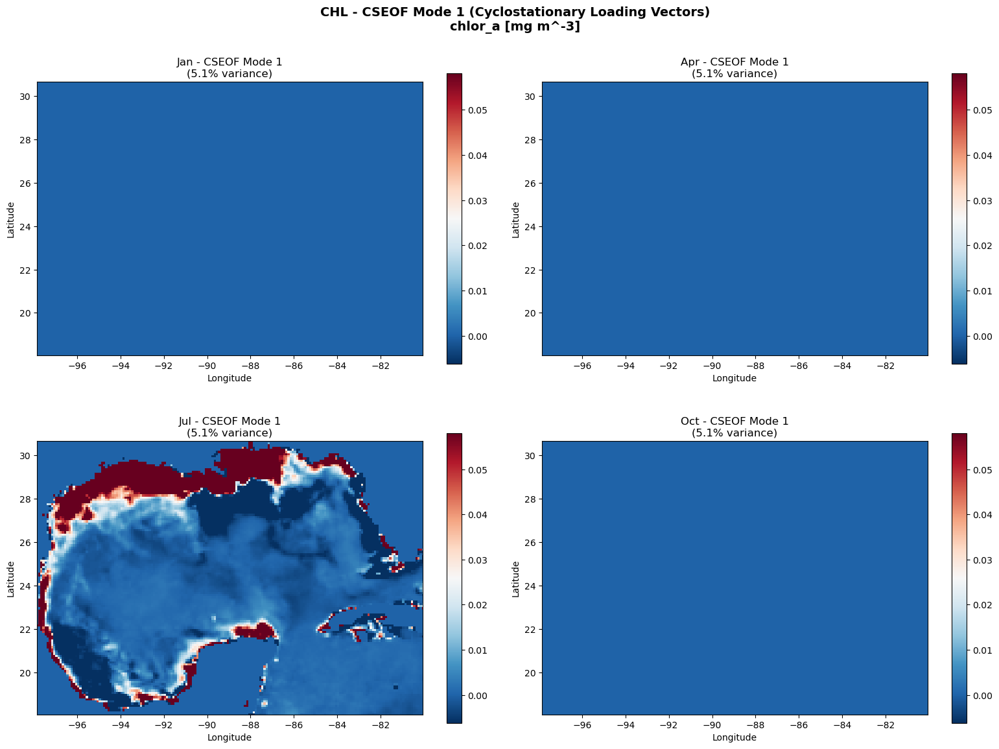

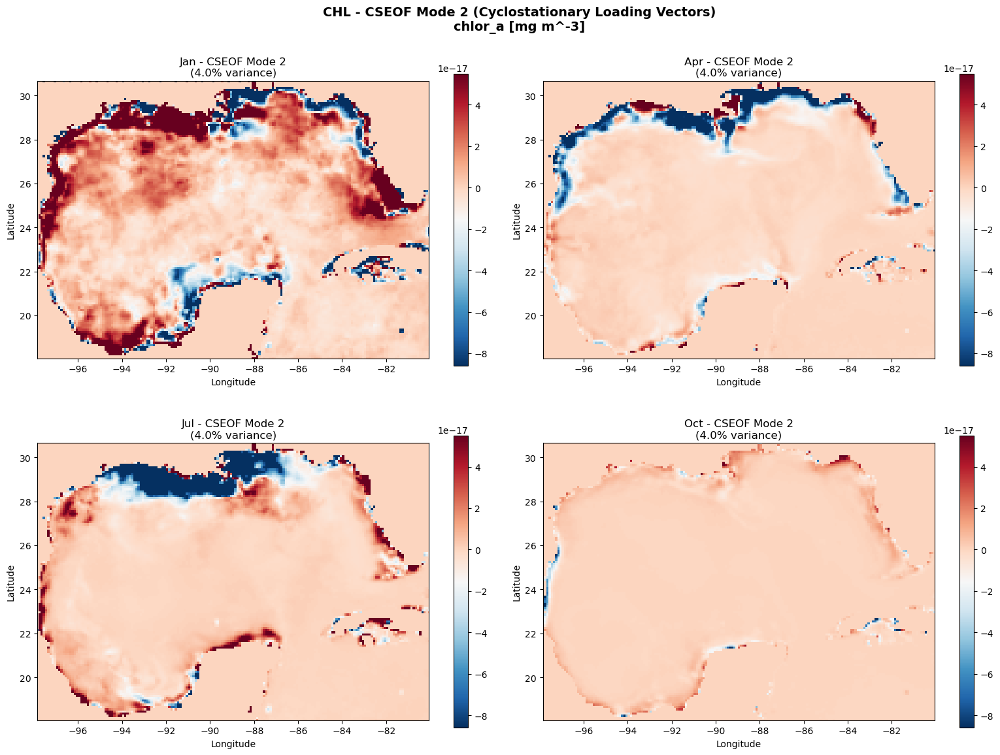

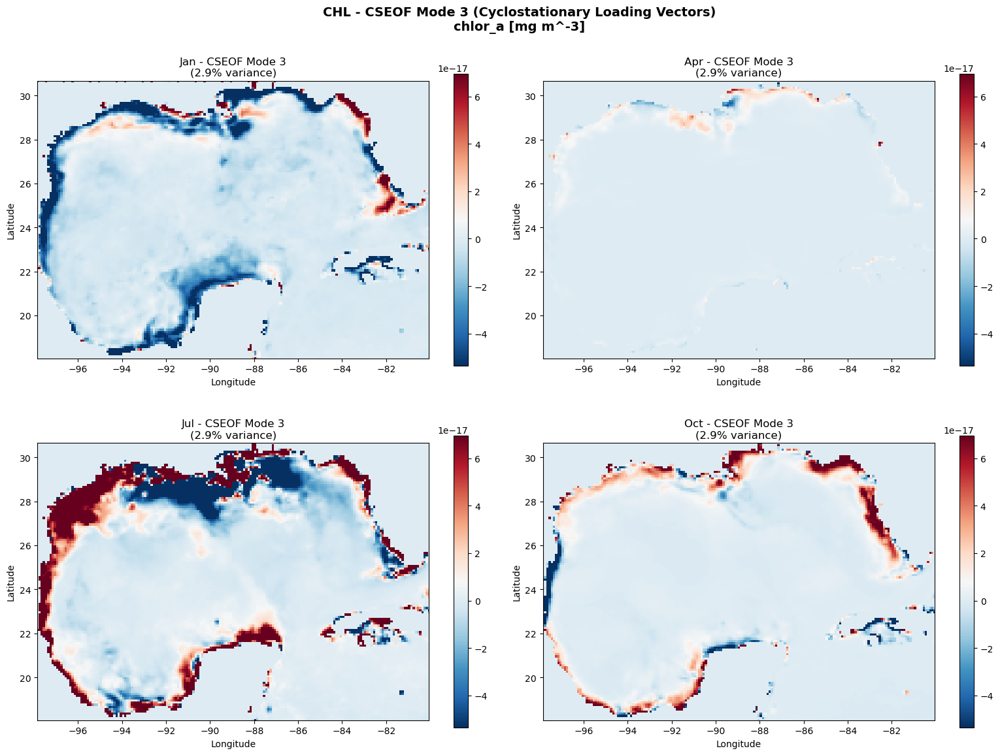

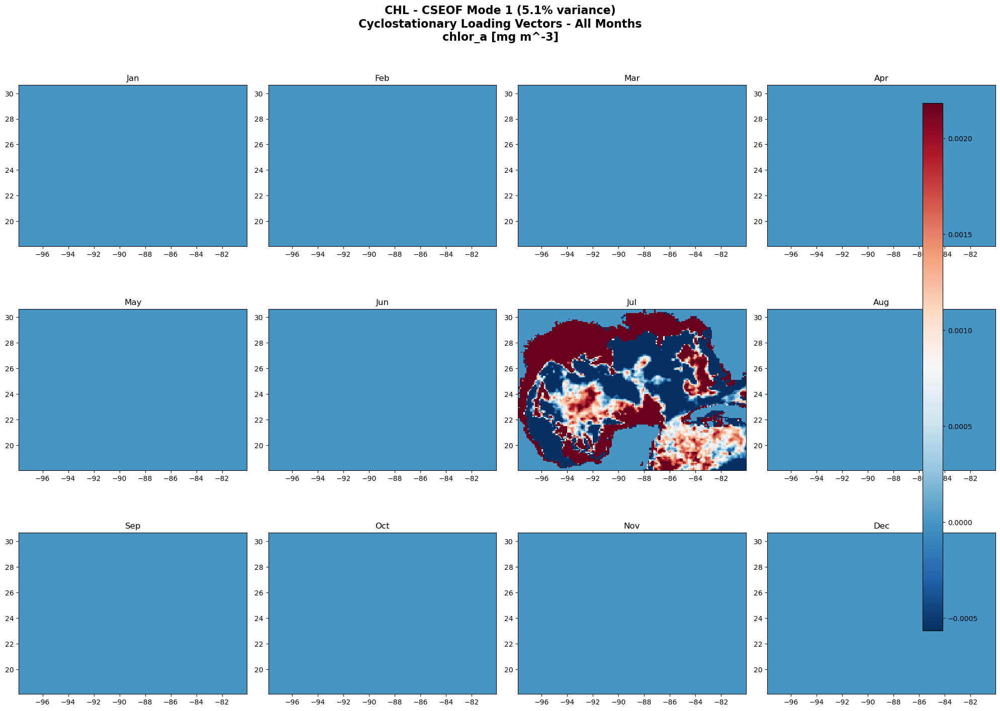

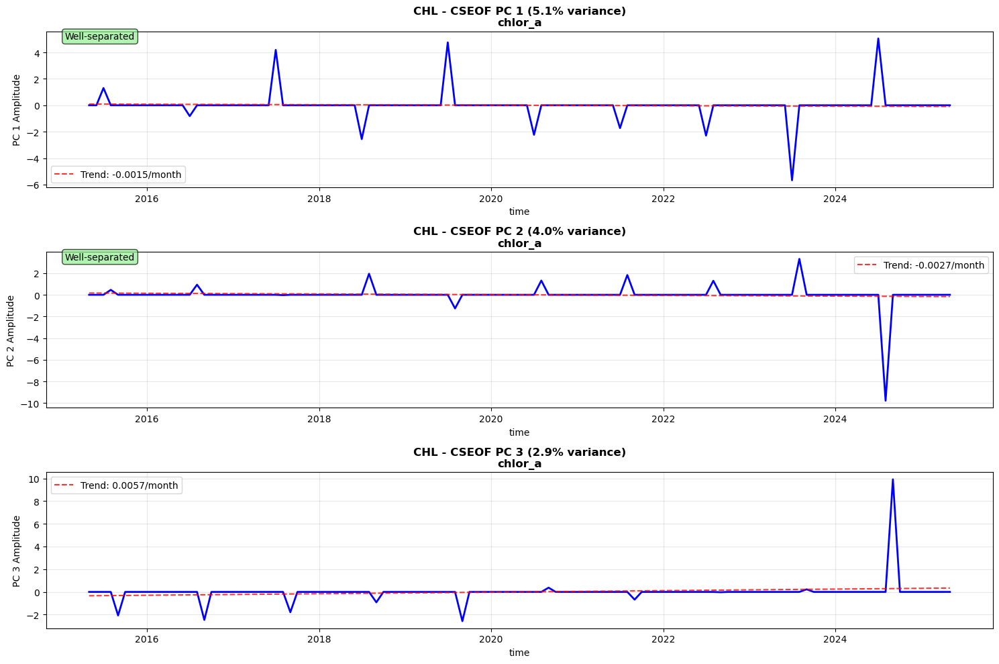


Generating CSEOF plots for OSTIA...


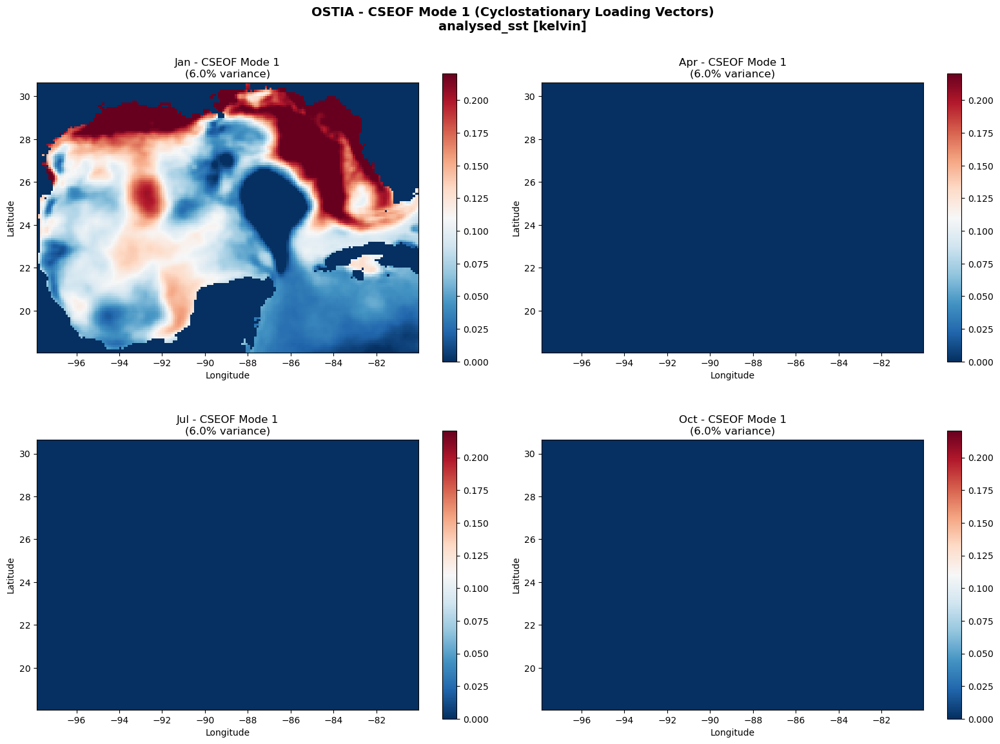

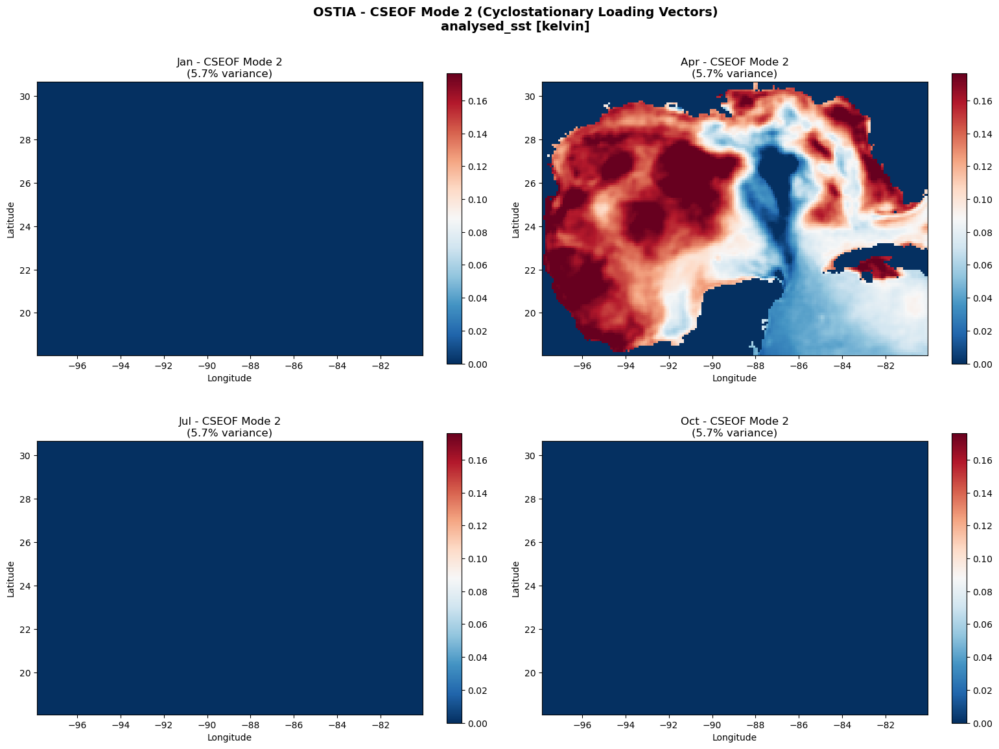

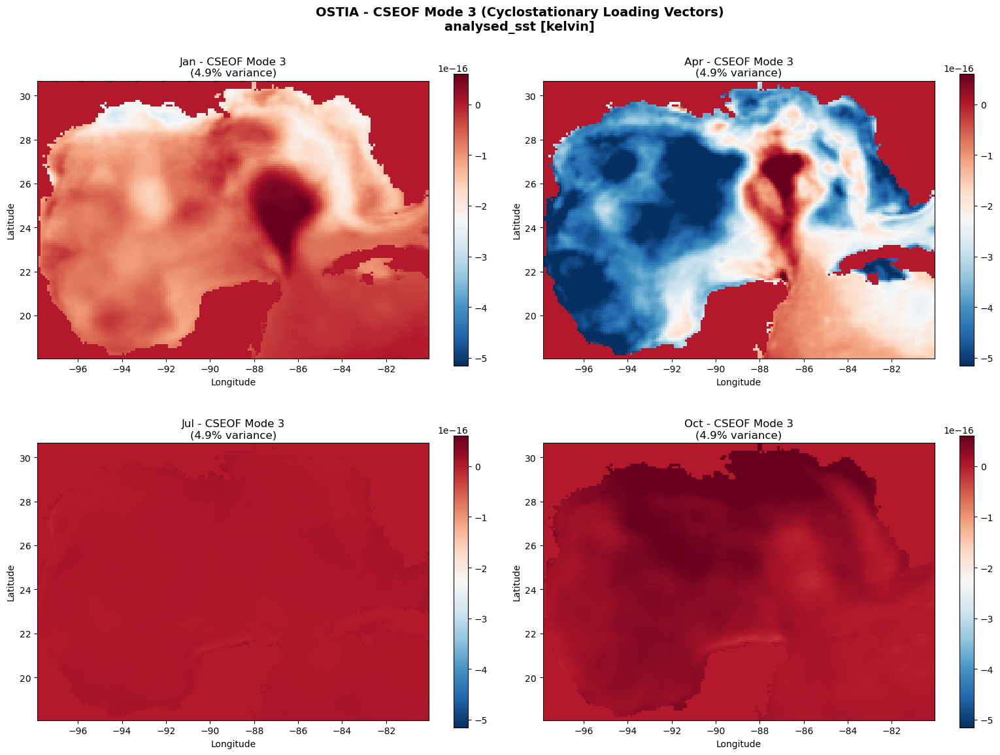

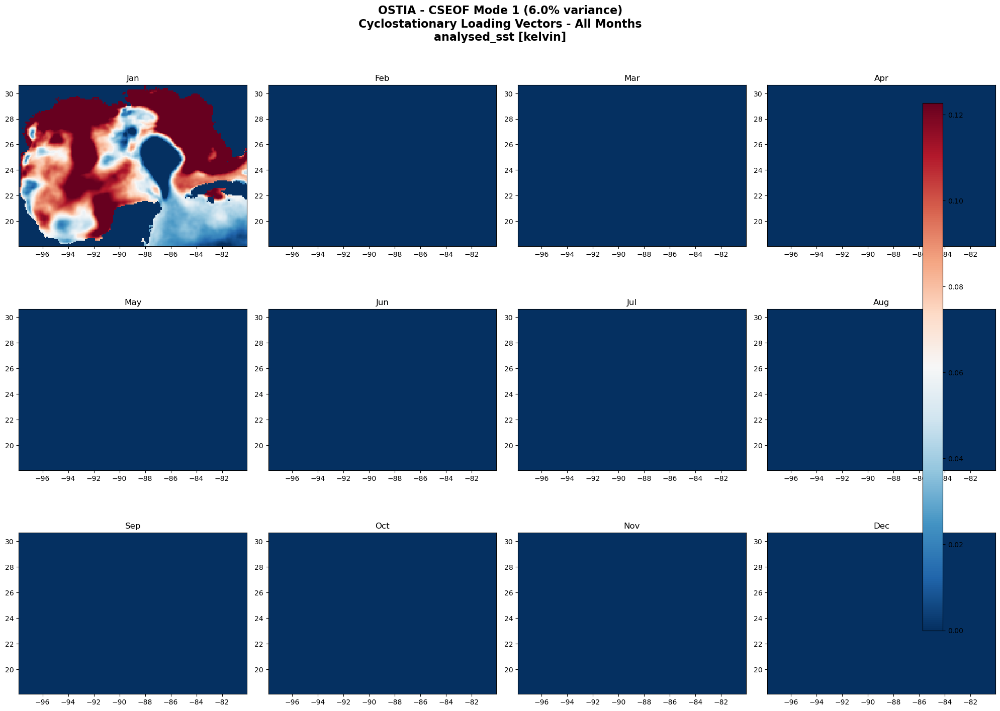

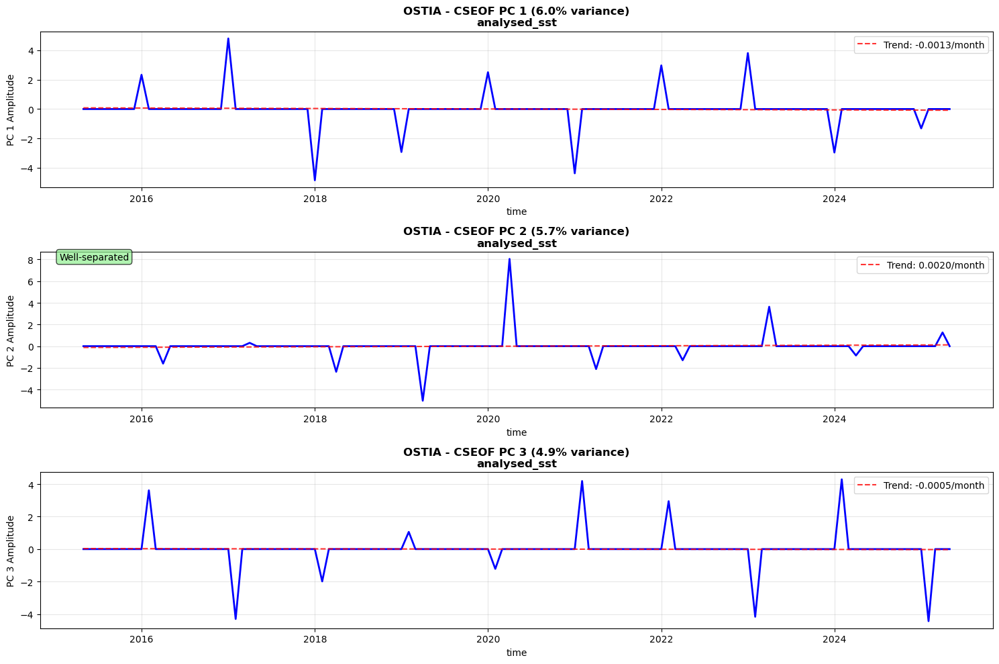


Generating CSEOF plots for SMAP...


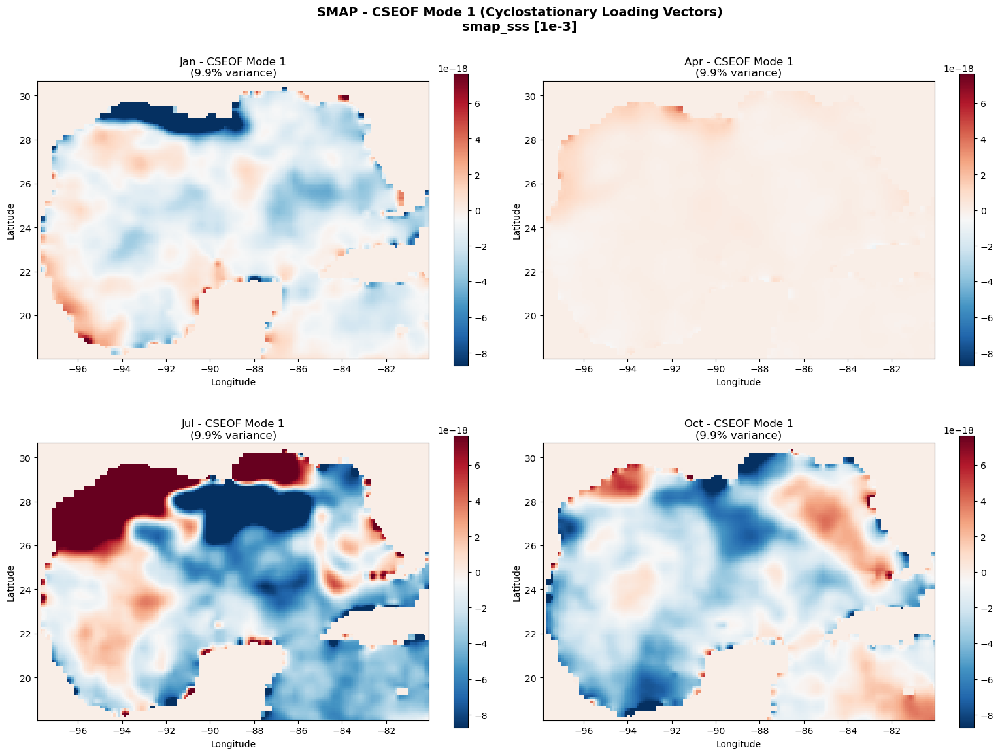

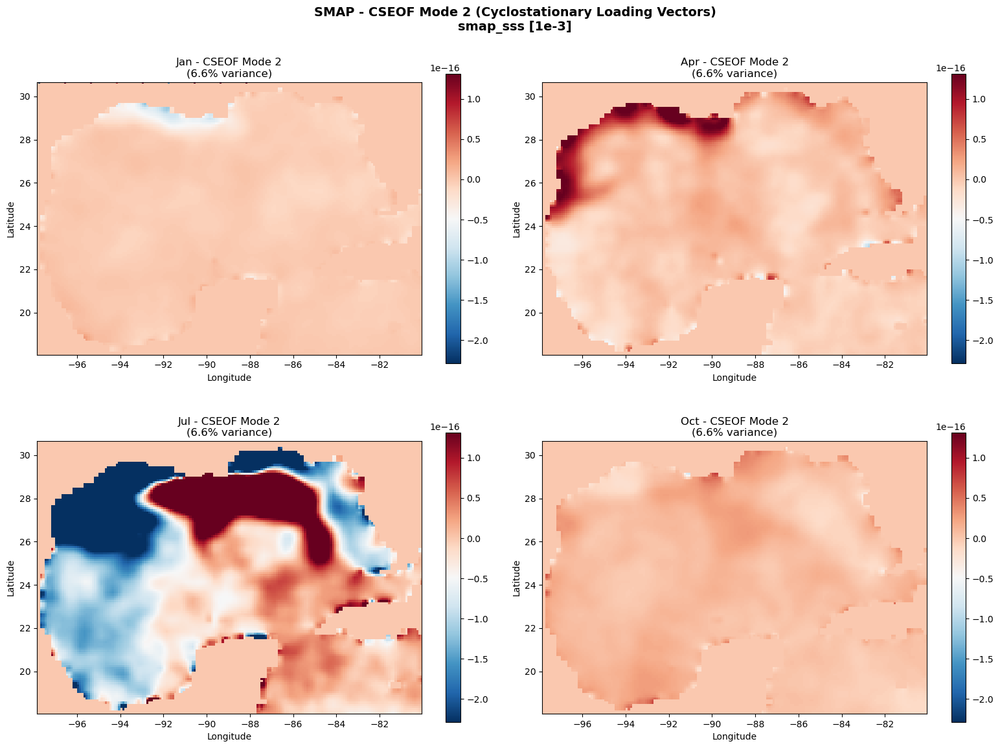

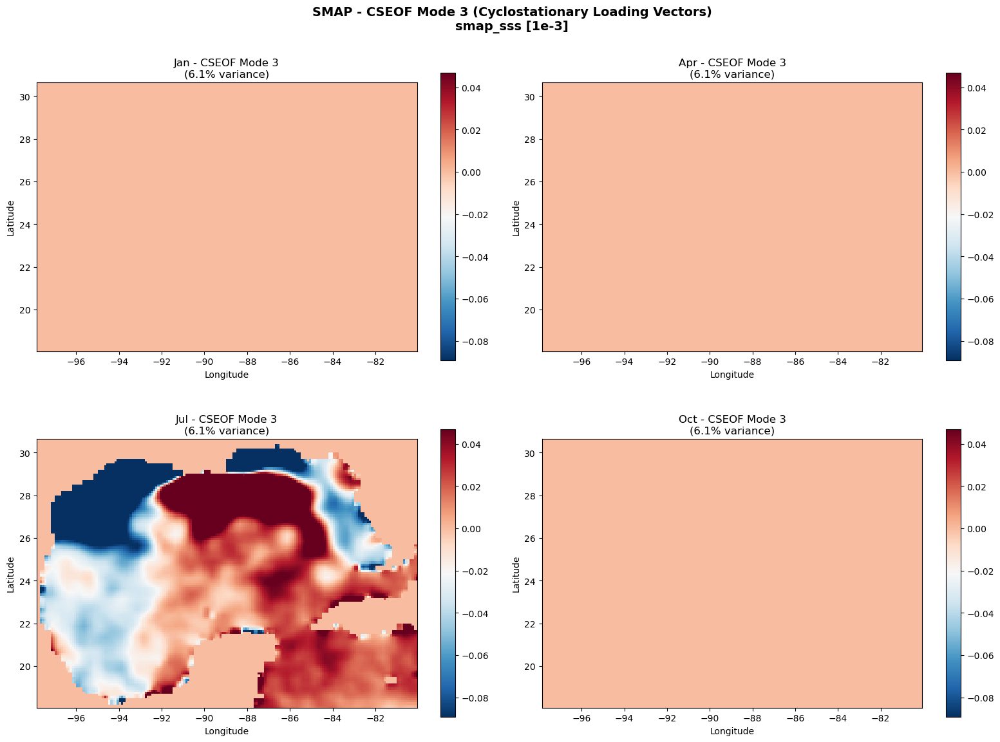

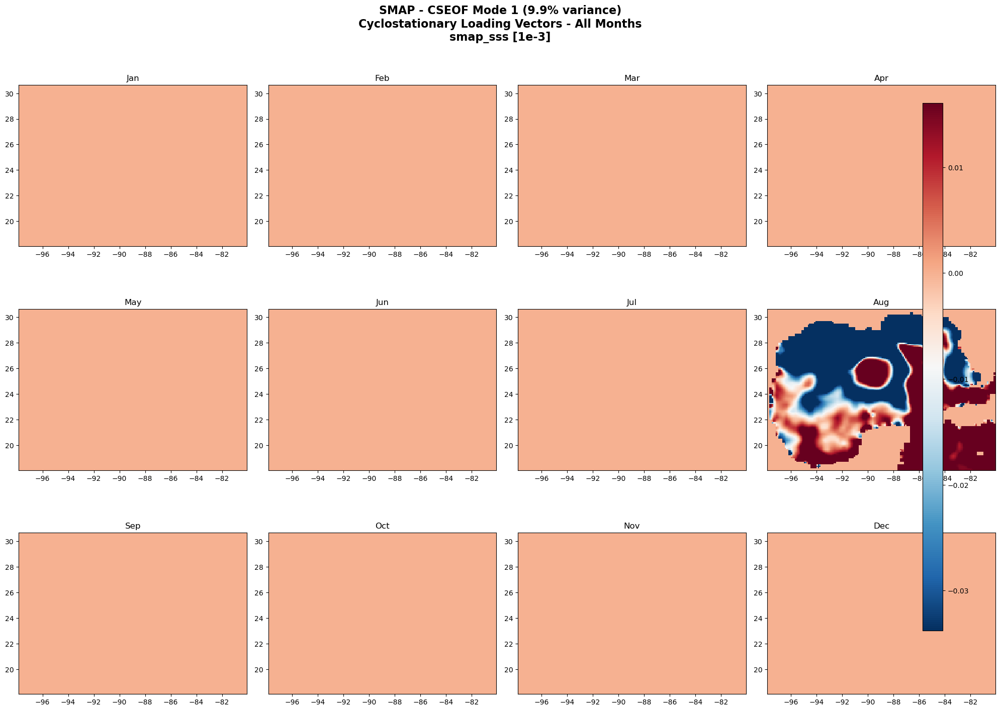

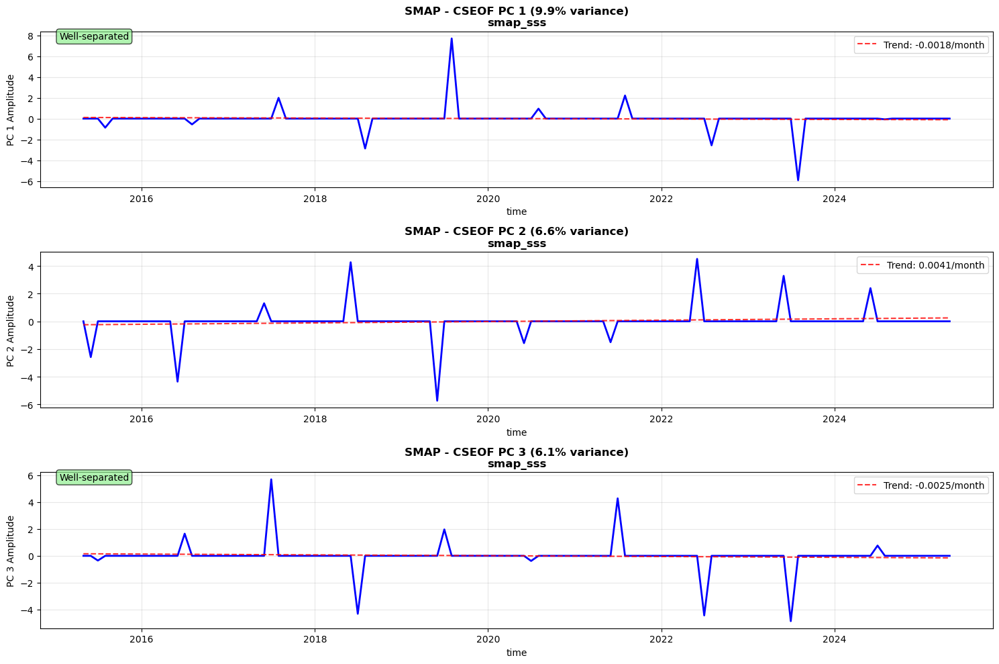


CSEOF ANALYSIS COMPLETE
Results show how spatial patterns evolve throughout the year
Each mode captures seasonally-dependent variability patterns


In [12]:
def plot_monthly_climatology(self, dataset_type, figsize=(15, 8)):
        """Plot monthly climatology that was removed during preprocessing"""
        if dataset_type not in self.processed_data:
            print(f"Dataset {dataset_type} not found")
            return
            
        data_info = self.processed_data[dataset_type]
        monthly_clim = data_info['monthly_climatology']
        
        # Create subplot for each month
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        # Get all climatology data for consistent scaling
        all_clim_data = []
        for month in range(1, 13):
            clim_data = monthly_clim.sel(month=month)
            all_clim_data.append(clim_data.values.flatten())
        
        all_data = np.concatenate(all_clim_data)
        vmin, vmax = np.nanpercentile(all_data, [2, 98])
        
        for i, month in enumerate(range(1, 13)):
            ax = axes[i]
            clim_data = monthly_clim.sel(month=month)
            
            im = clim_data.plot(ax=ax, cmap='viridis', add_colorbar=False, vmin=vmin, vmax=vmax)
            ax.set_title(f'{months[i]}')
            ax.set_xlabel('')
            ax.set_ylabel('')
            
        plt.suptitle(f'{dataset_type} Monthly Climatology (Removed for CSEOF)\n{data_info["variable_name"]} [{data_info["units"]}]', 
                    fontsize=14, weight='bold')
        plt.tight_layout()
        plt.show()
    
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from eofs.xarray import Eof
from eofs.tools.standard import correlation_map, covariance_map
import warnings
warnings.filterwarnings('ignore')

class GulfCyclostationaryEOF:
    """
    Cyclostationary EOF analysis for Gulf region geospatial time series
    Following Kim & North (1997) methodology - decomposes fields into 
    slow modulations of phase-locked annual cycles
    """
    
    def __init__(self, filepaths):
        """
        Initialize with Gulf region netCDF file paths
        
        Parameters:
        -----------
        filepaths : list
            List of netCDF file paths for Gulf region data
        """
        self.filepaths = filepaths
        self.datasets = {}
        self.processed_data = {}
        self.cseof_results = {}
        self.missing_data_stats = {}
        
    def load_data(self):
        """Load Gulf region netCDF files and identify variables"""
        print("Loading Gulf region datasets...")
        print("=" * 50)
        
        # Variable mapping for Gulf datasets
        variable_mapping = {
            'CHL': 'chlor_a',
            'OSTIA': 'analysed_sst', 
            'SMAP': 'smap_sss'
        }
        
        for i, filepath in enumerate(self.filepaths):
            try:
                # Load dataset
                ds = xr.open_dataset(filepath, chunks={'StdTime': 50})
                
                # Identify dataset type from filename
                dataset_type = None
                for key in variable_mapping.keys():
                    if key in filepath:
                        dataset_type = key
                        break
                
                if dataset_type is None:
                    print(f"Could not identify dataset type for {filepath}")
                    continue
                    
                var_name = variable_mapping[dataset_type]
                
                if var_name not in ds.data_vars:
                    print(f"Variable {var_name} not found in {filepath}")
                    continue
                
                # Extract data array and standardize coordinates
                data_array = ds[var_name]
                if 'StdTime' in data_array.dims:
                    data_array = data_array.rename({'StdTime': 'time'})
                
                self.datasets[dataset_type] = {
                    'data': data_array,
                    'variable_name': var_name,
                    'filepath': filepath,
                    'units': data_array.attrs.get('units', 'unknown')
                }
                
                print(f"\n{dataset_type} Dataset ({var_name}):")
                filename = filepath.split('\\')[-1]
                print(f"  File: {filename}")
                print(f"  Shape: {data_array.shape}")
                print(f"  Time range: {data_array.time.values[0]} to {data_array.time.values[-1]}")
                print(f"  Spatial extent: {data_array.lat.values.min():.2f}°N - {data_array.lat.values.max():.2f}°N")
                print(f"                  {data_array.lon.values.min():.2f}°E - {data_array.lon.values.max():.2f}°E")
                
                # Calculate missing data statistics
                total_points = data_array.size
                valid_points = (~np.isnan(data_array)).sum().values
                missing_pct = (1 - valid_points/total_points) * 100
                print(f"  Missing data: {missing_pct:.1f}% ({total_points-valid_points:,} / {total_points:,} points)")
                
                self.missing_data_stats[dataset_type] = {
                    'total_points': total_points,
                    'valid_points': valid_points,
                    'missing_percentage': missing_pct
                }
                
            except Exception as e:
                print(f"Error loading {filepath}: {e}")
    
    def analyze_missing_data(self):
        """Analyze spatial patterns of missing data"""
        print("\n" + "=" * 50)
        print("MISSING DATA ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            data = data_info['data']
            print(f"\n{dataset_type} ({data_info['variable_name']}):")
            
            # Calculate missing data percentage for each spatial location
            missing_by_location = np.isnan(data).mean(dim='time') * 100
            
            # Statistics
            locations_over_50pct = (missing_by_location > 50).sum().values
            total_locations = missing_by_location.size
            
            print(f"  Spatial locations with >50% missing: {locations_over_50pct} / {total_locations}")
            print(f"  Percentage of locations to remove: {locations_over_50pct/total_locations*100:.1f}%")
            print(f"  Missing data range: {missing_by_location.min().values:.1f}% - {missing_by_location.max().values:.1f}%")
            print(f"  Mean missing data per location: {missing_by_location.mean().values:.1f}%")
            
            # Store missing data mask
            self.missing_data_stats[dataset_type]['missing_by_location'] = missing_by_location
            self.missing_data_stats[dataset_type]['valid_locations_mask'] = missing_by_location <= 50
    
    def preprocess_data(self):
        """
        Preprocess data for CSEOF:
        1. Remove locations with >50% missing data
        2. Apply seasonal climatological interpolation
        3. Remove climatological mean for each month separately
        4. Apply area weighting
        """
        print("\n" + "=" * 50)
        print("CSEOF DATA PREPROCESSING")
        print("=" * 50)
        
        for dataset_type, data_info in self.datasets.items():
            print(f"\nProcessing {dataset_type} ({data_info['variable_name']})...")
            
            data = data_info['data']
            
            # Step 1: Remove locations with >50% missing data
            missing_mask = self.missing_data_stats[dataset_type]['missing_by_location'] > 50
            data_masked = data.where(~missing_mask)
            
            locations_removed = missing_mask.sum().values
            total_locations = missing_mask.size
            print(f"Removed {locations_removed} locations ({locations_removed/total_locations*100:.1f}%) with >50% missing data")
            
            # Step 2: Seasonal climatological interpolation
            print("Applying seasonal interpolation...")
            data_interpolated = self._seasonal_interpolation(data_masked)
            
            # Step 3: Remove climatological mean for each month (as per paper methodology)
            print("Removing monthly climatological mean...")
            monthly_climatology = data_interpolated.groupby('time.month').mean(dim='time')
            data_anomalies = data_interpolated.groupby('time.month') - monthly_climatology
            
            # Step 4: Apply area weighting (as mentioned in the paper)
            print("Applying area weighting...")
            lat_weights = np.sqrt(np.cos(np.deg2rad(data_anomalies.lat)))
            data_weighted = data_anomalies * lat_weights
            
            # Store processed data
            self.processed_data[dataset_type] = {
                'data': data_weighted,
                'data_anomalies': data_anomalies,
                'monthly_climatology': monthly_climatology,
                'original_data': data,
                'variable_name': data_info['variable_name'],
                'units': data_info['units'],
                'lat_weights': lat_weights
            }
            
            print(f"CSEOF preprocessing complete for {dataset_type}")
    
    def _seasonal_interpolation(self, data):
        """Apply seasonal climatological interpolation"""
        # Create monthly climatology (mean for each month across all years)
        monthly_clim = data.groupby('time.month').mean(dim='time')
        
        # Apply interpolation month by month
        data_filled = data.copy()
        
        for month in range(1, 13):
            month_mask = data.time.dt.month == month
            if month_mask.any():
                month_data = data.isel(time=month_mask)
                month_clim = monthly_clim.sel(month=month)
                
                # Fill NaN values with climatology for this month
                filled_month = month_data.fillna(month_clim)
                data_filled.loc[dict(time=month_mask)] = filled_month
        
        return data_filled
    
    def create_cseof_matrix(self, dataset_type):
        """
        Create CSEOF data matrix following Kim & North (1997) methodology
        Arrange data as [12*space, time] matrix where each month gets separate spatial rows
        """
        print(f"\nCreating CSEOF data matrix for {dataset_type}...")
        
        data = self.processed_data[dataset_type]['data']
        
        # Get dimensions
        n_time = data.shape[0]
        n_lat = data.shape[1] 
        n_lon = data.shape[2]
        n_space = n_lat * n_lon
        
        # Create the CSEOF matrix: [12*space, time]
        # Each month gets its own set of spatial rows
        cseof_matrix = np.zeros((12 * n_space, n_time))
        
        # Fill the matrix
        for t in range(n_time):
            month_idx = data.time.dt.month.values[t] - 1  # Convert to 0-based indexing
            
            # Get spatial data for this time step
            spatial_data = data.isel(time=t).values.flatten()
            
            # Put data in the rows corresponding to this month
            start_row = month_idx * n_space
            end_row = (month_idx + 1) * n_space
            cseof_matrix[start_row:end_row, t] = spatial_data
        
        # Handle NaN values
        cseof_matrix = np.nan_to_num(cseof_matrix, nan=0.0)
        
        print(f"CSEOF matrix shape: {cseof_matrix.shape}")
        print(f"Original data shape: {data.shape}")
        print(f"Matrix structure: 12 months × {n_space} spatial points = {12 * n_space} rows")
        
        return cseof_matrix, (n_lat, n_lon)
    
    def perform_cseof_analysis(self, n_modes=10):
        """
        Perform Cyclostationary EOF analysis following Kim & North (1997)
        """
        print("\n" + "=" * 50)
        print("CYCLOSTATIONARY EOF ANALYSIS")
        print("=" * 50)
        
        for dataset_type, data_info in self.processed_data.items():
            print(f"\nPerforming CSEOF analysis: {dataset_type} ({data_info['variable_name']})...")
            
            # Create CSEOF data matrix
            cseof_matrix, spatial_shape = self.create_cseof_matrix(dataset_type)
            
            # Convert to xarray for EOF analysis
            time_coord = data_info['data'].time
            space_coord = np.arange(cseof_matrix.shape[0])
            
            cseof_xr = xr.DataArray(
                cseof_matrix.T,  # Transpose to [time, space*12] for eofs package
                dims=['time', 'space'],
                coords={'time': time_coord, 'space': space_coord}
            )
            
            try:
                # Create EOF solver
                solver = Eof(cseof_xr, weights=None)
                
                # Compute EOFs and PCs
                eofs = solver.eofs(neofs=n_modes, eofscaling=2)
                pcs = solver.pcs(npcs=n_modes, pcscaling=1)
                eigenvalues = solver.eigenvalues(neigs=n_modes)
                variance_fractions = solver.varianceFraction(neigs=n_modes)
                
                # Store results
                self.cseof_results[dataset_type] = {
                    'eofs': eofs,
                    'pcs': pcs,
                    'eigenvalues': eigenvalues,
                    'variance_fractions': variance_fractions,
                    'solver': solver,
                    'spatial_shape': spatial_shape,  # (n_lat, n_lon)
                    'cseof_matrix': cseof_matrix,
                    'variable_name': data_info['variable_name'],
                    'units': data_info['units'],
                    'lat_weights': data_info['lat_weights']
                }
                
                print(f"CSEOF analysis complete")
                print(f"First 5 modes explain: {variance_fractions.values[:5] * 100}")
                print(f"Cumulative variance (first 5): {np.cumsum(variance_fractions.values[:5]) * 100}")
                
                # Apply North's criterion for mode significance
                self._apply_north_criterion(dataset_type)
                
            except Exception as e:
                print(f"Error in CSEOF analysis: {e}")
    
    def _apply_north_criterion(self, dataset_type):
        """Apply North's criterion to test mode separation"""
        results = self.cseof_results[dataset_type]
        eigenvalues = results['eigenvalues'].values
        n_samples = len(results['pcs'].time)
        
        # Calculate North's criterion: delta_lambda = lambda * sqrt(2/N)
        delta_lambda = eigenvalues * np.sqrt(2 / n_samples)
        
        # Test for well-separated modes
        well_separated = []
        for i in range(len(eigenvalues) - 1):
            separation = eigenvalues[i] - eigenvalues[i + 1]
            criterion = delta_lambda[i]
            well_separated.append(separation > criterion)
        
        results['north_criterion'] = delta_lambda
        results['well_separated'] = well_separated
        
        n_separated = sum(well_separated) + 1  # +1 because we compare adjacent pairs
        print(f"North's criterion: First {n_separated} modes are statistically well-separated")
    
    def extract_monthly_pattern(self, dataset_type, mode, month):
        """
        Extract the spatial pattern for a specific mode and month
        This is the Cyclostationary Loading Vector (CSLV) for that month
        """
        if dataset_type not in self.cseof_results:
            return None
            
        results = self.cseof_results[dataset_type]
        eof_vector = results['eofs'].isel(mode=mode).values
        n_lat, n_lon = results['spatial_shape']
        n_space = n_lat * n_lon
        
        # Extract the pattern for the specified month (0-based indexing)
        month_idx = month - 1
        start_idx = month_idx * n_space
        end_idx = (month_idx + 1) * n_space
        
        month_pattern = eof_vector[start_idx:end_idx].reshape(n_lat, n_lon)
        
        # Remove area weighting for visualization
        lat_weights = results['lat_weights']
        # Broadcast lat_weights to match the 2D pattern shape
        lat_weights_2d = np.broadcast_to(lat_weights.values[:, np.newaxis], month_pattern.shape)
        month_pattern = month_pattern / lat_weights_2d
        
        # Create xarray with proper coordinates
        original_data = self.processed_data[dataset_type]['data']
        
        spatial_pattern = xr.DataArray(
            month_pattern,
            dims=['lat', 'lon'],
            coords={'lat': original_data.lat, 'lon': original_data.lon}
        )
        
        return spatial_pattern
    
    def plot_cseof_mode(self, dataset_type, mode=0, months=[1, 4, 7, 10], figsize=(16, 12)):
        """
        Plot CSEOF mode patterns for different months (Cyclostationary Loading Vectors)
        """
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        n_months = len(months)
        
        fig, axes = plt.subplots(2, 2, figsize=figsize)
        axes = axes.flatten()
        
        month_names = ['', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        # Get all patterns for this mode to determine common scale
        all_patterns = []
        for month in months:
            pattern = self.extract_monthly_pattern(dataset_type, mode, month)
            if pattern is not None:
                all_patterns.append(pattern.values.flatten())
        
        if all_patterns:
            all_data = np.concatenate(all_patterns)
            vmin, vmax = np.nanpercentile(all_data, [2, 98])  # Robust scaling
            
            for i, month in enumerate(months):
                ax = axes[i]
                
                # Extract CSLV for this month
                spatial_pattern = self.extract_monthly_pattern(dataset_type, mode, month)
                
                if spatial_pattern is not None:
                    # Use pcolormesh for proper geographic plotting
                    im = ax.pcolormesh(spatial_pattern.lon, spatial_pattern.lat, spatial_pattern,
                                     cmap='RdBu_r', vmin=vmin, vmax=vmax, shading='auto')
                    
                    # Set proper axis limits to data bounds
                    ax.set_xlim(spatial_pattern.lon.min(), spatial_pattern.lon.max())
                    ax.set_ylim(spatial_pattern.lat.min(), spatial_pattern.lat.max())
                    
                    # Add title
                    variance_pct = results['variance_fractions'].values[mode] * 100
                    ax.set_title(f'{month_names[month]} - CSEOF Mode {mode+1}\n({variance_pct:.1f}% variance)')
                    
                    # Add colorbar
                    plt.colorbar(im, ax=ax, shrink=0.8)
                
                ax.set_xlabel('Longitude')
                ax.set_ylabel('Latitude')
                ax.set_aspect('equal')
        
        plt.suptitle(f'{dataset_type} - CSEOF Mode {mode+1} (Cyclostationary Loading Vectors)\n'
                    f'{results["variable_name"]} [{results["units"]}]', 
                    fontsize=14, weight='bold')
        plt.tight_layout()
        plt.show()
    
    def plot_all_monthly_patterns(self, dataset_type, mode=0, figsize=(20, 15)):
        """
        Plot all 12 monthly patterns for a CSEOF mode with consistent scaling
        """
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                      'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        # Get all patterns for consistent scaling
        all_patterns = []
        patterns = []
        for month in range(1, 13):
            pattern = self.extract_monthly_pattern(dataset_type, mode, month)
            if pattern is not None:
                patterns.append(pattern)
                all_patterns.append(pattern.values.flatten())
        
        if all_patterns:
            all_data = np.concatenate(all_patterns)
            vmin, vmax = np.nanpercentile(all_data, [2, 98])  # Robust scaling
            
            for month in range(1, 13):
                ax = axes[month-1]
                
                # Extract CSLV for this month
                spatial_pattern = self.extract_monthly_pattern(dataset_type, mode, month)
                
                if spatial_pattern is not None:
                    # Use pcolormesh for proper geographic plotting
                    im = ax.pcolormesh(spatial_pattern.lon, spatial_pattern.lat, spatial_pattern,
                                     cmap='RdBu_r', vmin=vmin, vmax=vmax, shading='auto')
                    
                    # Set proper axis limits to data bounds
                    ax.set_xlim(spatial_pattern.lon.min(), spatial_pattern.lon.max())
                    ax.set_ylim(spatial_pattern.lat.min(), spatial_pattern.lat.max())
                    
                    ax.set_title(f'{month_names[month-1]}')
                    
                ax.set_xlabel('')
                ax.set_ylabel('')
                ax.set_aspect('equal')
            
            # Add overall title and colorbar
            variance_pct = results['variance_fractions'].values[mode] * 100
            plt.suptitle(f'{dataset_type} - CSEOF Mode {mode+1} ({variance_pct:.1f}% variance)\n'
                        f'Cyclostationary Loading Vectors - All Months\n'
                        f'{results["variable_name"]} [{results["units"]}]', 
                        fontsize=16, weight='bold')
            
            # Add a common colorbar
            fig.subplots_adjust(right=0.9)
            cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
            plt.colorbar(im, cax=cbar_ax)
        
        plt.tight_layout()
        plt.show()
    
    def plot_principal_components(self, dataset_type, modes=[0, 1, 2], figsize=(15, 10)):
        """Plot principal components time series"""
        if dataset_type not in self.cseof_results:
            print(f"Dataset {dataset_type} not found in CSEOF results")
            return
        
        results = self.cseof_results[dataset_type]
        pcs = results['pcs']
        
        n_modes = len(modes)
        fig, axes = plt.subplots(n_modes, 1, figsize=figsize)
        if n_modes == 1:
            axes = [axes]
        
        for i, mode in enumerate(modes):
            if mode >= pcs.shape[1]:
                continue
            
            ax = axes[i]
            
            # Plot PC time series
            pc_data = pcs.isel(mode=mode)
            pc_data.plot(ax=ax, linewidth=2, color='blue')
            
            # Add variance info
            variance_pct = results['variance_fractions'].values[mode] * 100
            var_name = results['variable_name']
            
            ax.set_title(f'{dataset_type} - CSEOF PC {mode + 1} ({variance_pct:.1f}% variance)\n'
                        f'{var_name}', fontsize=12, weight='bold')
            ax.set_ylabel(f'PC {mode + 1} Amplitude', fontsize=10)
            ax.grid(True, alpha=0.3)
            
            # Add trend line
            time_numeric = np.arange(len(pc_data))
            trend_coef = np.polyfit(time_numeric, pc_data.values, 1)
            trend_line = np.polyval(trend_coef, time_numeric)
            ax.plot(pc_data.time, trend_line, 'r--', alpha=0.8, 
                   label=f'Trend: {trend_coef[0]:.4f}/month')
            ax.legend()
            
            # Mark well-separated modes
            if mode < len(results['well_separated']) and results['well_separated'][mode]:
                ax.text(0.02, 0.95, 'Well-separated', transform=ax.transAxes, 
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgreen", alpha=0.7))
        
        plt.tight_layout()
        plt.show()
    
    def plot_explained_variance(self, figsize=(15, 5)):
        """Plot explained variance for CSEOF analysis"""
        n_datasets = len(self.cseof_results)
        if n_datasets == 0:
            print("No CSEOF results to plot")
            return
            
        fig, axes = plt.subplots(1, n_datasets, figsize=figsize)
        if n_datasets == 1:
            axes = [axes]
        
        for i, (dataset_type, results) in enumerate(self.cseof_results.items()):
            ax = axes[i]
            
            variance_fractions = results['variance_fractions'].values * 100
            cumulative_variance = np.cumsum(variance_fractions)
            
            # Plot individual and cumulative variance
            bars = ax.bar(range(1, len(variance_fractions) + 1), variance_fractions, 
                         alpha=0.7, label='Individual', color='skyblue')
            line = ax.plot(range(1, len(variance_fractions) + 1), cumulative_variance, 
                          'ro-', label='Cumulative', linewidth=2, markersize=6)
            
            # Highlight well-separated modes
            well_separated = results.get('well_separated', [])
            for j in range(min(len(well_separated), len(bars))):
                if well_separated[j]:
                    bars[j].set_color('lightgreen')
                    bars[j].set_alpha(0.9)
            
            # Formatting
            ax.set_xlabel('CSEOF Mode', fontsize=12)
            ax.set_ylabel('Explained Variance (%)', fontsize=12)
            var_name = results['variable_name']
            ax.set_title(f'{dataset_type} ({var_name})\nCSEOF Explained Variance', fontsize=12, weight='bold')
            ax.legend()
            ax.grid(True, alpha=0.3)
            
            # Add percentage labels on bars for first few modes
            for j, bar in enumerate(bars[:5]):
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2., height,
                       f'{height:.1f}%', ha='center', va='bottom', fontsize=10)
        
        plt.tight_layout()
        plt.show()
    
    def cross_correlation_analysis(self):
        """
        Perform cross-correlation analysis between CSEOF principal components
        """
        if len(self.cseof_results) < 2:
            print("Need at least 2 variables for cross-correlation analysis")
            return
            
        print("\n" + "=" * 50)
        print("CSEOF CROSS-CORRELATION ANALYSIS")
        print("=" * 50)
        
        # Define pairs for correlation analysis
        correlation_pairs = []
        dataset_types = list(self.cseof_results.keys())
        
        for i, type1 in enumerate(dataset_types):
            for j, type2 in enumerate(dataset_types[i+1:], i+1):
                correlation_pairs.append((type1, type2))
        
        for type1, type2 in correlation_pairs:
            print(f"\n{type1} vs {type2} CSEOF Correlation Analysis:")
            print("-" * 50)
            
            pcs1 = self.cseof_results[type1]['pcs']
            pcs2 = self.cseof_results[type2]['pcs']
            
            # Analyze first 5 modes
            n_modes = min(5, pcs1.shape[1], pcs2.shape[1])
            correlations = np.zeros((n_modes, n_modes))
            
            for mode1 in range(n_modes):
                for mode2 in range(n_modes):
                    pc1 = pcs1.isel(mode=mode1)
                    pc2 = pcs2.isel(mode=mode2)
                    
                    # Temporal correlation
                    temp_corr = np.corrcoef(pc1.values, pc2.values)[0, 1]
                    correlations[mode1, mode2] = temp_corr
                    
                    if abs(temp_corr) > 0.5:
                        var1_pct = self.cseof_results[type1]['variance_fractions'].values[mode1] * 100
                        var2_pct = self.cseof_results[type2]['variance_fractions'].values[mode2] * 100
                        print(f"  Mode {mode1+1} vs Mode {mode2+1}: r={temp_corr:.3f} "
                              f"({var1_pct:.1f}% & {var2_pct:.1f}% variance)")
            
            # Store correlation matrix for plotting
            self._plot_correlation_matrix(type1, type2, correlations)
    
    def _plot_correlation_matrix(self, type1, type2, correlations, figsize=(8, 6)):
        """Plot correlation matrix between two variables' CSEOF modes"""
        fig, ax = plt.subplots(figsize=figsize)
        
        im = ax.imshow(correlations, cmap='RdBu_r', vmin=-1, vmax=1, aspect='auto')
        
        # Set ticks and labels
        n_modes = correlations.shape[0]
        ax.set_xticks(range(n_modes))
        ax.set_yticks(range(n_modes))
        ax.set_xticklabels([f'Mode {i+1}' for i in range(n_modes)])
        ax.set_yticklabels([f'Mode {i+1}' for i in range(n_modes)])
        
        # Add correlation values as text
        for i in range(n_modes):
            for j in range(n_modes):
                text = ax.text(j, i, f'{correlations[i, j]:.2f}',
                             ha="center", va="center", color="black" if abs(correlations[i, j]) < 0.5 else "white")
        
        ax.set_xlabel(f'{type2} CSEOF Modes')
        ax.set_ylabel(f'{type1} CSEOF Modes')
        ax.set_title(f'CSEOF PC Correlations: {type1} vs {type2}')
        
        # Add colorbar
        plt.colorbar(im, ax=ax, label='Correlation Coefficient')
        plt.tight_layout()
        plt.show()
    
    def plot_variable_correlations(self, figsize=(12, 8)):
        """
        Plot correlations between original variables (not CSEOF modes)
        """
        if len(self.processed_data) < 2:
            print("Need at least 2 variables for correlation analysis")
            return
        
        print("\n" + "=" * 50)
        print("ORIGINAL VARIABLE CORRELATIONS")
        print("=" * 50)
        
        # Collect time series data for each variable
        variable_data = {}
        for dataset_type, data_info in self.processed_data.items():
            # Calculate spatial mean time series
            data = data_info['data_anomalies']  # Use anomalies without area weighting
            spatial_mean = data.mean(dim=['lat', 'lon'])
            variable_data[dataset_type] = spatial_mean.values
        
        # Create correlation matrix
        dataset_types = list(variable_data.keys())
        n_vars = len(dataset_types)
        corr_matrix = np.zeros((n_vars, n_vars))
        
        for i, type1 in enumerate(dataset_types):
            for j, type2 in enumerate(dataset_types):
                corr_coef = np.corrcoef(variable_data[type1], variable_data[type2])[0, 1]
                corr_matrix[i, j] = corr_coef
                if i != j:
                    print(f"{type1} vs {type2}: r = {corr_coef:.3f}")
        
        # Plot correlation matrix
        fig, ax = plt.subplots(figsize=figsize)
        
        im = ax.imshow(corr_matrix, cmap='RdBu_r', vmin=-1, vmax=1)
        
        # Set ticks and labels
        ax.set_xticks(range(n_vars))
        ax.set_yticks(range(n_vars))
        ax.set_xticklabels(dataset_types)
        ax.set_yticklabels(dataset_types)
        
        # Add correlation values as text
        for i in range(n_vars):
            for j in range(n_vars):
                text = ax.text(j, i, f'{corr_matrix[i, j]:.3f}',
                             ha="center", va="center", 
                             color="white" if abs(corr_matrix[i, j]) > 0.5 else "black")
        
        ax.set_title('Gulf Region Variable Correlations\n(Spatial Mean Time Series)')
        plt.colorbar(im, ax=ax, label='Correlation Coefficient')
        plt.tight_layout()
        plt.show()
        
        return corr_matrix
    
    def plot_monthly_climatology(self, dataset_type, figsize=(15, 8)):
        """Plot monthly climatology that was removed during preprocessing"""
        if dataset_type not in self.processed_data:
            print(f"Dataset {dataset_type} not found")
            return
            
        data_info = self.processed_data[dataset_type]
        monthly_clim = data_info['monthly_climatology']
        
        # Create subplot for each month
        fig, axes = plt.subplots(3, 4, figsize=figsize)
        axes = axes.flatten()
        
        months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        
        # Get all climatology data for consistent scaling
        all_clim_data = []
        for month in range(1, 13):
            clim_data = monthly_clim.sel(month=month)
            all_clim_data.append(clim_data.values.flatten())
        
        all_data = np.concatenate(all_clim_data)
        vmin, vmax = np.nanpercentile(all_data, [2, 98])
        
        for i, month in enumerate(range(1, 13)):
            ax = axes[i]
            clim_data = monthly_clim.sel(month=month)
            
            # Use pcolormesh for proper geographic plotting
            im = ax.pcolormesh(clim_data.lon, clim_data.lat, clim_data,
                             cmap='viridis', vmin=vmin, vmax=vmax, shading='auto')
            
            # Set proper axis limits to data bounds
            ax.set_xlim(clim_data.lon.min(), clim_data.lon.max())
            ax.set_ylim(clim_data.lat.min(), clim_data.lat.max())
            
            ax.set_title(f'{months[i]}')
            ax.set_xlabel('')
            ax.set_ylabel('')
            ax.set_aspect('equal')
            
        plt.suptitle(f'{dataset_type} Monthly Climatology (Removed for CSEOF)\n{data_info["variable_name"]} [{data_info["units"]}]', 
                    fontsize=14, weight='bold')
        
        # Add common colorbar
        fig.subplots_adjust(right=0.9)
        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
        plt.colorbar(im, cax=cbar_ax)
        
        plt.tight_layout()
        plt.show()

# Example usage
if __name__ == "__main__":
    # Gulf region file paths
    filepaths = [
        r"C:\Users\jspier\pre\study_data\Gulf\CHL_MO_Gulf_10.nc4",
        r"C:\Users\jspier\pre\study_data\Gulf\OSTIA_MO_Gulf_10.nc4", 
        r"C:\Users\jspier\pre\study_data\Gulf\SMAP_MO_Gulf_10.nc4"
    ]
    
    print("Gulf Region CYCLOSTATIONARY EOF Analysis")
    print("=" * 60)
    print("Method: Kim & North (1997) CSEOF")
    print("Decomposes fields into slow modulations of phase-locked annual cycles")
    print("Each mode has 12 different spatial patterns (one per month)")
    print("Time period: May 2015 - May 2025 (121 monthly time steps)")
    print("Study region: Gulf of Mexico")
    print()
    
    # Initialize analysis
    cseof_analysis = GulfCyclostationaryEOF(filepaths)
    
    # Step 1: Load data
    cseof_analysis.load_data()
    
    # Step 2: Analyze missing data patterns
    cseof_analysis.analyze_missing_data()
    
    # Step 3: Preprocess data for CSEOF
    cseof_analysis.preprocess_data()
    
    # Step 4: Perform CSEOF analysis
    cseof_analysis.perform_cseof_analysis(n_modes=10)
    
    # Step 5: Perform correlation analysis
    cseof_analysis.plot_variable_correlations()
    
    # Step 6: Cross-correlation analysis between CSEOF modes
    cseof_analysis.cross_correlation_analysis()
    
    # Step 7: Generate visualizations
    print("\n" + "=" * 50)
    print("GENERATING CSEOF VISUALIZATIONS")
    print("=" * 50)
    
    # Show monthly climatology that was removed
    for dataset_type in cseof_analysis.processed_data.keys():
        cseof_analysis.plot_monthly_climatology(dataset_type)
    
    # Explained variance plots
    cseof_analysis.plot_explained_variance()
    
    # CSEOF modes and principal components
    for dataset_type in cseof_analysis.cseof_results.keys():
        print(f"\nGenerating CSEOF plots for {dataset_type}...")
        
        # Plot first 3 modes with seasonal patterns
        cseof_analysis.plot_cseof_mode(dataset_type, mode=0, months=[1, 4, 7, 10])
        cseof_analysis.plot_cseof_mode(dataset_type, mode=1, months=[1, 4, 7, 10])
        cseof_analysis.plot_cseof_mode(dataset_type, mode=2, months=[1, 4, 7, 10])
        
        # Plot all 12 months for first mode
        cseof_analysis.plot_all_monthly_patterns(dataset_type, mode=0)
        
        # Plot principal components
        cseof_analysis.plot_principal_components(dataset_type, modes=[0, 1, 2])
    
    print("\n" + "=" * 50)
    print("CSEOF ANALYSIS COMPLETE")
    print("=" * 50)
    print("Results show how spatial patterns evolve throughout the year")
    print("Each mode captures seasonally-dependent variability patterns")